In [151]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib as mpl #done to adjust background of plots in the next cell

%matplotlib inline

from pandas_datareader import data as pdr
import yfinance as yf
#extraction source 1, used in lesson 3 and 4

import datetime as dt

import pandas_datareader.data as web
#extraction source 2, used in lesson 2

import plotly.graph_objs as go

import warnings
warnings.filterwarnings("ignore")

from plotly.subplots import make_subplots
pd.options.mode.chained_assignment = None  # default='warn'

from sklearn.preprocessing import StandardScaler

# split, cross-validation, tuning, grid_search

from sklearn.model_selection import train_test_split, KFold, cross_val_score, GridSearchCV

# models (algos.)

# Predictive Model --> ML --> Supervised Learning --> Classification

# binary classification (up vs. down)
# multiclass 
# multiclass with order (ordinal outcome)
# multiclass without order (nominal outcome)

from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis # multi-class

from sklearn.svm import SVC

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier, RandomForestClassifier, ExtraTreesClassifier

from sklearn.naive_bayes import GaussianNB

from sklearn.neighbors import KNeighborsClassifier

from sklearn.neural_network import MLPClassifier

# Useful toolkit from sklearn

from sklearn.pipeline import Pipeline

# assessment of your models

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

from pandas.plotting import scatter_matrix
import seaborn as sns

from sklearn.metrics import mean_squared_error

In [183]:
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier

from mpl_toolkits.mplot3d import Axes3D

import re
from collections import OrderedDict
from time import time
import sqlite3  

from scipy.linalg import svd   
from scipy import stats
from sklearn.decomposition import TruncatedSVD
from sklearn.manifold import TSNE

import ipywidgets as widgets
from ipywidgets import interact, interact_manual, fixed

# [Part1: Build Strategy](#1)


### [Part 1: Momentum SMA (Best Return)](#1.1)
### [Part 1: Momentum SMA Strategy (Reasonable) ](#1.2)
### [Part 1: Momentum EMA ](#1.3)
### [Part 1: Momentum MACD ](#1.4)
### [Part 1: Momentum RSI ](#1.5)
### [Part 1: Mean-Reversion: SMA ](#1.6)
### [Part 1: Mean-Reversion: EMA ](#1.7)
### [Part 1: MACD & RSI ](#1.8)
### [Part 1: Machine Learning](#1.9)

# [Part2: Backtesting](#2)


# [Part3: Executive Summary](#3)
## [Final Result](#3.1)


# [Contribution Statement](#4)

# [Appendix](#5)

<a id="1"></a >
# Part 1: Build Strategy

<a id="1.1"></a >
## Momentum Strategy: SMA (Best Return)

In [2]:
def MA(df, n):
    MA = pd.Series(df['Adj Close'].rolling(n, min_periods = n).mean(), 
                   name = "MA_" + str(n)
                  )
    return MA

In [3]:
spy_df = pdr.DataReader('SPY', 
                        'yahoo', 
                        start = dt.datetime(2003, 11, 1), 
                        end = dt.datetime(2022, 10, 31))

In [4]:
## we use the function to select the moving window for SMA momentum strategy which has the best performance on beating the market
# from itertools import product

# sma1 = range(1, 300, 1)
# sma2 = range(1, 300, 1)

# results = pd.DataFrame()
# for SMA1,SMA2 in product(sma1, sma2):
#     data = pd.DataFrame(spy_df['Adj Close'])
#     data.dropna(inplace = True)
#     data['Returns'] = np.log(data['Adj Close']/ data['Adj Close'].shift(1))
#     data['SMA1'] = data['Adj Close'].rolling(SMA1).mean()
#     data['SMA2'] = data['Adj Close'].rolling(SMA2).mean()
#     data.dropna(inplace = True)
#     data['Position'] = np.where(data['SMA1'] > data['SMA2'],1,-1)
#     data['Strategy'] = data['Position'].shift(1) * data['Returns']
#     data.dropna(inplace = True)
#     perf = np.exp(data[['Returns','Strategy']].sum())
#     results = results.append(pd.DataFrame({'SMA1':SMA1,'SMA2':SMA2,'MARKET':perf['Returns'],
#                                           'STRATEGY':perf['Strategy'], 'OUT':perf['Strategy'] - perf['Returns']},
#                                          index = [0]), ignore_index = True)

In [5]:
# results1=results[results['OUT'] > 0]
# results1.sort_values(by='OUT', ascending=False)
# results1

In [6]:
# set the moving windows
SHORT = 277
LONG = 278

In [7]:
# compute the short and long simple moving average (SMA) respectively
momentum_sma_df = pd.DataFrame(index = spy_df.index)
momentum_sma_df['Adj Close'] = spy_df['Adj Close']
momentum_sma_df['MA_short'] = MA(momentum_sma_df, SHORT)
momentum_sma_df['MA_long'] = MA(momentum_sma_df, LONG)

In [8]:
momentum_sma_df['our_positions']= np.where(momentum_sma_df["MA_short"] < 
                                              momentum_sma_df['MA_long'], -1, 1)
momentum_sma_df.dropna(inplace = True)

In [9]:
momentum_sma_df['RETURNS'] = np.log(momentum_sma_df['Adj Close'] / momentum_sma_df['Adj Close'].shift(1))
momentum_sma_df['STRATEGY'] = momentum_sma_df['our_positions'].shift(1) * momentum_sma_df['RETURNS']

In [10]:
momentum_sma_df['CUMULATIVE_RETURNS'] = momentum_sma_df['STRATEGY'].cumsum().apply(np.exp)
momentum_sma_df['MAX_GROSS_PERFORMANCE'] = momentum_sma_df['CUMULATIVE_RETURNS'].cummax()
momentum_sma_df

,Adj Close,MA_short,MA_long,our_positions,RETURNS,STRATEGY,CUMULATIVE_RETURNS,MAX_GROSS_PERFORMANCE
Date,,,,,,,,
2004-12-08,83.817757,78.349962,78.330369,1,NaN,NaN,NaN,NaN
2004-12-09,84.114113,78.388710,78.370696,1,0.003529,0.003529,1.003536,1.003536
2004-12-10,84.198769,78.428339,78.409610,1,0.001006,0.001006,1.004546,1.004546
2004-12-13,84.932610,78.470417,78.451736,1,0.008678,0.008678,1.013301,1.013301
2004-12-14,85.228951,78.512166,78.494729,1,0.003483,0.003483,1.016836,1.016836
...,...,...,...,...,...,...,...,...
2022-10-25,384.920013,420.584634,420.609761,-1,0.015842,-0.015842,7.247782,8.193868
2022-10-26,382.019989,420.421651,420.445912,-1,-0.007563,0.007563,7.302803,8.193868
2022-10-27,379.980011,420.236261,420.276178,-1,-0.005354,0.005354,7.342009,8.193868


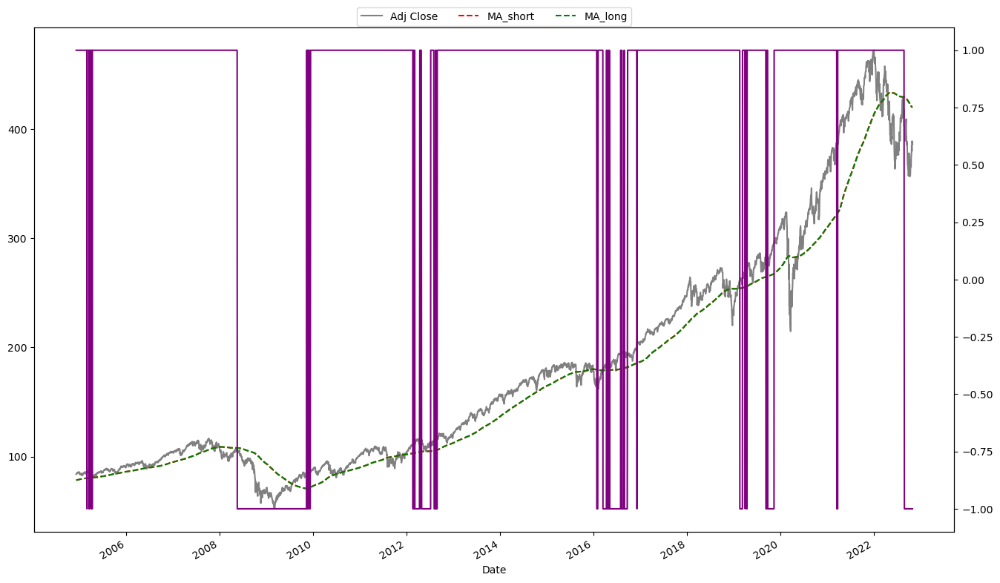

In [11]:
ax = momentum_sma_df[["Adj Close",
         "MA_short",
         "MA_long",
         "our_positions"]
       ].plot(secondary_y = "our_positions",
              figsize = (16, 10),
              style = ["grey",
                       "r--",
                       "g--",
                       "purple"]
              )

ax.legend(loc = "upper center",
          bbox_to_anchor = (0.5, 1.05),
          ncol = 3
          )

<a id="1.2"></a >
## Momentum Strategy: SMA (Reasonable) 

In [12]:
# more reasonable one
SHORT1 = 198
LONG1 = 291

In [13]:
momentum_sma_df1 = pd.DataFrame(index = spy_df.index)
momentum_sma_df1['Adj Close'] = spy_df['Adj Close']
momentum_sma_df1['MA_short1'] = MA(momentum_sma_df1, SHORT1)
momentum_sma_df1['MA_long1'] = MA(momentum_sma_df1, LONG1)

In [14]:
momentum_sma_df1['our_positions1']= np.where(momentum_sma_df1["MA_short1"] < 
                                              momentum_sma_df1['MA_long1'], -1, 1)
momentum_sma_df1.dropna(inplace = True)

In [15]:
momentum_sma_df1['RETURNS'] = np.log(momentum_sma_df1['Adj Close'] / momentum_sma_df1['Adj Close'].shift(1))
momentum_sma_df1['STRATEGY1'] = momentum_sma_df1['our_positions1'].shift(1) * momentum_sma_df1['RETURNS']

In [16]:
momentum_sma_df1['CUMULATIVE_RETURNS1'] = momentum_sma_df1['STRATEGY1'].cumsum().apply(np.exp)
momentum_sma_df1['MAX_GROSS_PERFORMANCE1'] = momentum_sma_df1['CUMULATIVE_RETURNS1'].cummax()
momentum_sma_df1

,Adj Close,MA_short1,MA_long1,our_positions1,RETURNS,STRATEGY1,CUMULATIVE_RETURNS1,MAX_GROSS_PERFORMANCE1
Date,,,,,,,,
2004-12-28,85.908005,79.375791,78.632611,1,NaN,NaN,NaN,NaN
2004-12-29,86.035637,79.413185,78.677740,1,0.001485,0.001485,1.001486,1.001486
2004-12-30,85.872597,79.449651,78.720667,1,-0.001897,-0.001897,0.999588,1.001486
2004-12-31,85.688286,79.490879,78.763508,1,-0.002149,-0.002149,0.997442,1.001486
2005-01-03,85.284180,79.535037,78.804770,1,-0.004727,-0.004727,0.992738,1.001486
...,...,...,...,...,...,...,...,...
2022-10-25,384.920013,408.287975,421.509318,-1,0.015842,-0.015842,6.260450,6.759713
2022-10-26,382.019989,407.865708,421.298362,-1,-0.007563,0.007563,6.307974,6.759713
2022-10-27,379.980011,407.465541,421.079586,-1,-0.005354,0.005354,6.341840,6.759713


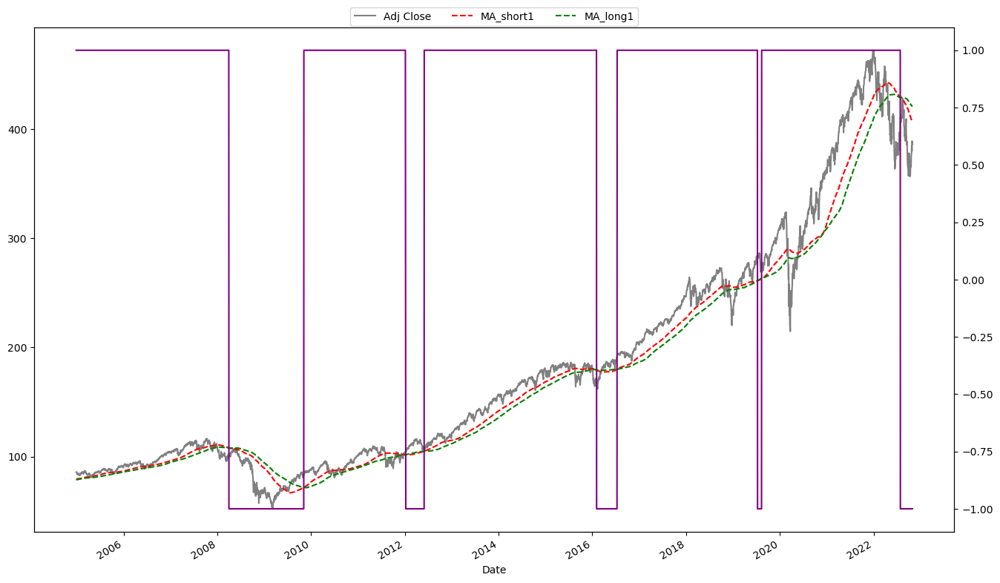

In [17]:
ax = momentum_sma_df1[["Adj Close",
         "MA_short1",
         "MA_long1",
         "our_positions1"]
       ].plot(secondary_y = "our_positions1",
              figsize = (16, 10),
              style = ["grey",
                       "r--",
                       "g--",
                       "purple"]
              )

ax.legend(loc = "upper center",
          bbox_to_anchor = (0.5, 1.05),
          ncol = 3
          )

<a id="1.3"></a >
## Momentum Strategy: EMA

In [18]:
def EMA(df, n):
    EMA = pd.Series(df['Adj Close'].ewm(span = n, 
                                   min_periods = n).mean(), 
                   name = 'EMA_' + str(n)
                   )
    
    return EMA

In [19]:
## we use the function to select the moving window for EMA momentum strategy which has the best performance on beating the market

# from itertools import product

# ema1 = range(1, 300, 1)
# ema2 = range(1, 300, 1)

# results = pd.DataFrame()
# for EMA1,EMA2 in product(ema1, ema2):
#     data = pd.DataFrame(spy_df['Adj Close'])
#     data.dropna(inplace = True)
#     data['Returns'] = np.log(data['Adj Close']/ data['Adj Close'].shift(1))
#     data['EMA1'] = data['Adj Close'].ewm(span=EMA1, min_periods = 1).mean()
#     data['EMA2'] = data['Adj Close'].ewm(span=EMA2, min_periods = 1).mean()
#     data.dropna(inplace = True)
#     data['Position'] = np.where(data['EMA1'] > data['EMA2'],1,-1)
#     data['Strategy'] = data['Position'].shift(1) * data['Returns']
#     data.dropna(inplace = True)
#     perf = np.exp(data[['Returns','Strategy']].sum())
#     results = results.append(pd.DataFrame({'EMA1':EMA1,'EMA2':EMA2,'MARKET':perf['Returns'],
#                                           'STRATEGY':perf['Strategy'], 'OUT':perf['Strategy'] - perf['Returns']},
#                                          index = [0]), ignore_index = True)

In [20]:
# results2=results[results['OUT'] > 0]
# results2.sort_values(by='OUT', ascending=False)

In [21]:
SHORT = 175
LONG = 278

In [22]:
momentum_ema_df = pd.DataFrame(index = spy_df.index)
momentum_ema_df['Adj Close'] = spy_df['Adj Close']
momentum_ema_df['EMA_short'] = EMA(momentum_ema_df, SHORT)
momentum_ema_df['EMA_long'] = EMA(momentum_ema_df, LONG)
momentum_ema_df

,Adj Close,EMA_short,EMA_long
Date,,,
2003-10-31,72.903053,NaN,NaN
2003-11-03,73.380798,NaN,NaN
2003-11-04,73.221542,NaN,NaN
2003-11-05,73.276939,NaN,NaN
2003-11-06,73.664627,NaN,NaN
...,...,...,...
2022-10-25,384.920013,399.708171,403.691267
2022-10-26,382.019989,399.507169,403.535918
2022-10-27,379.980011,399.285269,403.367058


In [23]:
momentum_ema_df['our_positions']= np.where(momentum_ema_df["EMA_short"] < 
                                              momentum_ema_df['EMA_long'], -1, 1)
momentum_ema_df.dropna(inplace = True)

In [24]:
momentum_ema_df['RETURNS'] = np.log(momentum_ema_df['Adj Close'] / momentum_ema_df['Adj Close'].shift(1))
momentum_ema_df['STRATEGY'] = momentum_ema_df['our_positions'].shift(1) * momentum_ema_df['RETURNS']
momentum_ema_df

,Adj Close,EMA_short,EMA_long,our_positions,RETURNS,STRATEGY
Date,,,,,,
2004-12-08,83.817757,79.577931,79.143772,1,NaN,NaN
2004-12-09,84.114113,79.631696,79.184932,1,0.003529,0.003529
2004-12-10,84.198769,79.685799,79.226407,1,0.001006,0.001006
2004-12-13,84.932610,79.747926,79.273556,1,0.008678,0.008678
2004-12-14,85.228951,79.812795,79.322711,1,0.003483,0.003483
...,...,...,...,...,...,...
2022-10-25,384.920013,399.708171,403.691267,-1,0.015842,-0.015842
2022-10-26,382.019989,399.507169,403.535918,-1,-0.007563,0.007563
2022-10-27,379.980011,399.285269,403.367058,-1,-0.005354,0.005354


In [25]:
momentum_ema_df['CUMULATIVE_RETURNS'] = momentum_ema_df['STRATEGY'].cumsum().apply(np.exp)
momentum_ema_df['MAX_GROSS_PERFORMANCE'] = momentum_ema_df['CUMULATIVE_RETURNS'].cummax()
momentum_ema_df['CULRETURNS']=momentum_ema_df['RETURNS'].cumsum()
momentum_ema_df

,Adj Close,EMA_short,EMA_long,our_positions,RETURNS,STRATEGY,CUMULATIVE_RETURNS,MAX_GROSS_PERFORMANCE,CULRETURNS
Date,,,,,,,,,
2004-12-08,83.817757,79.577931,79.143772,1,NaN,NaN,NaN,NaN,NaN
2004-12-09,84.114113,79.631696,79.184932,1,0.003529,0.003529,1.003536,1.003536,0.003529
2004-12-10,84.198769,79.685799,79.226407,1,0.001006,0.001006,1.004546,1.004546,0.004535
2004-12-13,84.932610,79.747926,79.273556,1,0.008678,0.008678,1.013301,1.013301,0.013213
2004-12-14,85.228951,79.812795,79.322711,1,0.003483,0.003483,1.016836,1.016836,0.016696
...,...,...,...,...,...,...,...,...,...
2022-10-25,384.920013,399.708171,403.691267,-1,0.015842,-0.015842,7.129794,7.736647,1.524391
2022-10-26,382.019989,399.507169,403.535918,-1,-0.007563,0.007563,7.183918,7.736647,1.516828
2022-10-27,379.980011,399.285269,403.367058,-1,-0.005354,0.005354,7.222486,7.736647,1.511474


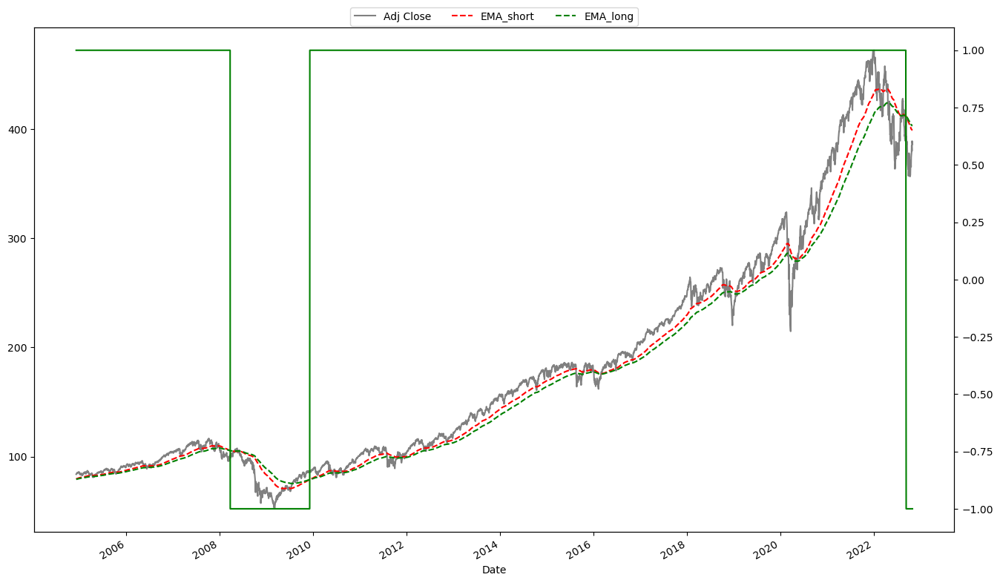

In [26]:
ax = momentum_ema_df[["Adj Close",
         "EMA_short",
         "EMA_long",
         "our_positions"]
       ].plot(secondary_y = "our_positions",
              figsize = (16, 10),
              style = ["grey",
                       "r--",
                       "g--",
                       "green"]
              )

ax.legend(loc = "upper center",
          bbox_to_anchor = (0.5, 1.05),
          ncol = 3
          )

<a id="1.4"></a >
## Momentum Strategy: MACD

In [27]:
SHORT = 12
LONG = 26
signal_period = 9

In [28]:
momentum_macd_df = pd.DataFrame(index = spy_df.index)

In [29]:
momentum_macd_df['Adj Close'] = spy_df['Adj Close']
momentum_macd_df['EMA_short'] = spy_df[['Adj Close']].ewm(span = SHORT, adjust = False).mean()
momentum_macd_df['EMA_long'] = spy_df[['Adj Close']].ewm(span = LONG, adjust = False).mean()
momentum_macd_df['MACD'] = momentum_macd_df['EMA_short'] - momentum_macd_df['EMA_long']
momentum_macd_df['MACD_Signal'] = momentum_macd_df[['MACD']].ewm(span = signal_period).mean()
momentum_macd_df['MACD_hist'] = momentum_macd_df['MACD'] - momentum_macd_df['MACD_Signal']
momentum_macd_df['Position'] = momentum_macd_df['MACD_hist'].apply(lambda x: 1 if x > 0 else 0)
momentum_macd_df['buy_sell'] = momentum_macd_df['Position'].diff()

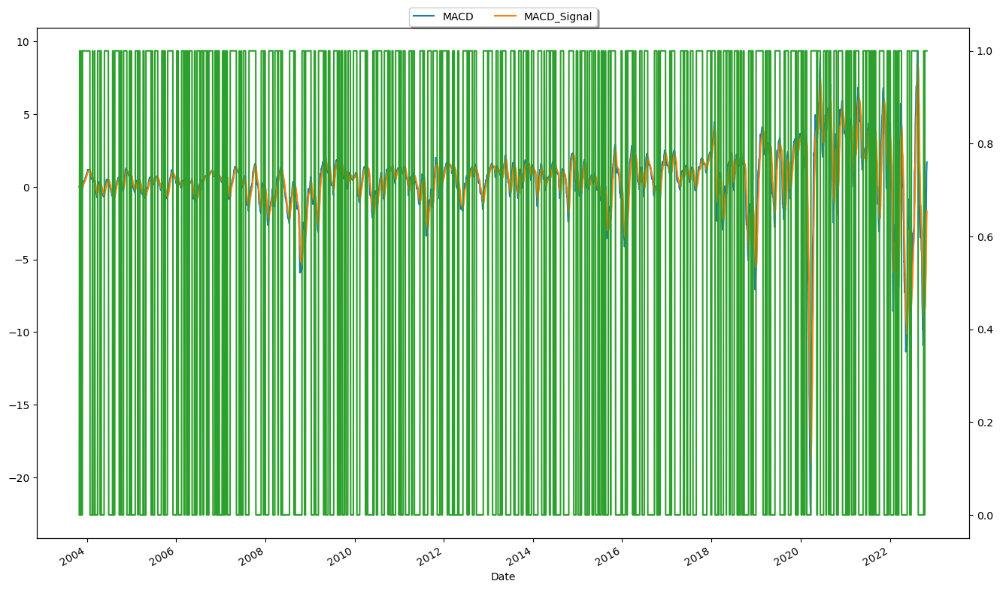

In [30]:
ax = momentum_macd_df[['MACD', 
           'MACD_Signal', 
           'Position']].plot(figsize = (16, 10), 
                            secondary_y = 'Position')

ax.legend(loc = 'upper center', 
         bbox_to_anchor = (0.5, 1.05), 
         ncol = 3, shadow = True)

In [31]:
momentum_macd_df['RETURNS'] = np.log(momentum_macd_df['Adj Close'] / momentum_macd_df['Adj Close'].shift(1))
momentum_macd_df['STRATEGY'] = momentum_macd_df['Position'].shift(1) * momentum_macd_df['RETURNS']

momentum_macd_df['CUMULATIVE_RETURNS'] = momentum_macd_df['STRATEGY'].cumsum().apply(np.exp)
momentum_macd_df['MAX_GROSS_PERFORMANCE'] = momentum_macd_df['CUMULATIVE_RETURNS'].cummax()

<a id="1.5"></a >
## Momentum Strategy: RSI

In [32]:
def RSIPlot(RSIdf,Overbought,Oversold,Closing):
    
    RSIdf[["Holding Returns", "Strategy Cumulative Returns"]].dropna().plot(figsize=(16,8)) 
    plt.ylabel("Cumulative Returns") 
    plt.title("RSI Strategy vs Holding Returns")
    
    plt.figure(figsize=(15,6))
    plt.plot(RSIdf.index, RSIdf['RSI'],color='black', alpha = 0.3)
    plt.axhline(Overbought ,color = 'red')
    plt.axhline(Oversold ,color='green')
    plt.axhline(Closing , linestyle = "dotted", color = 'black')
    plt.scatter(RSIdf[RSIdf['Signal'] == 1].index , RSIdf[RSIdf['Signal'] == 1]["RSI"],marker = '^', color = 'green', label = 'Long Signal')
    plt.scatter(RSIdf[RSIdf['Signal'] == -1].index , RSIdf[RSIdf['Signal'] == -1]["RSI"],marker = 'v', color = 'red', label = 'Short Signal')
    plt.title('RSI')
    plt.legend(loc='upper left')
    plt.show()

    plt.figure(figsize=(15,6))
    plt.plot(RSIdf.index, RSIdf['RSI'],label='RSI',color='black', alpha = 0.3)
    plt.axhline(Overbought ,color = 'red')
    plt.axhline(Oversold ,color='green')
    plt.axhline(Closing ,linestyle = "dotted", color = 'black')
    plt.scatter(RSIdf[RSIdf['Execution'] == 1].index , RSIdf[RSIdf['Execution'] == 1]["RSI"],marker = '*', color = 'Purple', label = 'Execution')
    plt.scatter(RSIdf[RSIdf['Closing'] == 1].index , RSIdf[RSIdf['Closing'] == 1]["RSI"],marker = 'D', color = 'Orange', label = 'Closing')
    plt.title('RSI')
    plt.legend(loc='upper left')
    plt.show()

<a id="1.6"></a >
## Mean-Reversion: SMA

In [33]:
from itertools import product

sma1 = range(1, 300, 1)

results = pd.DataFrame()
for SMA1 in sma1:
    data = pd.DataFrame(spy_df['Adj Close'])
    data.dropna(inplace = True)
    data['Returns'] = np.log(data['Adj Close']/ data['Adj Close'].shift(1))
    data['SMA1'] = data['Adj Close'].rolling(window = SMA1).mean()
    data['upper_threhold'] = 2 * data['Adj Close'].rolling(window = SMA1).std()
    data['lower_threhold'] = - 2 * data['Adj Close'].rolling(window = SMA1).std()
    data['DIST'] = data['Adj Close'] - data['SMA1']
    data['Position'] = np.where(data['DIST'] > data['upper_threhold'],-1,np.nan)
    data['Position'] = np.where(data['DIST'] < data['lower_threhold'], 1, data['Position'])
    data['Strategy'] = data['Position'].shift(1) * data['Returns']
    data.dropna(inplace = True)
    perf = np.exp(data[['Returns','Strategy']].sum())
    results = results.append(pd.DataFrame({'SMA1':SMA1,'MARKET':perf['Returns'],
                                          'STRATEGY':perf['Strategy'], 'OUT':perf['Strategy'] - perf['Returns']},
                                         index = [0]), ignore_index = True)

In [34]:
results[results['OUT'] > 0] # no 

,SMA1,MARKET,STRATEGY,OUT


In [35]:
mean_sma_df = pd.DataFrame()
mean_sma_df['Adj Close'] = spy_df["Adj Close"]
mean_sma_df['RETURNS'] = np.log(spy_df['Adj Close'] / spy_df['Adj Close'].shift(1))
mean_sma_df["SMA_40"] = spy_df["Adj Close"].rolling(window = 40).mean()

mean_sma_df["Upper_Threhold"] = 2 * spy_df['Adj Close'].rolling(window = 40).std()
mean_sma_df["Lower_Threhold"] = -2 * spy_df['Adj Close'].rolling(window = 40).std()

T = 10

mean_sma_df["DIST"] = mean_sma_df['Adj Close'] - mean_sma_df["SMA_40"]

In [36]:
mean_sma_df["Position"] = np.where(mean_sma_df["DIST"] > mean_sma_df['Upper_Threhold'], -1, np.nan)
mean_sma_df["Position"] = np.where(mean_sma_df["DIST"] < mean_sma_df['Lower_Threhold'], 1, mean_sma_df["Position"])

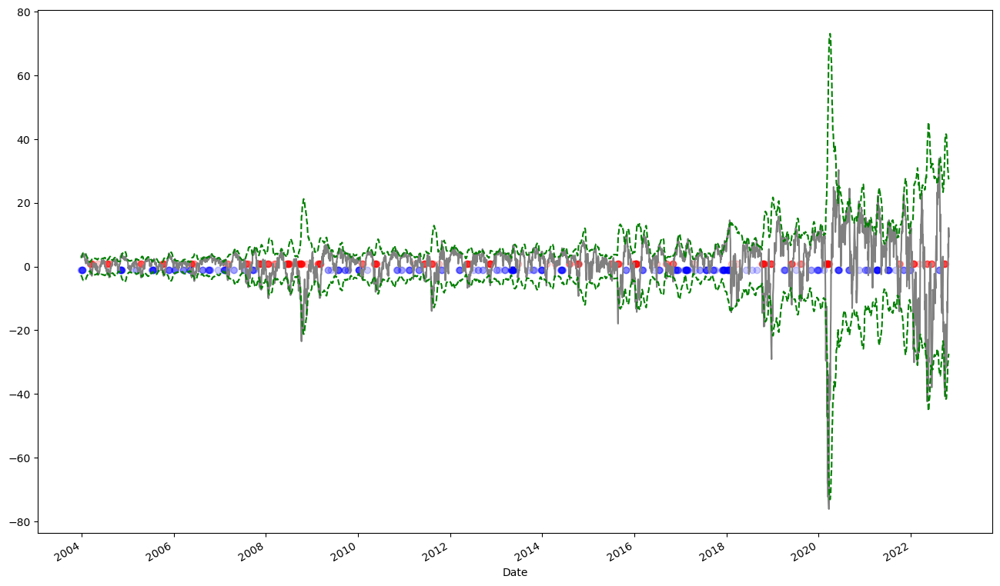

In [37]:
mean_sma_df["DIST"].dropna().plot(figsize = (16, 10), color = 'grey')

# plt.axhline(T, color = 'green', ls = "--")
# plt.axhline(0, color = 'green', ls = '--')
# plt.axhline(-T, color = 'green', ls = '--')

mean_sma_df["Upper_Threhold"].dropna().plot(style = '--',
                                color = 'green'
                                )
mean_sma_df["Lower_Threhold"].dropna().plot(style = '--',
                                color = 'green'
                                )

plt.scatter(x = mean_sma_df.Position[mean_sma_df.Position == 1].index, 
           y = mean_sma_df.Position[mean_sma_df.Position == 1], color = 'red', 
           alpha = 0.2)

plt.scatter(x = mean_sma_df.Position[mean_sma_df.Position == -1].index, 
           y = mean_sma_df.Position[mean_sma_df.Position == -1], color = 'blue', 
           alpha = 0.2)

In [38]:
mean_sma_df['Position'] = np.where(mean_sma_df["DIST"]* mean_sma_df["DIST"].shift(1) < 0, # price crossover SMA
                              0, mean_sma_df["Position"])
mean_sma_df['Position'] = mean_sma_df["Position"].ffill().fillna(0) 

In [39]:
mean_sma_df['RETURNS'] = np.log(spy_df['Adj Close'] / spy_df['Adj Close'].shift(1))
mean_sma_df["STRATEGY"] = mean_sma_df['Position'].shift(1) * mean_sma_df["RETURNS"]

mean_sma_df['CUMULATIVE_RETURNS'] = mean_sma_df['STRATEGY'].cumsum().apply(np.exp)
mean_sma_df['MAX_GROSS_PERFORMANCE'] = mean_sma_df['CUMULATIVE_RETURNS'].cummax()

<a id="1.7"></a >
## Mean-Reversion: EMA

In [40]:
from itertools import product

ema1 = range(1, 300, 1)

results = pd.DataFrame()
for EMA1 in ema1:
    data = pd.DataFrame(spy_df['Adj Close'])
    data.dropna(inplace = True)
    data['Returns'] = np.log(data['Adj Close']/ data['Adj Close'].shift(1))
    data['EMA1'] = data['Adj Close'].ewm(span = EMA1, min_periods = EMA1).mean()
    data['upper_threhold'] = 2 * data['Adj Close'].ewm(span = EMA1, min_periods = EMA1).std()
    data['lower_threhold'] = - 2 * data['Adj Close'].ewm(span = EMA1, min_periods = EMA1).std()
    data['DIST'] = data['Adj Close'] - data['EMA1']
    data['Position'] = np.where(data['DIST'] > data['upper_threhold'],-1,np.nan)
    data['Position'] = np.where(data['DIST'] < data['lower_threhold'], 1, data['Position'])
    data['Strategy'] = data['Position'].shift(1) * data['Returns']
    data.dropna(inplace = True)
    perf = np.exp(data[['Returns','Strategy']].sum())
    results = results.append(pd.DataFrame({'EMA1':EMA1,'MARKET':perf['Returns'],
                                          'STRATEGY':perf['Strategy'], 'OUT':perf['Strategy'] - perf['Returns']},
                                         index = [0]), ignore_index = True)

In [41]:
results[results['OUT'] > 0] # not beat the market for mean reversion strategy with EMA

,EMA1,MARKET,STRATEGY,OUT


In [42]:
mean_ema_df = pd.DataFrame()
mean_ema_df['Adj Close'] = spy_df["Adj Close"]
mean_ema_df['RETURNS'] = np.log(spy_df['Adj Close'] / spy_df['Adj Close'].shift(1))
mean_ema_df["EMA_40"] = spy_df["Adj Close"].ewm(span = 40, min_periods = 40).mean()

mean_ema_df["Upper_Threhold"] = 2 * spy_df['Adj Close'].ewm(span = 40, min_periods = 40).std()
mean_ema_df["Lower_Threhold"] = -2 * spy_df['Adj Close'].ewm(span = 40, min_periods = 40).std()

T = 20
mean_ema_df["DIST"] = mean_ema_df['Adj Close'] - mean_ema_df["EMA_40"]

In [43]:
mean_ema_df["Position"] = np.where(mean_ema_df["DIST"] > mean_ema_df['Upper_Threhold'], -1, np.nan)
mean_ema_df["Position"] = np.where(mean_ema_df["DIST"] < mean_ema_df['Lower_Threhold'], 1, mean_ema_df["Position"])

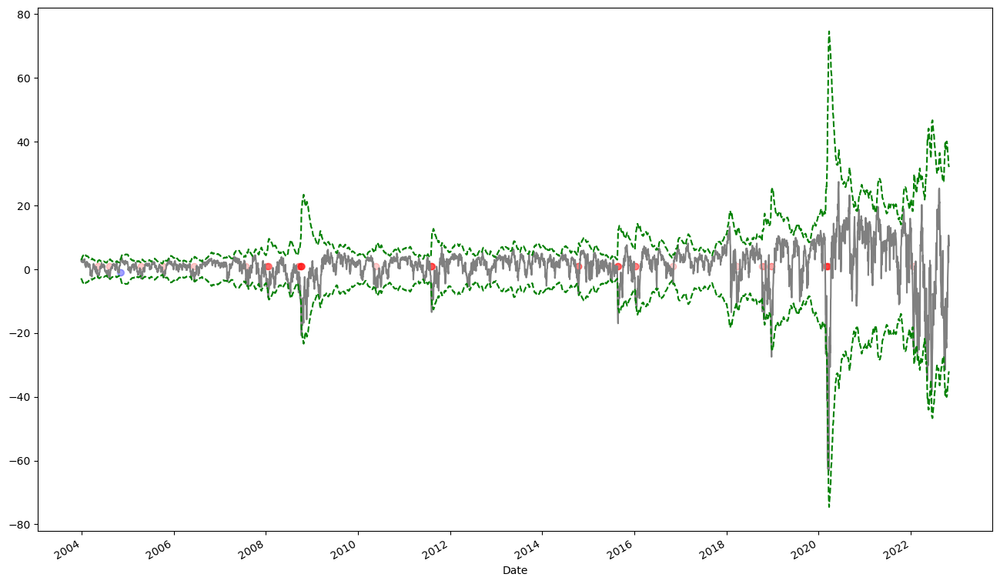

In [44]:
mean_ema_df["DIST"].dropna().plot(figsize = (16, 10), color = 'grey')

# plt.axhline(T, color = 'green', ls = "--")
# plt.axhline(0, color = 'green', ls = '--')
# plt.axhline(-T, color = 'green', ls = '--')

mean_ema_df["Upper_Threhold"].dropna().plot(style = '--',
                                color = 'green'
                                )
mean_ema_df["Lower_Threhold"].dropna().plot(style = '--',
                                color = 'green'
                                )

plt.scatter(x = mean_ema_df.Position[mean_ema_df.Position == 1].index, 
           y = mean_ema_df.Position[mean_ema_df.Position == 1], color = 'red', 
           alpha = 0.2)

plt.scatter(x = mean_ema_df.Position[mean_ema_df.Position == -1].index, 
           y = mean_ema_df.Position[mean_ema_df.Position == -1], color = 'blue', 
           alpha = 0.2)

In [45]:
mean_ema_df['Position'] = np.where(mean_ema_df["DIST"]* mean_ema_df["DIST"].shift(1) < 0, # price crossover SMA
                              0, mean_ema_df["Position"])
mean_ema_df['Position'] = mean_ema_df["Position"].ffill().fillna(0) 

In [46]:
mean_ema_df['RETURNS'] = np.log(spy_df['Adj Close'] / spy_df['Adj Close'].shift(1))
mean_ema_df["STRATEGY"] = mean_ema_df['Position'].shift(1) * mean_ema_df["RETURNS"]

mean_ema_df['CUMULATIVE_RETURNS'] = mean_ema_df['STRATEGY'].cumsum().apply(np.exp)
mean_ema_df['MAX_GROSS_PERFORMANCE'] = mean_ema_df['CUMULATIVE_RETURNS'].cummax()

<a id="1.8"></a >
## MACD & RSI 

In [47]:
def Plotter(df):
    fig = plt.figure()  
    fig.set_size_inches((20, 16))
    ax_stock = fig.add_axes((0, 0.72, 1, 0.32))
    ax_macd = fig.add_axes((0, 0.48, 1, 0.2), sharex=ax_stock)
    ax_rsi = fig.add_axes((0, 0.24, 1, 0.2), sharex=ax_stock)

    ax_stock.plot(df.index, df["Strategy Cumulative Returns"],label = "Strategy Returns")
    ax_stock.plot(df.index, df["Hodling Returns"],label = "Holding Returns")
    ax_stock.twinx().plot(df.index, df["Position"],color = 'g', label = 'Positions')
    ax_stock.set_title('Strategy vs Hodling Returns')
    ax_stock.legend()

    ax_macd.plot(df.index, df["MACD"], label="MACD")
    ax_macd.bar(df.index, df["MACD_H"] * 3, label="hist")
    ax_macd.plot(df.index, df["MACD_S"], label="signal")
    ax_macd.scatter(df[df['Signal'] == -1].index , df[df['Signal'] == -1]["MACD_H"],marker = 'v', color = 'red', label = 'Bearish Signal')
    ax_macd.scatter(df[df['Signal'] == 1].index , df[df['Signal'] == 1]["MACD_H"],marker = '^', color = 'green', label = 'Bullish Signal')
    ax_macd.set_title('MACD')
    ax_macd.legend()

    ax_rsi.plot(df.index, df['RSI'],color='red', alpha = 0.3)
    ax_rsi.axhline(50 , linestyle = "dotted", color = 'black')
    ax_rsi.scatter(df[df['Signal'] == -1].index , df[df['Signal'] == -1]["RSI"],marker = 'v', color = 'red', label = 'Bearish Signal')
    ax_rsi.scatter(df[df['Signal'] == 1].index , df[df['Signal'] == 1]["RSI"],marker = '^', color = 'green', label = 'Bullish Signal')
    ax_rsi.set_title('RSI')
    ax_rsi.legend()

    plt.show()

In [48]:
def TAPlotter(df):
    fig = make_subplots(rows = 3,
                        cols = 1)

    fig.append_trace(
        go.Scatter(
           x = df.index,
           y = df["Open"],
           line = dict(color = "blue", width = 1),
           name = "open",
           legendgroup = "1"), 
        row = 1, col = 1)

    # For Candlestick
    fig.append_trace(
        go.Candlestick(
            x = df.index,
            open = df["Open"],
            high = df["High"],
            low = df["Low"],
            close = df["Close"],
            increasing_line_color = "green",
            decreasing_line_color = "red",
            showlegend = False), 
        row = 1, col = 1)

    # MACD 
    fig.append_trace(
        go.Scatter(
            x = df.index,
            y = df["MACD"],
            line = dict(color = "blue", width = 1.5),
            name = "macd",
            legendgroup = "2"),
        row = 2, col = 1)

    # MACD Signal
    fig.append_trace(
        go.Scatter(
            x = df.index,
            y = df["MACD_S"],
            line = dict(color = "black", width = 1.5),
            name = "signal",
            legendgroup = "2"),
        row = 2, col = 1)

    colors = np.where(df["MACD_H"] < 0,
                      "black", "blue")
    # MACD Hist
    fig.append_trace(
        go.Bar(
            x = df.index,
            y = df["MACD_H"],
            name = "hist",
            marker_color = colors), 
        row = 2, col = 1)
    
    # RSI
    fig.append_trace(
        go.Scatter(
            x = df.index,
            y = df["RSI"],
            line = dict(color = "grey", width = 1),
            name = "RSI",
            legendgroup = "3"), 
        row = 3, col = 1)
    
    fig.add_hline(50, row = 3, col =1, fillcolor = 'red')

    layout = go.Layout(
        plot_bgcolor = "antiquewhite",
        font_color = "black",
        font_size = 10,
        font_family = "Courier",
        xaxis = dict(rangeslider = dict(visible = False)
                    )
                      )

    fig.update_layout(layout)
    plt.figure(figsize = (16,16)
          )
    fig.show()

<a id="1.9"></a >
## Machine Learning 

In [152]:
start=dt.datetime(2003,11,1)
end=dt.datetime(2022,10,31)

sp500=pdr.DataReader('SPY','yahoo',start=start,end=end)

<AxesSubplot:xlabel='Date'>

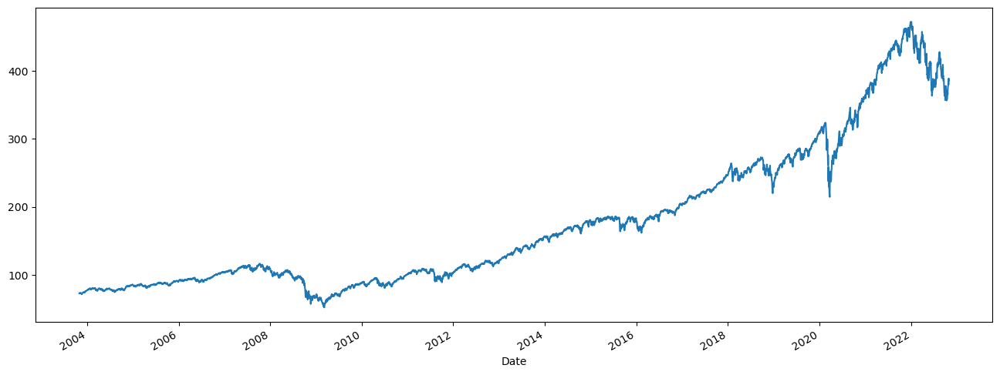

In [153]:
sp500['Adj Close'].plot(figsize=(16,6))

By implementing the Machine Learning, we expect that the X can predict the signal of returns for the next day. If the predicts show signal 1, we are supposed to buy and hold. If the predicts show signal -1, we are supposed to short SP500. If the machine can create accurate predicts and we are confident of our strategy (which may not be true actually), we are supposed to put all of our money into the market and generate high accumulative returns. So we will not reserve any money when implement the trading strategy. 

### Data Transformation 

we import the data of SP500 from 2003 to 2022, and check if the data has missing value. 

In [154]:
data=sp500.copy()

In [155]:
data

,High,Low,Open,Close,Volume,Adj Close
Date,,,,,,
2003-10-31,105.739998,105.220001,105.400002,105.300003,25761600.0,72.903107
2003-11-03,106.610001,105.709999,105.750000,105.989998,37589300.0,73.380783
2003-11-04,106.269997,105.580002,105.989998,105.760002,31421600.0,73.221558
2003-11-05,105.970001,104.900002,105.489998,105.839996,33558800.0,73.276924
2003-11-06,106.440002,105.099998,105.599998,106.400002,28392300.0,73.664688
...,...,...,...,...,...,...
2022-10-25,385.250000,378.670013,378.790009,384.920013,78846300.0,384.920013
2022-10-26,387.579987,381.350006,381.619995,382.019989,104087300.0,382.019989
2022-10-27,385.000000,379.329987,383.070007,379.980011,81971800.0,379.980011


For X variable, we select both the potentially correlated asset and technical indicators. Potential correlated asset include stocks (MSFT, IBM and AAPL), currency (USD/JPY and GBP/USD) and indices (S&P 500, Dow Jones, and VIX). Technical indicators includes moving average (SMA and EMA), relative strength index (RSI), stochastic oscillator (%K & %D), momentum, and rate of Change (RoC). In addition to that, some lag returns are included in the data set. After importing the data we need above, we check the missing values firstly, and use the ffill() method to deal with the missing value. Then we calculate the indicators we need.
Then we combine the X and Y(shift(-1)), drop the missing value

#### lags

we calculate the daily returns of SP500 and the lags.

In [157]:
data['returns']=np.log(data['Adj Close']/data['Adj Close'].shift(1))

data['returns_lag1']=data['returns'].shift(1)

data['returns_lag5']=data['returns'].shift(5)

data['returns_lag10']=data['returns'].shift(10)

#### technical indicators

In [159]:
def MA(df, n):
    MA = pd.Series(df["Adj Close"].rolling(n, min_periods=n).mean(), name="MA_" + str(n))
    return MA

def EMA(df, n):
    EMA = pd.Series(df["Adj Close"].ewm(span = n,
                                    min_periods = n).mean(),
                    name = "EMA_" + str(n)
                    )
    return EMA

def ROC(df, n):
    M = df.diff(n - 1)
    N = df.shift(n - 1)
    ROC = pd.Series((M / N) * 100, 
                    name = "ROC_" + str(n)    
                    )
    return ROC

def MOM(df, n):
    MOM = pd.Series(df.diff(n),
                    name = "MOM_" + str(n)
                   )
    return MOM

def RSI(series, period):
    
    delta = series.diff().dropna()
    
    u = delta * 0
    d = u.copy()
    
    u[delta > 0] = delta[delta > 0]
    d[delta < 0] = -delta[delta < 0]
    
    u[u.index[period - 1]] = np.mean( u[:period] ) # 
    
    u = u.drop(u.index[:(period - 1)
                      ]
              )
    
    d[d.index[period - 1]] = np.mean( d[:period] )
    
    d = d.drop(d.index[:(period - 1)
                      ]
              )
    
    rs = u.ewm(com = period - 1, adjust = False).mean() / \
         d.ewm(com = period - 1, adjust = False).mean()
    
    return 100 - 100 / (1 + rs)

def STOK(close, low, high, n):
    STOK = ((close - low.rolling(n).min()) / \
            (high.rolling(n).max() - low.rolling(n).min()
            )
           ) * 100
    return STOK

def STOD(close, low, high, n):
    STOK = ((close - low.rolling(n).min()) / \
            (high.rolling(n).max() - low.rolling(n).min()
            )
           ) * 100
    
    STOD = STOK.rolling(3).mean()
    return STOD

In [160]:
data['MA10']=MA(data,10)
data['MA30']=MA(data,30)
#data['MA200']=MA(data,200)

data["EMA10"] = EMA(data, 10)
data["EMA30"] = EMA(data, 30)
#data["EMA200"] = EMA(data, 200)

data["ROC5"] = ROC(data["Adj Close"], 5)
data["ROC10"] = ROC(data["Adj Close"], 10)

data["MOM5"] = MOM(data["Adj Close"], 5)
data["MOM10"] = MOM(data["Adj Close"], 10)

data["RSI10"] = RSI(data["Adj Close"], 10)
data["RSI30"] = RSI(data["Adj Close"], 30)
data["RSI200"] = RSI(data["Adj Close"], 200)

data["%K10"] = STOK(data["Adj Close"], data["Low"], data["High"], 10)
data["%D10"] = STOD(data["Adj Close"], data["Low"], data["High"], 10)

data["%K30"] = STOK(data["Adj Close"], data["Low"], data["High"], 30)
data["%D30"] = STOD(data["Adj Close"], data["Low"], data["High"], 30)

#data["%K200"] = STOK(data["Adj Close"], data["Low"], data["High"], 200)
#data["%D200"] = STOD(data["Adj Close"], data["Low"], data["High"], 200)

#### Relative Asset

In [161]:
currency_ticker = ["DEXJPUS", "DEXUSUK"]
index_ticker = ['^DJI','^VIX']
common_ticker = ['XGD.TO']
stock_ticker = ['MSFT','IBM','AAPL']

stock_data=pdr.DataReader(stock_ticker,'yahoo',start=start,end=end)['Adj Close']
index_data=pdr.DataReader(index_ticker,'yahoo',start=start,end=end)['Adj Close']
common_data=pdr.DataReader(common_ticker,'yahoo',start=start,end=end)['Adj Close']
currency_data=pdr.DataReader(currency_ticker,'fred',start=start,end=end)

In [162]:
index_data.columns=['DJ','VIX']

In [163]:
currency_data.ffill(inplace=True)

In [164]:
stock_data['MSFT_returns']=stock_data['MSFT'].pct_change()
stock_data['IBM_returns']=stock_data['IBM'].pct_change()
stock_data['AAPL_returns']=stock_data['AAPL'].pct_change()

In [165]:
stock_data['MSFT_returns_lag1']=stock_data['MSFT_returns'].shift(1)
stock_data['IBM_returns_lag1']=stock_data['IBM_returns'].shift(1)
stock_data['AAPL_returns_lag1']=stock_data['AAPL_returns'].shift(1)

stock_data['MSFT_returns_lag5']=stock_data['MSFT_returns'].shift(5)
stock_data['IBM_returns_lag5']=stock_data['IBM_returns'].shift(5)
stock_data['AAPL_returns_lag5']=stock_data['AAPL_returns'].shift(5)

stock_data['MSFT_returns_lag10']=stock_data['MSFT_returns'].shift(10)
stock_data['IBM_returns_lag10']=stock_data['IBM_returns'].shift(10)
stock_data['AAPL_returns_lag10']=stock_data['AAPL_returns'].shift(10)

In [166]:
index_data['DJ_returns']=index_data['DJ'].pct_change()
index_data['VIX_returns']=index_data['VIX'].pct_change()
common_data['XGD.TO_returns']=common_data['XGD.TO'].pct_change()

In [167]:
index_data['DJ_returns_lag1']=index_data['DJ_returns'].shift(1)
index_data['VIX_returns_lag1']=index_data['VIX_returns'].shift(1)
common_data['XGD.TO_returns_lag1']=common_data['XGD.TO_returns'].shift(1)

index_data['DJ_returns_lag5']=index_data['DJ_returns'].shift(5)
index_data['VIX_returns_lag5']=index_data['VIX_returns'].shift(5)
common_data['XGD.TO_returns_lag5']=common_data['XGD.TO_returns'].shift(5)

index_data['DJ_returns_lag10']=index_data['DJ_returns'].shift(10)
index_data['VIX_returns_lag10']=index_data['VIX_returns'].shift(10)
common_data['XGD.TO_returns_lag10']=common_data['XGD.TO_returns'].shift(10)

In [168]:
data=pd.concat([data, index_data, currency_data, stock_data, common_data],axis=1)

In [169]:
data.drop(columns=['High','Low','Open','Close','Adj Close'],inplace=True)

If the return is greater than 0, we give the sign of 1 (the long position). If the return is under than 0, we give the sign of -1(the short position). We use the data of signals as our Y variable. Here we need to use shift(-1)

In [170]:
data['signal']=np.where(data['returns']>0,1,-1)
data['signal']=data['signal'].shift(-1)

In [171]:
data.dropna(inplace=True)

#### Our Data

In [172]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4485 entries, 2004-08-19 to 2022-10-28
Data columns (total 53 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Volume                4485 non-null   float64
 1   returns               4485 non-null   float64
 2   returns_lag1          4485 non-null   float64
 3   returns_lag5          4485 non-null   float64
 4   returns_lag10         4485 non-null   float64
 5   MA10                  4485 non-null   float64
 6   MA30                  4485 non-null   float64
 7   EMA10                 4485 non-null   float64
 8   EMA30                 4485 non-null   float64
 9   ROC5                  4485 non-null   float64
 10  ROC10                 4485 non-null   float64
 11  MOM5                  4485 non-null   float64
 12  MOM10                 4485 non-null   float64
 13  RSI10                 4485 non-null   float64
 14  RSI30                 4485 non-null   float64
 15  RSI

### EDA

In [173]:
Y = data["signal"]
X = data.loc[:, data.columns != "signal"]

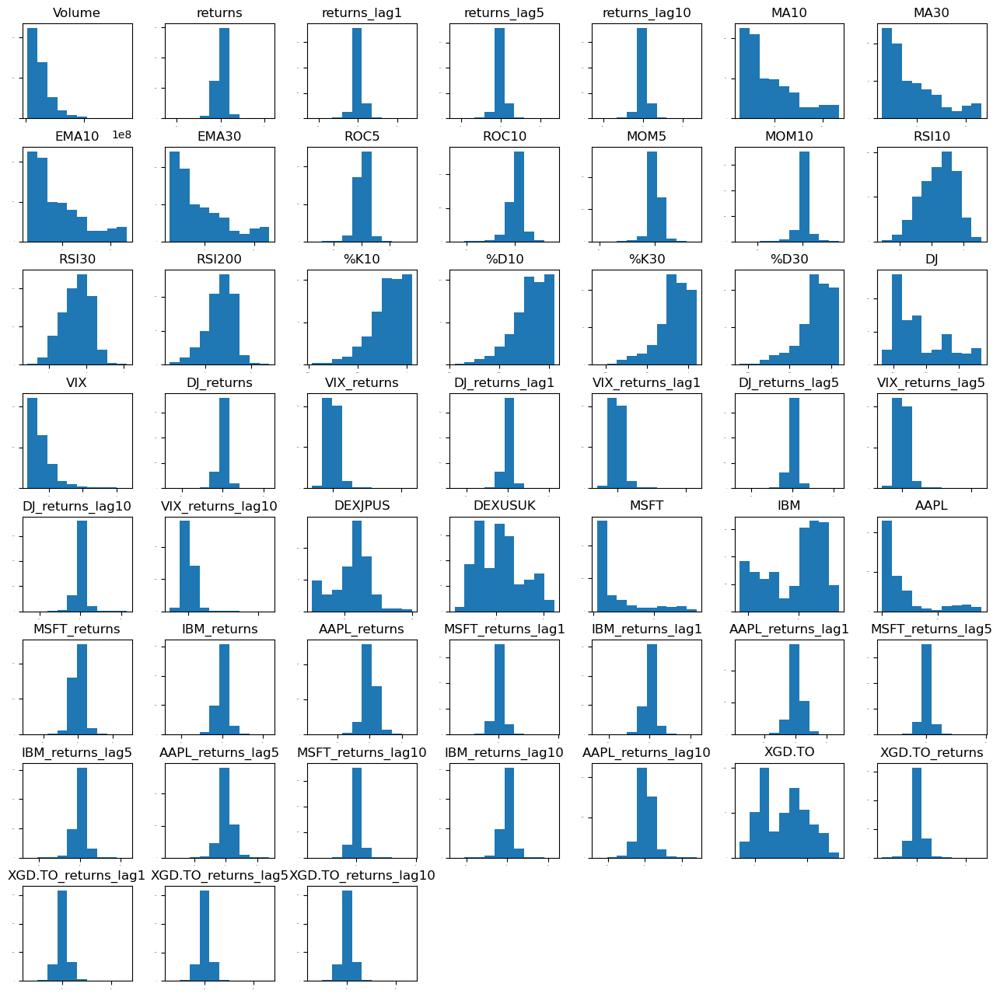

In [174]:
X.hist(sharex = False,
       sharey = False,
       xlabelsize = 1,
       ylabelsize = 1,
       figsize = (16, 16),
       grid=False
          
       
            )
plt.show()

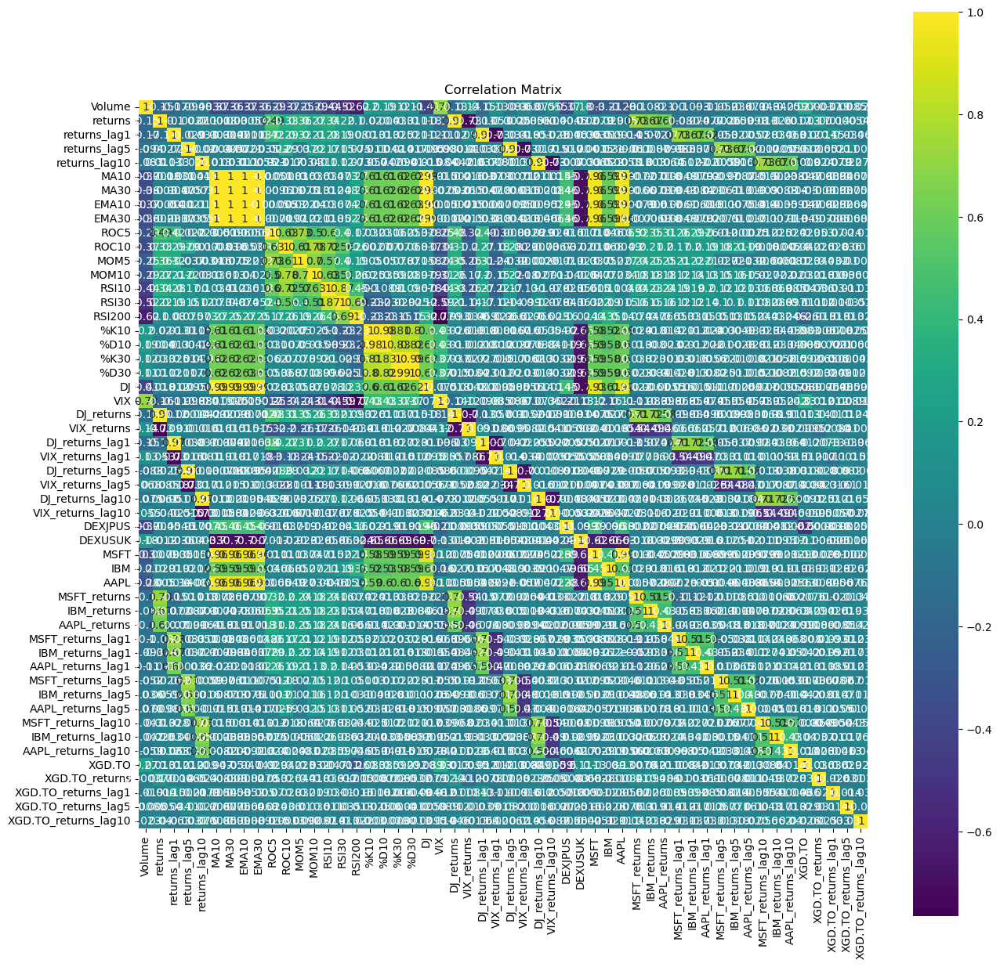

In [175]:
correlation = X.corr()

plt.figure(figsize=(15,15))
plt.title("Correlation Matrix")

sns.heatmap(correlation, 
            vmax = 1, 
            square = True,
            annot = True,
            cmap = "viridis")

plt.show()

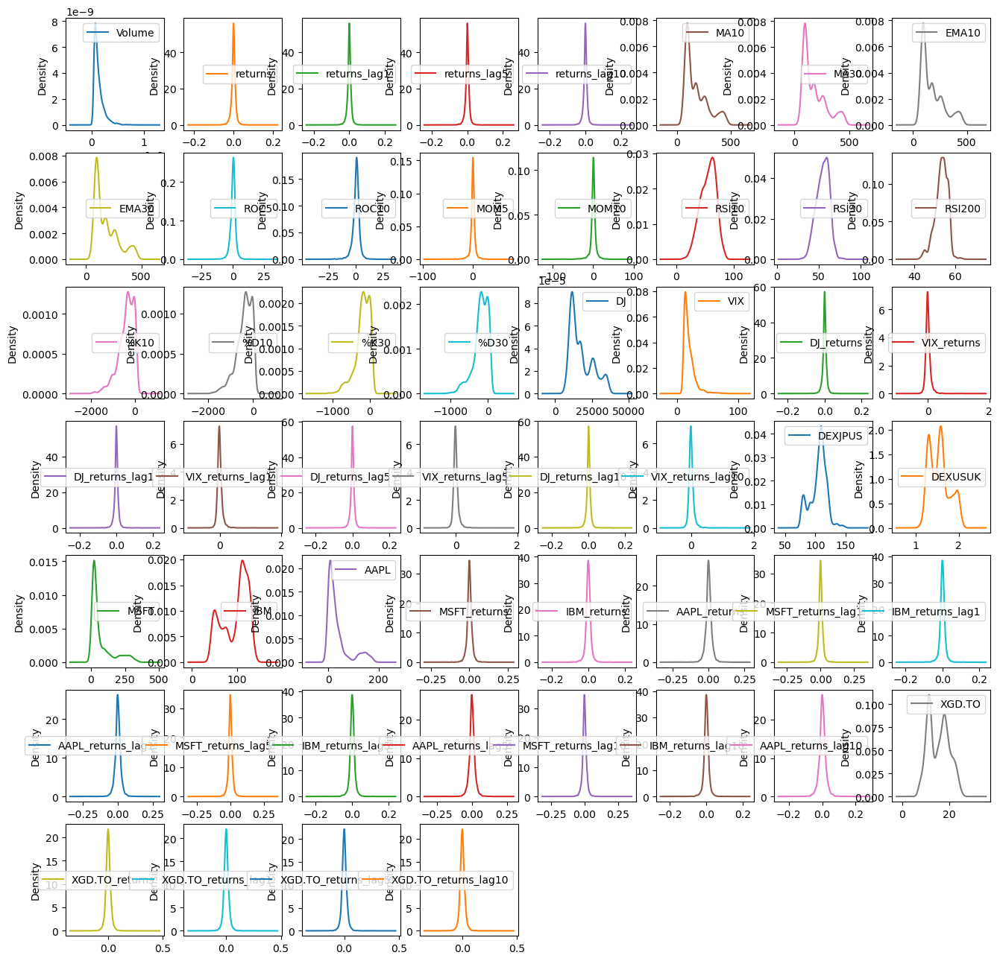

In [176]:
X.plot(kind = "density",
          subplots = True,
          layout = (7,8),
          sharex = False,
          legend = True,
          figsize = (16, 16)
         )
plt.show()

### PCA

We have 51 one indicators, and some of them are correlated. So we are supposed to implement the Principle Components Analysis and simplify the following calculations. From figure 4, we notice that 20 components almost explained 88% of the variance. So we are supposed to use the 20 components to substitute the original indicators.

Actually,I think PCA here is not needed. Because we only have 51 indicators, the computer can slove them quite easily. But when we have thounsands indicators, the PCA is needed. Here we just want to try the procedure.

In [178]:
validation_size = 0.2

train_size = int(len(X) * (1 - validation_size))

In [179]:
scaler = StandardScaler().fit(X)

X_rescale = pd.DataFrame(scaler.fit_transform(X),columns = X.columns, index = X.index)

In [180]:
from matplotlib.ticker import MaxNLocator

Variance preserved by first 12 components == 88.14%


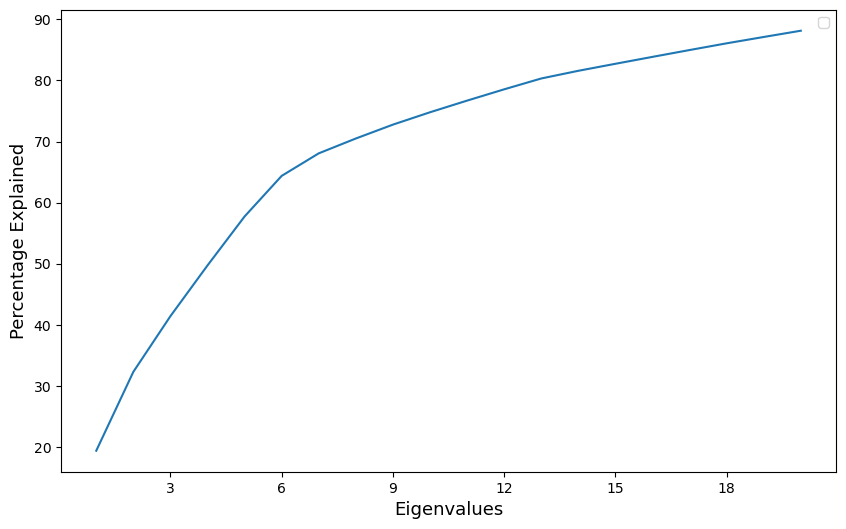

In [185]:
ncomps = 20

svd = TruncatedSVD(n_components=ncomps)

svd_fit = svd.fit(X_rescale)

plt_data = pd.DataFrame(svd_fit.explained_variance_ratio_.cumsum()*100)

plt_data.index = np.arange(1, len(plt_data) + 1)

Y_pred = svd.fit_transform(X_rescale)

ax = plt_data.plot(kind="line", figsize=(10,6)
                  )
ax.xaxis.set_major_locator(MaxNLocator(integer = True)
                          )

ax.set_xlabel("Eigenvalues", fontsize=13)
ax.set_ylabel("Percentage Explained",fontsize=13)
ax.legend("")

print("Variance preserved by first 12 components == {:.2%}".format(svd_fit.explained_variance_ratio_.cumsum()[-1]
                                                                 )
     )

In [186]:
X_rescale = pd.DataFrame(Y_pred, columns=["c{}".format(c) for c in range(ncomps)], 
                     index = X_rescale.index)
print(X_rescale.shape)
X_rescale.head()

(4485, 20)


,c0,c1,c2,c3,c4,c5,c6,c7,c8,c9,c10,c11,c12,c13,c14,c15,c16,c17,c18,c19
2004-08-19,-3.819819,-0.260158,2.477415,0.650822,-3.639060,-2.105709,0.826296,-0.882486,0.905719,-0.141466,-1.718868,0.433241,-0.971691,-0.744712,-0.466659,0.884501,0.075780,0.709414,0.523259,-0.052163
2004-08-20,-3.663665,-1.103056,-2.547628,-1.485001,-2.241166,-1.387144,0.963462,-1.149256,1.160089,0.402292,0.800012,0.607387,-1.933010,-1.110099,0.643941,0.035203,-0.167872,-0.948626,-0.525134,-1.147658
2004-08-23,-3.649713,-1.354195,0.789883,-0.946270,0.445218,-0.645804,1.430663,-0.692825,1.291108,0.914378,0.684587,0.001919,0.127959,-0.136605,0.047543,-0.978180,0.126720,0.211225,-0.071467,-0.373388
2004-08-24,-3.605588,-1.442255,-0.035256,0.709181,2.722362,-0.404455,1.236291,-0.503739,1.418285,0.184668,-0.241775,-0.614541,1.148623,0.499652,0.208267,-0.710781,0.601439,0.491344,0.380762,0.230323
2004-08-25,-3.454534,-2.485516,-1.154921,-1.688246,-0.934574,-0.425904,2.074830,-0.192468,0.799222,-0.332554,-1.044695,-0.383093,0.236428,0.697129,0.920917,-0.300673,0.762107,-0.051987,-0.167414,0.193250


### Split the Data

Although we are only asked to report the in-sample performance of the strategy. But to select the most suitable algorithm. The data is split to training set (80% of the data) and test set (20% of the data). We believe that a suitable algorithm will have a good result both in in-sample and out-of-sample periods. So we are supposed to choose the algorithm that minimize out-of-sample errors and have close in-sample and out-of-sample errors.

In [187]:
X_train, X_test = X_rescale[0:train_size], X_rescale[train_size:len(X)]

Y_train, Y_test = Y[0:train_size], Y[train_size:len(X)]

### K-fold validation

In [188]:
num_folds = 10
seed = 7
scoring = "accuracy"

In [189]:
models = []

models.append(("LR", LogisticRegression(n_jobs = -1)))

models.append(("LDA", LinearDiscriminantAnalysis()))
models.append(("KNN", KNeighborsClassifier()))
models.append(("CART", DecisionTreeClassifier()))
models.append(("NB", GaussianNB()))

#Neural Network
#models.append(("NN", MLPClassifier())) the model generates warnings

# Boosting methods
models.append(("AB", AdaBoostClassifier()))
models.append(("GBM", GradientBoostingClassifier()))

# Bagging methods
models.append(("RF", RandomForestClassifier(n_jobs = -1) ))

In [190]:
results = []

names = []

train_results=[]

test_results=[]

for name, model in models:
    kfold = KFold(n_splits = num_folds, 
                  random_state = seed, 
                  shuffle = True)
    cv_results = cross_val_score(model, 
                                 X_train, 
                                 Y_train, 
                                 cv = kfold, 
                                 scoring = scoring)
    results.append(cv_results)
    names.append(name)
    
    res = model.fit(X_train, Y_train)
    train_result = mean_squared_error(res.predict(X_train), Y_train)
    train_results.append(train_result)
    
    test_result = mean_squared_error(res.predict(X_test), Y_test)
    test_results.append(test_result)
    
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)

LR: 0.522581 (0.014775)
LDA: 0.522581 (0.014775)
KNN: 0.509470 (0.019882)
CART: 0.506115 (0.028876)
NB: 0.508642 (0.022240)
AB: 0.511425 (0.010997)
GBM: 0.518684 (0.025698)
RF: 0.503348 (0.016211)


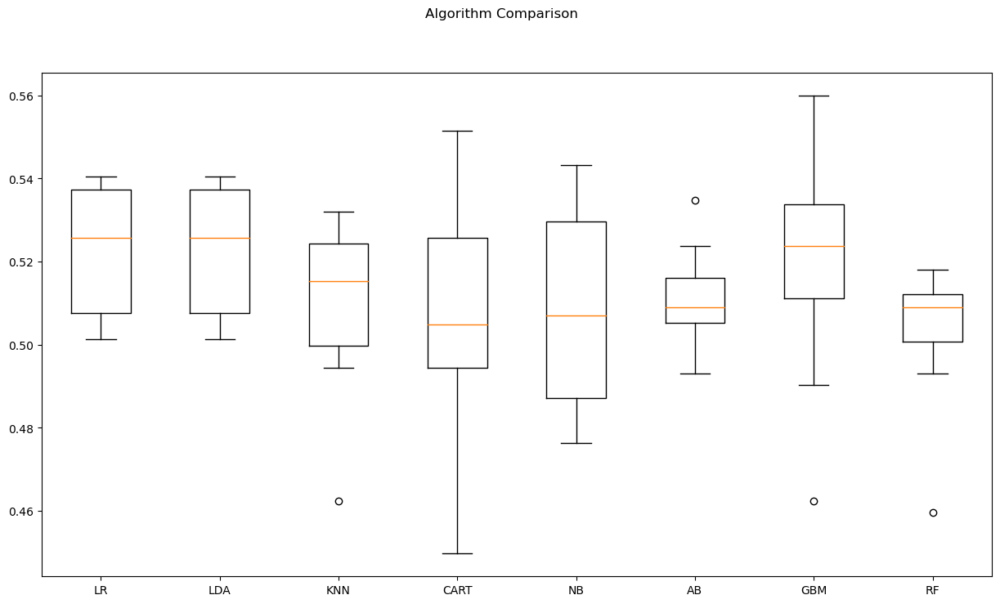

In [191]:
fig = plt.figure()
fig.suptitle("Algorithm Comparison")

ax = fig.add_subplot(111)

plt.boxplot(results)

ax.set_xticklabels(names)

fig.set_size_inches(15,8)

plt.show()

### Comparison of Algorithms

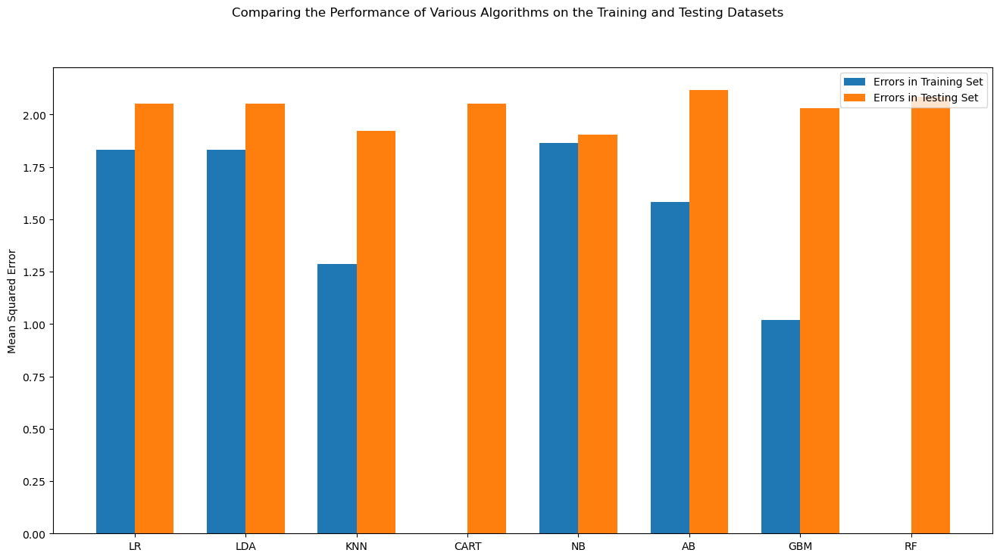

In [192]:
fig = plt.figure(figsize = (16, 8)
                 )

ind = np.arange(len(names)
               ) 
width = 0.35

fig.suptitle("Comparing the Performance of Various Algorithms on the Training and Testing Datasets")
ax = fig.add_subplot(111)

plt.bar(ind - width/2, 
        train_results, 
        width = width,
        label = "Errors in Training Set")

plt.bar(ind + width/2, 
        test_results, 
        width = width,
        label = "Errors in Testing Set")

plt.legend()

ax.set_xticks(ind)
ax.set_xticklabels(names)

plt.ylabel("Mean Squared Error")

plt.show()

According to the criteria above, We choose KNN, Gaussian NB. But we notice that the CART has the lowest in-sample errors. As our goal is to pursue the largest in-sample accumulative return, we will still preserve this algorithm. In practice, CART may not be a good choice due to the problem of over-fitting. But our goal determines that we will not give this algorithm up.

<a id="2"></a >
# Part 2: Backtesting

## Part 2: Backtesting: Momentum SMA (Best Return)

### Sharpe Ratio 

In [49]:
# Sharpe Ratio
SMA_return = momentum_sma_df['STRATEGY']
SMA_sharpe1 = np.sqrt(253) * (SMA_return.mean() / SMA_return.std())
SMA_sharpe1

0.5668442577770458

### CAGR 

In [50]:
# CAGR
SPY_day = (spy_df.index[-1] - spy_df.index[0]).days
CAGR_SMA1 = ((np.exp(momentum_sma_df.STRATEGY.sum()))** (1 / (SPY_day /365))) - 1
CAGR_SMA1

0.10959609061800712

### Maximum Drawdown 

In [51]:
# Maximum Drawdown
drawdown = (momentum_sma_df['MAX_GROSS_PERFORMANCE'] - momentum_sma_df["CUMULATIVE_RETURNS"])/momentum_sma_df['MAX_GROSS_PERFORMANCE']
max_drawdown_sma1 = drawdown.max()
max_drawdown_sma1

0.4171210463955986

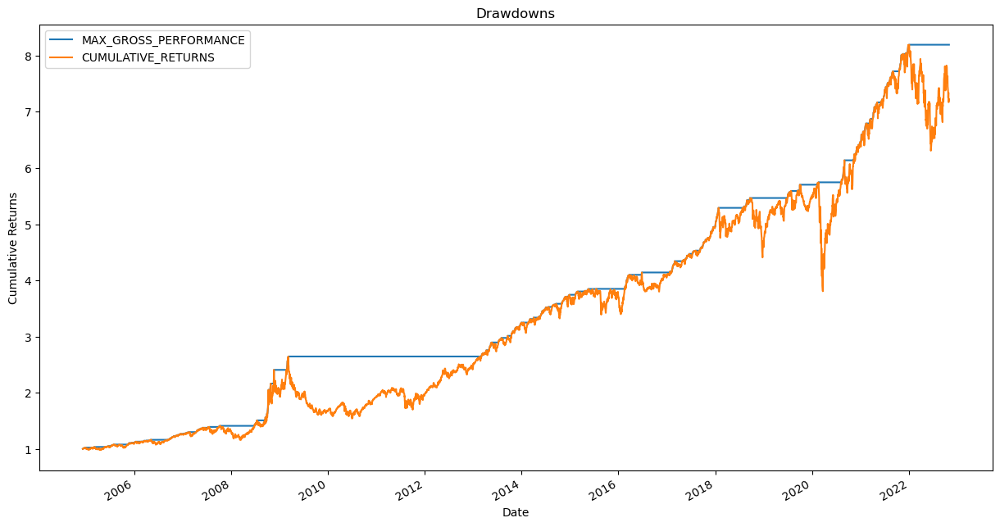

In [52]:
momentum_sma_df[["MAX_GROSS_PERFORMANCE", "CUMULATIVE_RETURNS"]].dropna().plot(figsize=(15,8)) 
plt.ylabel("Cumulative Returns") 
plt.title("Drawdowns")
plt.show()

### Money In Account

In [53]:
#SP500 
spy_df1 = spy_df.reset_index()

In [54]:
CS = [go.Candlestick(x = spy_df1.Date,
                     open = spy_df1.Open,
                     high = spy_df1.High,
                     low = spy_df1.Low,
                     close = spy_df1.Close)]
go.Figure(CS)

In [55]:
# Market Benchmark
capital = float(500000.0)
spy_df['RETURNS']=np.log(spy_df['Adj Close']/ spy_df['Adj Close'].shift(1))
HPR = spy_df['RETURNS'].cumsum().apply(np.exp)[-1]
Market_Benchmark=capital * HPR
Market_Benchmark

2648791.6078919275

In [56]:
# money in account
total_asset_sma1 = capital * momentum_sma_df['CUMULATIVE_RETURNS'][-1]
total_asset_sma1

3611787.101632339

In [57]:
momentum_sma_plot = [go.Scatter(x = momentum_sma_df.index, 
                                   y = momentum_sma_df['STRATEGY'].cumsum().apply(np.exp), 
                                   name = 'Strategy'), 
                    go.Scatter(x = momentum_sma_df.index, 
                              y = momentum_sma_df['RETURNS'].cumsum().apply(np.exp), 
                               name = 'Return')]

f = dict(data=momentum_sma_plot)
go.Figure(f)

## Part 2 Backtesting: Momentum SMA Strategy (Reasonable) 

In [58]:
# Sharpe Ratio
SMA_return = momentum_sma_df1['STRATEGY1']
SMA_sharpe2 = np.sqrt(253) * (SMA_return.mean() / SMA_return.std())
SMA_sharpe2

0.5256700699781256

In [59]:
# CAGR
SPY_day = (spy_df.index[-1] - spy_df.index[0]).days
CAGR_SMA2 = ((np.exp(momentum_sma_df1.STRATEGY1.sum()))** (1 / (SPY_day /365))) - 1
CAGR_SMA2

0.10108280479334741

In [60]:
# Maximum Drawdown
drawdown = (momentum_sma_df1['MAX_GROSS_PERFORMANCE1'] - momentum_sma_df1["CUMULATIVE_RETURNS1"])/momentum_sma_df1['MAX_GROSS_PERFORMANCE1']
max_drawdown_sma2 = drawdown.max()
max_drawdown_sma2

0.39548079246613527

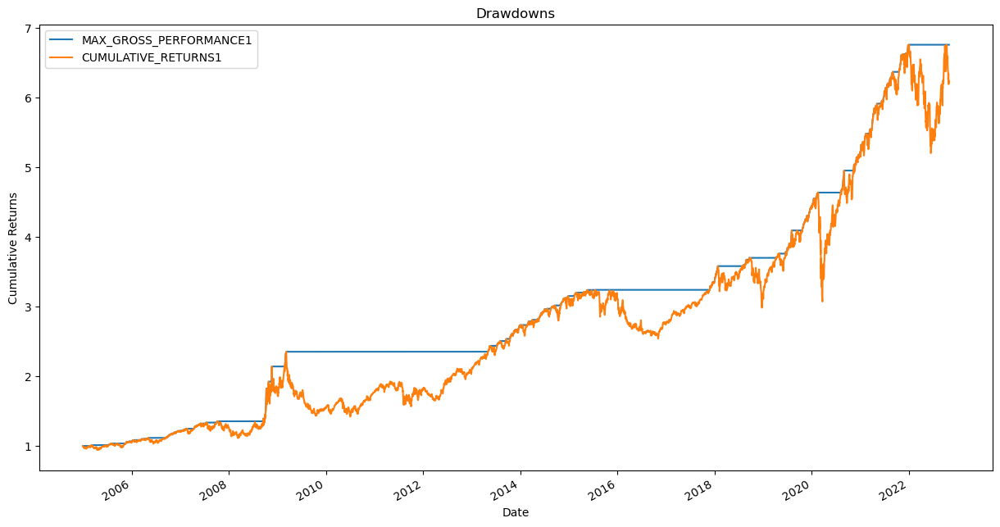

In [61]:
momentum_sma_df1[["MAX_GROSS_PERFORMANCE1", "CUMULATIVE_RETURNS1"]].dropna().plot(figsize=(15,8)) 
plt.ylabel("Cumulative Returns") 
plt.title("Drawdowns")
plt.show()

In [62]:
# Market Benchmark
capital = float(500000.0)
spy_df['RETURNS']=np.log(spy_df['Adj Close']/ spy_df['Adj Close'].shift(1))
HPR = spy_df['RETURNS'].cumsum().apply(np.exp)[-1]
Market_Benchmark=capital * HPR
Market_Benchmark

2648791.6078919275

In [63]:
# money in account
total_asset_sma2 = capital * momentum_sma_df1['CUMULATIVE_RETURNS1'][-1]
total_asset_sma2

3119769.513119791

In [64]:
momentum_sma_plot = [go.Scatter(x = momentum_sma_df1.index, 
                                   y = momentum_sma_df1['STRATEGY1'].cumsum().apply(np.exp), 
                                   name = 'Strategy'), 
                    go.Scatter(x = momentum_sma_df.index, 
                              y = momentum_sma_df1['RETURNS'].cumsum().apply(np.exp), 
                               name = 'Return')]

f = dict(data=momentum_sma_plot)
go.Figure(f)

## Part 2: Backtesting: Momentum EMA

### Sharpe Ratio 

In [65]:
# Sharpe Ratio
EMA_return = momentum_ema_df['STRATEGY']
EMA_sharpe = np.sqrt(253) * (EMA_return.mean() / EMA_return.std())
EMA_sharpe

0.5621331892594189

### CAGR 

In [66]:
# CAGR
SPY_day = (spy_df.index[-1] - spy_df.index[0]).days
CAGR_EMA = ((np.exp(momentum_ema_df.STRATEGY.sum()))** (1 / (SPY_day /365))) - 1
CAGR_EMA

0.10863866380589382

### Maximum Drawdown 

In [67]:
# Maximum Drawdown
drawdown = (momentum_ema_df['MAX_GROSS_PERFORMANCE'] - momentum_ema_df["CUMULATIVE_RETURNS"])/momentum_ema_df['MAX_GROSS_PERFORMANCE']
max_drawdown_EMA = drawdown.max()
max_drawdown_EMA

0.4225266541916312

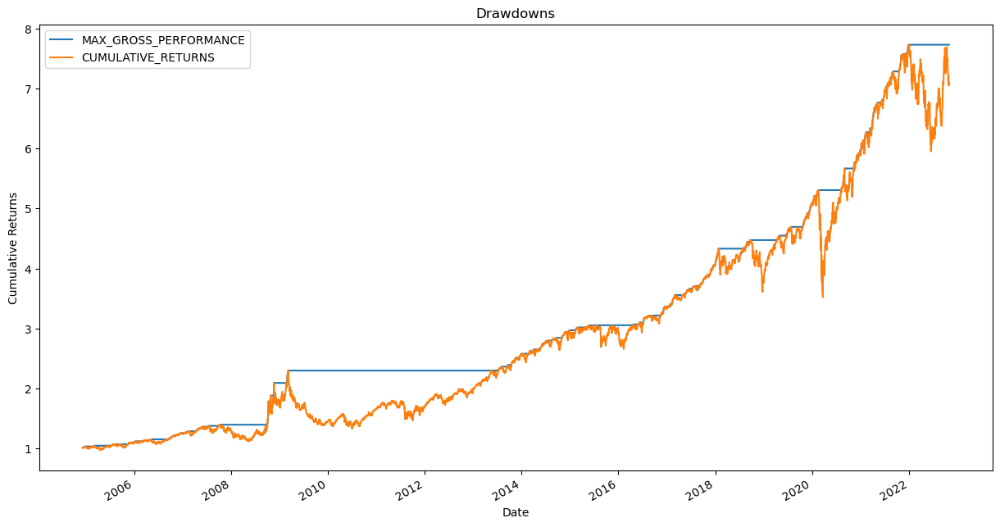

In [68]:
momentum_ema_df[["MAX_GROSS_PERFORMANCE", "CUMULATIVE_RETURNS"]].dropna().plot(figsize=(15,8)) 
plt.ylabel("Cumulative Returns") 
plt.title("Drawdowns")
plt.show()

### Money in Account 

In [69]:
# Market Benchmark
Market_Benchmark

2648791.6078919275

In [70]:
# money in account
total_asset_EMA = capital * momentum_ema_df['CUMULATIVE_RETURNS'][-1]
total_asset_EMA

3552989.767814113

In [71]:
momentum_ema_plot = [go.Scatter(x=momentum_ema_df.index,
                               y = momentum_ema_df['STRATEGY'].cumsum().apply(np.exp),
                                                                     name='Strategy'),
                    go.Scatter(x=momentum_ema_df.index,
                               y = momentum_ema_df['RETURNS'].cumsum().apply(np.exp),
                                                                     name='Return')]
go.Figure(momentum_ema_plot)

## Part 2: Backtesting - Momentum MACD

### Sharpe Ratio 

In [72]:
# Sharpe Ratio
MACD_return = momentum_macd_df['STRATEGY']
MACD_sharpe = np.sqrt(253) * (MACD_return.mean() / MACD_return.std())
MACD_sharpe

0.4504097357465485

### CAGR 

In [73]:
# CAGR
SPY_day = (spy_df.index[-1] - spy_df.index[0]).days
CAGR_MACD = ((np.exp(momentum_macd_df.STRATEGY.sum()))** (1 / (SPY_day /365))) - 1
CAGR_MACD

0.05055286774976464

### Maximum Drawdown 

In [74]:
# Maximum Drawdown
drawdown = (momentum_macd_df['MAX_GROSS_PERFORMANCE'] - momentum_macd_df["CUMULATIVE_RETURNS"])/momentum_macd_df['MAX_GROSS_PERFORMANCE']
max_drawdown_MACD = drawdown.max()
max_drawdown_MACD

0.22906898642436918

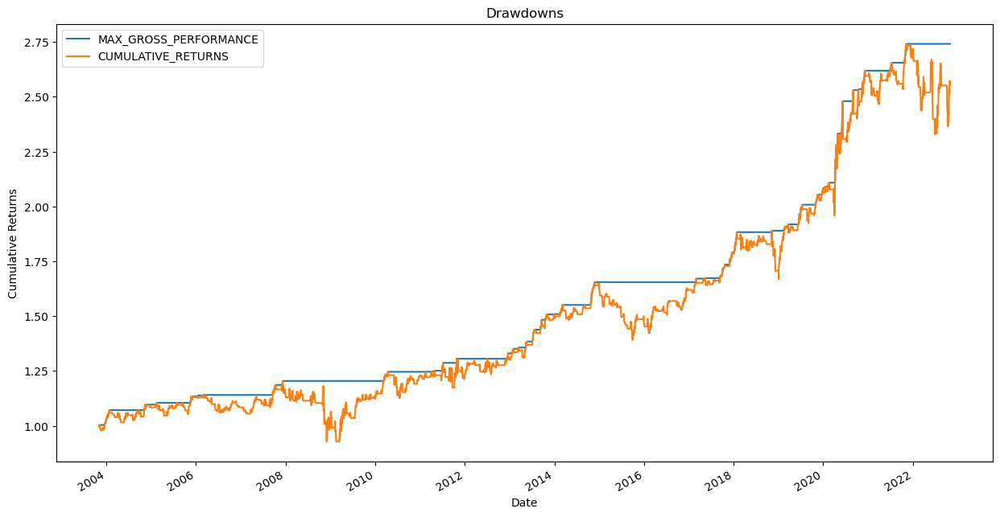

In [75]:
momentum_macd_df[["MAX_GROSS_PERFORMANCE", "CUMULATIVE_RETURNS"]].dropna().plot(figsize=(15,8)) 
plt.ylabel("Cumulative Returns") 
plt.title("Drawdowns")
plt.show()

### Money in Account 

In [76]:
# Market Benchmark
Market_Benchmark

2648791.6078919275

In [77]:
# money in account
total_asset_MACD = capital * momentum_macd_df['CUMULATIVE_RETURNS'][-1]
total_asset_MACD

1277037.7635848306

In [78]:
momentum_macd_plot = [go.Scatter(x=momentum_macd_df.index,
                               y = momentum_macd_df['STRATEGY'].cumsum().apply(np.exp),
                                                                     name='Strategy'),
                    go.Scatter(x=momentum_macd_df.index,
                               y = momentum_macd_df['RETURNS'].cumsum().apply(np.exp),
                                                                     name='Return')]
go.Figure(momentum_macd_plot)

## Part 2 Backtesting - Momentum Strategy RSI

In [79]:
def RSIBacktester(Ticker, Start = '2003-11-01', End = '2022-10-31', Overbought = 70, Oversold = 30, Closing = 50, Capital = 500000, Trading_Fee = 0):
    
    ## PARSE STOCK DATA FROM YAHOO FINANCE
    RSIdf = yf.download(Ticker ,start = Start, end = End)
    RSIdf = pd.DataFrame(RSIdf['Adj Close'])
    
    ## RSI CALCULATION
    RSIdf['Daily Change'] = RSIdf['Adj Close'].diff()

    RSIperiod = 14 ## lookback window

    RSIdf['Up']= [x if x > 0 else 0 for x in RSIdf['Daily Change']]
    RSIdf['Down']= [abs(x) if x < 0 else 0 for x in RSIdf['Daily Change']]
    
    RSIdf['Up']= RSIdf['Up'].ewm(span = RSIperiod, min_periods = RSIperiod - 1).mean()
    RSIdf['Down']= RSIdf['Down'].ewm(span = RSIperiod, min_periods = RSIperiod - 1).mean()
    
    #.ewm Variation from PyDay: .ewm(com = RSIperiod - 1, adjust = False).mean()
    #com Param Specifies decay in terms of center of mass
    #Alpha = 1/(1 + Com) for Com >= 0 -> This is different from Span's Alpha = 2/(1 + Com) for Span >= 1
    #adjust = False Param calculates the exponentially weighted function recursively:
    #Yt = (1 - Alpha)*Yt-1 + Alpha*Xt
    
    RSIdf['RS']= RSIdf['Up']/RSIdf['Down']
    RSIdf['RSI']=100-(100/( 1 + RSIdf['RS']))
    
    ## SETUP/RESET NECESSARY COLUMNS FOR STRATEGY EXECUTION
    RSIdf['Yesterday RSI'] = RSIdf['RSI'].shift(1)
    RSIdf["Signal"] = 0
    RSIdf["Position"] = 0
    RSIdf["Execution"] = 0
    RSIdf["Closing"] = 0
    RSIdf["Capital"] = Capital
    RSIdf["Cash"] = Capital
    RSIdf["Stock_Holding"] = 0
    RSIdf["Daily_Stock_Value"] = 0

    for i in range(len(RSIdf)): 
        
        ##SIGNAL GENERATION
        if RSIdf["Yesterday RSI"][i] < Oversold and RSIdf['RSI'][i] > Oversold and  RSIdf['RSI'][i] < Closing and RSIdf["RSI"][i] > RSIdf["Yesterday RSI"][i]: 
            RSIdf["Signal"][i] = 1  
        elif RSIdf["Yesterday RSI"][i] > Overbought and RSIdf['RSI'][i] < Overbought and  RSIdf['RSI'][i] > Closing and RSIdf["RSI"][i] < RSIdf["Yesterday RSI"][i]: 
            RSIdf["Signal"][i] = -1  
        else: 
            RSIdf["Signal"][i] = 0

        ##SIGNAL EXECUTION CHECK
        if RSIdf["Position"][i] == 0 and abs(RSIdf['Signal'])[i] == 1: #Execute Signals only when Position = 0 
            RSIdf["Position"][i:] = RSIdf['Signal'][i]

            if RSIdf["Position"][i] == 1: #Execute Long Trade
                RSIdf["Stock_Holding"][i:] = int(0.8 * ((RSIdf["Cash"][i]- Trading_Fee)/RSIdf["Adj Close"][i]))
                RSIdf["Daily_Stock_Value"][i:] = RSIdf["Adj Close"][i] * RSIdf["Stock_Holding"][i]
                RSIdf["Cash"][i:] = RSIdf["Cash"][i] - RSIdf["Daily_Stock_Value"][i] - Trading_Fee
                RSIdf["Capital"][i:] = RSIdf["Cash"][i] + RSIdf["Daily_Stock_Value"][i]
                RSIdf["Execution"][i] = 1

            elif RSIdf["Position"][i] == -1: #Execute Short Trade
                RSIdf["Stock_Holding"][i:] = -int(0.8 * ((RSIdf["Cash"][i]- Trading_Fee)/RSIdf["Adj Close"][i]))
                RSIdf["Daily_Stock_Value"][i:] = RSIdf["Adj Close"][i] * RSIdf["Stock_Holding"][i]
                RSIdf["Cash"][i:] = RSIdf["Cash"][i] + abs(RSIdf["Daily_Stock_Value"][i]) - Trading_Fee
                RSIdf["Capital"][i:] = RSIdf["Cash"][i] + RSIdf["Daily_Stock_Value"][i]
                RSIdf["Execution"][i] = 1
        else:
            RSIdf["Daily_Stock_Value"][i:] = RSIdf["Adj Close"][i] * RSIdf["Stock_Holding"][i]
            RSIdf["Capital"][i:] = RSIdf["Cash"][i] + RSIdf["Daily_Stock_Value"][i]

        ##TRADE CLOSING CHECK
        if RSIdf["Position"][i] == 1 and RSIdf['RSI'][i] > 50: #Close Long Position
            RSIdf["Cash"][i:] = RSIdf["Cash"][i] + RSIdf["Daily_Stock_Value"][i] - Trading_Fee
            RSIdf["Daily_Stock_Value"][i:] = 0
            RSIdf["Stock_Holding"][i:] = 0
            RSIdf["Position"][i:] = 0
            RSIdf["Capital"][i:] = RSIdf["Cash"][i] 
            RSIdf["Closing"][i] = 1

        elif RSIdf["Position"][i] == -1 and RSIdf['RSI'][i] < 50: #Close Short Position
            RSIdf["Cash"][i:] = RSIdf["Cash"][i] + RSIdf["Daily_Stock_Value"][i] - Trading_Fee
            RSIdf["Daily_Stock_Value"][i:] = 0
            RSIdf["Stock_Holding"][i:] = 0
            RSIdf["Position"][i:] = 0
            RSIdf["Capital"][i:] = RSIdf["Cash"][i] 
            RSIdf["Closing"][i] = 1
        else: 
            RSIdf["Daily_Stock_Value"][i:] = RSIdf["Adj Close"][i] * RSIdf["Stock_Holding"][i]
            RSIdf["Capital"][i:] = RSIdf["Cash"][i] + RSIdf["Daily_Stock_Value"][i]
    
    RSIdf['Return'] = np.log(RSIdf['Capital']/RSIdf['Capital'].shift(1))
    RSIdf['Strategy Cumulative Returns'] = np.exp(RSIdf['Return'].cumsum())-1
    RSIdf['Holding Returns'] = np.exp(np.log(RSIdf['Adj Close']/RSIdf['Adj Close'].shift(1)).cumsum()) - 1
    RSIdf['Max Gross Performance'] = RSIdf['Strategy Cumulative Returns'].cummax()
    RSIdf['Drawdown'] = RSIdf['Max Gross Performance'] - RSIdf["Strategy Cumulative Returns"]
    
    ##PLOT RSI TEST RESULTS
    RSIPlot(RSIdf,Overbought,Oversold,Closing)
    
    return RSIdf

[*********************100%***********************]  1 of 1 completed


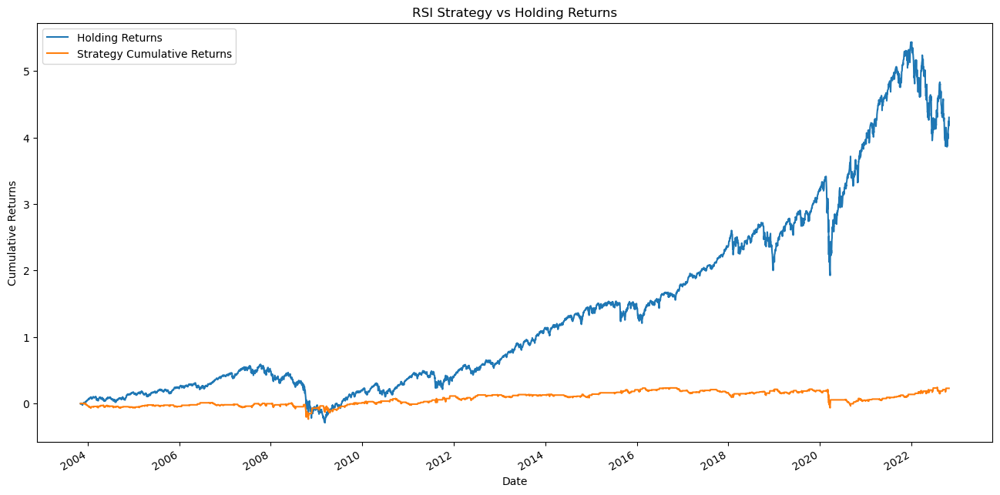

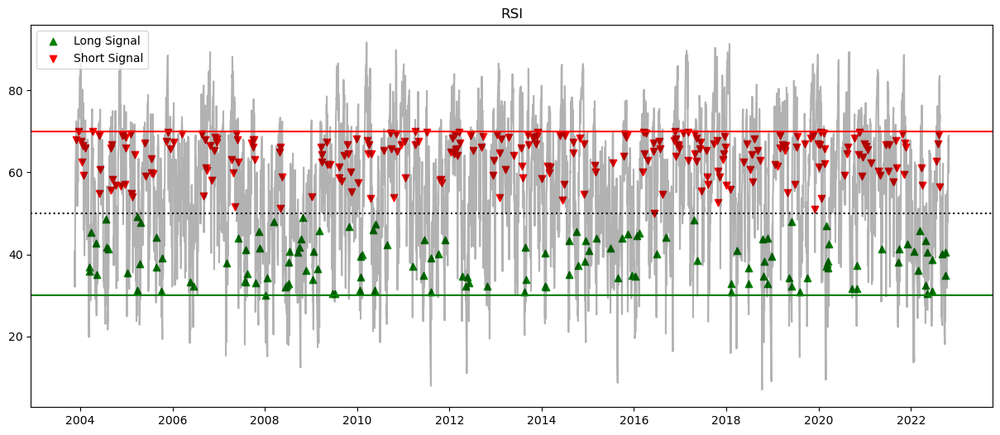

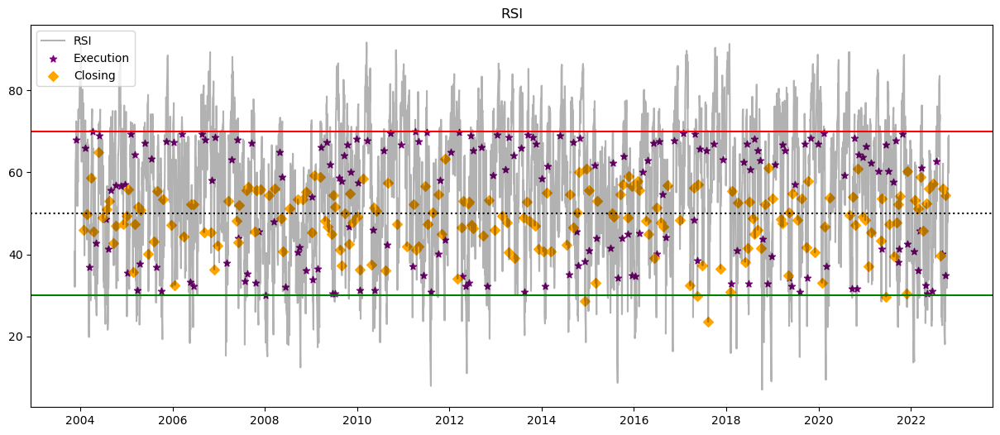

,Adj Close,Daily Change,Up,Down,RS,RSI,Yesterday RSI,Signal,Position,Execution,Closing,Capital,Cash,Stock_Holding,Daily_Stock_Value,Return,Strategy Cumulative Returns,Holding Returns,Max Gross Performance,Drawdown
Date,,,,,,,,,,,,,,,,,,,,
2003-11-03,73.380775,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,500000.000000,500000.000000,0,0.0,NaN,NaN,NaN,NaN,NaN
2003-11-04,73.221535,-0.159241,NaN,NaN,NaN,NaN,NaN,0,0,0,0,500000.000000,500000.000000,0,0.0,0.0,0.000000,-0.002170,0.000000,0.000000
2003-11-05,73.276917,0.055382,NaN,NaN,NaN,NaN,NaN,0,0,0,0,500000.000000,500000.000000,0,0.0,0.0,0.000000,-0.001415,0.000000,0.000000
2003-11-06,73.664665,0.387749,NaN,NaN,NaN,NaN,NaN,0,0,0,0,500000.000000,500000.000000,0,0.0,0.0,0.000000,0.003869,0.000000,0.000000
2003-11-07,73.117676,-0.546989,NaN,NaN,NaN,NaN,NaN,0,0,0,0,500000.000000,500000.000000,0,0.0,0.0,0.000000,-0.003585,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-24,378.869995,4.579987,3.495491,2.025843,1.725450,63.308810,58.746088,0,0,0,0,614459.315231,614459.315231,0,0.0,0.0,0.228919,4.163069,0.244536,0.015617
2022-10-25,384.920013,6.050018,3.836095,1.755731,2.184899,68.601831,63.308810,0,0,0,0,614459.315231,614459.315231,0,0.0,0.0,0.228919,4.245516,0.244536,0.015617
2022-10-26,382.019989,-2.900024,3.324616,1.908303,1.742184,63.532716,68.601831,0,0,0,0,614459.315231,614459.315231,0,0.0,0.0,0.228919,4.205996,0.244536,0.015617


In [80]:
RSIdf = RSIBacktester('SPY')
RSIdf

### Money Left in Account 

In [81]:
# strategy return
caption = float(500000.0)

total_asset_RSI = caption * RSIdf['Strategy Cumulative Returns'][-1]
total_asset_RSI

114459.31523132425

In [82]:
# market benchmark
Market_Benchmark

2648791.6078919275

### Maximum Drawdown 

In [83]:
def Drawdowns(RSIdf):  
      
    index = RSIdf[RSIdf['Drawdown'] == 0].index  
  
    a = []  
  
    for i in range(1,len(index)):  
        period = index[i].to_pydatetime() - index[i-1].to_pydatetime()  
        max_drawdown = RSIdf.loc[index[i-1]:index[i],'Drawdown'].max()  
        a.append([period,max_drawdown,index[i-1],index[i]])  
      
    df1 = pd.DataFrame(a,columns=['Period','Max Drawdown','Beginning','End']).sort_values('Max Drawdown',ascending=False)  
  
    return df1.head(5)

In [126]:
max_drawdown_rsi = Drawdowns(RSIdf)
max_drawdown_rsi

,Period,Max Drawdown,Beginning,End
513,2083 days,0.299356,2016-11-11,2022-07-26
74,1217 days,0.248734,2006-09-22,2010-01-21
109,378 days,0.101287,2010-09-23,2011-10-06
23,918 days,0.072195,2003-12-10,2006-06-15
148,175 days,0.065803,2012-01-13,2012-07-06


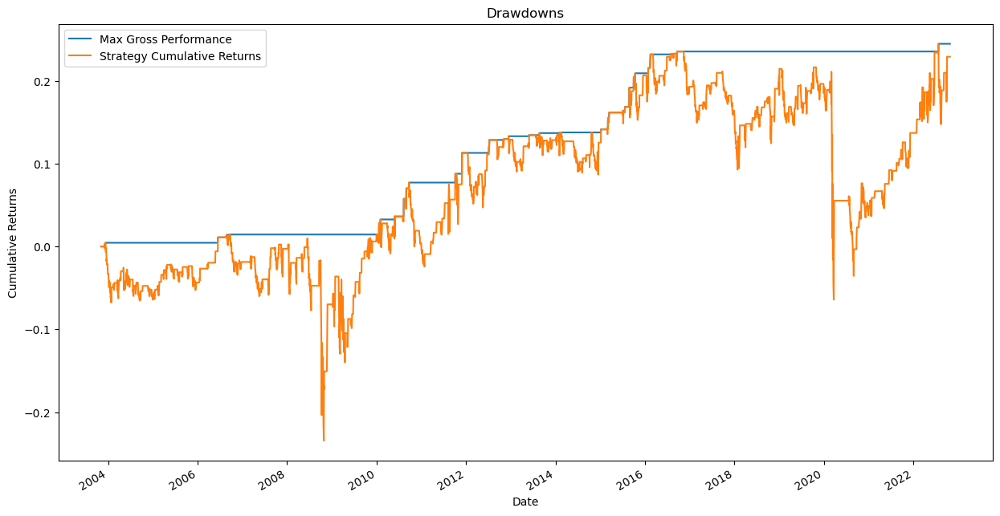

In [85]:
RSIdf[["Max Gross Performance", "Strategy Cumulative Returns"]].dropna().plot(figsize=(15,8)) 
plt.ylabel("Cumulative Returns") 
plt.title("Drawdowns")
plt.show()

### Average Annual Returns 

In [86]:
Avg_Annual_Returns = (np.exp(RSIdf["Return"].groupby(RSIdf.index.year).sum())-1).mean() 
Avg_Annual_Returns

0.011995260775071381

In [87]:
Annualized_Returns = np.exp(RSIdf["Return"].groupby(RSIdf.index.year).sum())-1 
Annualized_Returns

Date
2003   -0.033355
2004   -0.028646
2005    0.018668
2006    0.025990
2007    0.016262
2008   -0.067306
2009    0.090169
2010   -0.010094
2011    0.108682
2012    0.014338
2013   -0.000378
2014   -0.002724
2015    0.071982
2016   -0.011279
2017   -0.024105
2018    0.035018
2019   -0.009043
2020   -0.130852
2021    0.095707
2022    0.080871
Name: Return, dtype: float64

### Sharpe Ratio 

In [88]:
def sharpe_ratio(RSIdf, periods_per_year = 252): 
     
    n_years = RSIdf.shape[0]/periods_per_year 
     
    annualized_return = np.power(np.prod(1 + RSIdf['Return']), (1 / n_years) 
                                 ) - 1 
     
    annualized_vol = RSIdf['Return'].std() * np.sqrt(periods_per_year) 
     
    annualized_sharpe = annualized_return / annualized_vol 
     
    return annualized_return, annualized_vol, annualized_sharpe

In [89]:
RSI_sharpe = sharpe_ratio(RSIdf)[2]
RSI_sharpe

0.05470669881819548

### CAGR

In [90]:
SPY_day = (spy_df.index[-1] - spy_df.index[0]).days
RSI_CAGR = ((np.exp(RSIdf["Return"].sum()))** (1 / (SPY_day /365))) - 1
RSI_CAGR

0.010900354778877963

## Part 2 Backtesting - Mean Reversion SMA

### Sharpe Ratio 

In [91]:
# Sharpe Ratio
SMA_return = mean_sma_df['STRATEGY']
SMA_sharpe3 = np.sqrt(253) * (SMA_return.mean() / SMA_return.std())
SMA_sharpe3

0.13642929113239363

### CAGR 

In [92]:
# CAGR
SPY_day = (spy_df.index[-1] - spy_df.index[0]).days
SMA_CAGR1 = ((np.exp(mean_sma_df.STRATEGY.sum()))** (1 / (SPY_day /365))) - 1
SMA_CAGR1

0.021715011253275573

### Maximum Drawdown 

In [93]:
# Maximum Drawdown
drawdown = (mean_sma_df['MAX_GROSS_PERFORMANCE'] - mean_sma_df["CUMULATIVE_RETURNS"])/mean_sma_df['MAX_GROSS_PERFORMANCE']
max_drawdown_SMA = drawdown.max()
max_drawdown_SMA

0.40161222610556

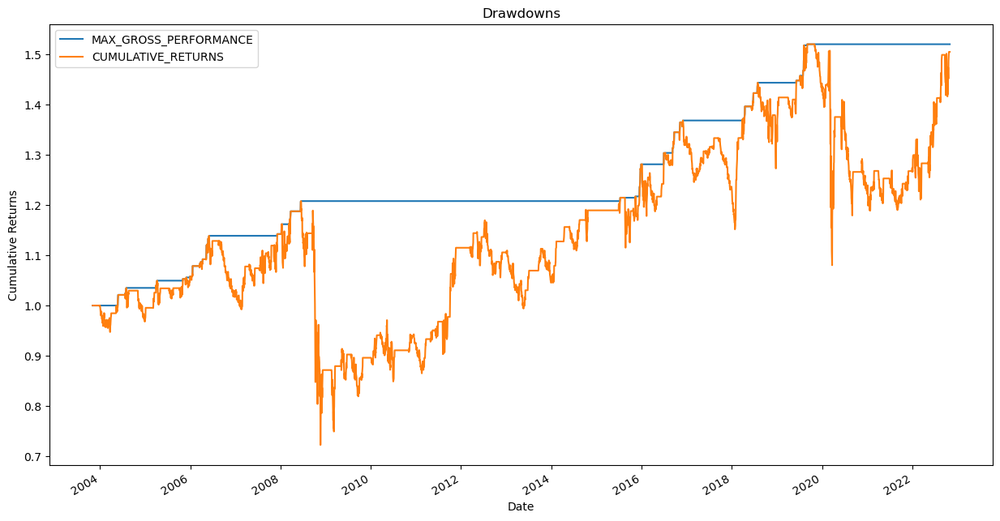

In [94]:
mean_sma_df[["MAX_GROSS_PERFORMANCE", "CUMULATIVE_RETURNS"]].dropna().plot(figsize=(15,8)) 
plt.ylabel("Cumulative Returns") 
plt.title("Drawdowns")
plt.show()

In [95]:
# Market Benchmark
Market_Benchmark

2648791.6078919275

In [96]:
# money in account
total_asset_sma3 = capital * mean_sma_df['CUMULATIVE_RETURNS'][-1]
total_asset_sma3

752252.2904937224

In [97]:
mean_sma_plot = [go.Scatter(x=mean_sma_df.index,
                               y = mean_sma_df['STRATEGY'].cumsum().apply(np.exp),
                                                                     name='Strategy'),
                    go.Scatter(x=mean_sma_df.index,
                               y = mean_sma_df['RETURNS'].cumsum().apply(np.exp),
                                                                     name='Return')]
go.Figure(mean_sma_plot)

## Part 2 Backtesting: Mean Reversion EMA

### Sharpe Ratio 

In [98]:
# Sharpe Ratio
EMA_return = mean_ema_df['STRATEGY']
EMA_sharpe2 = np.sqrt(253) * (EMA_return.mean() / EMA_return.std())
EMA_sharpe2

0.034473354880878715

### CAGR 

In [99]:
# CAGR
SPY_day = (spy_df.index[-1] - spy_df.index[0]).days
CAGR_EMA2 = ((np.exp(mean_ema_df.STRATEGY.sum()))** (1 / (SPY_day /365))) - 1
CAGR_EMA2

0.004221745703899105

### Maximum Drawdown 

In [100]:
# Maximum Drawdown
drawdown = (mean_ema_df['MAX_GROSS_PERFORMANCE'] - mean_ema_df["CUMULATIVE_RETURNS"])/mean_ema_df['MAX_GROSS_PERFORMANCE']
max_drawdown_EMA = drawdown.max()
max_drawdown_EMA

0.39212046448135596

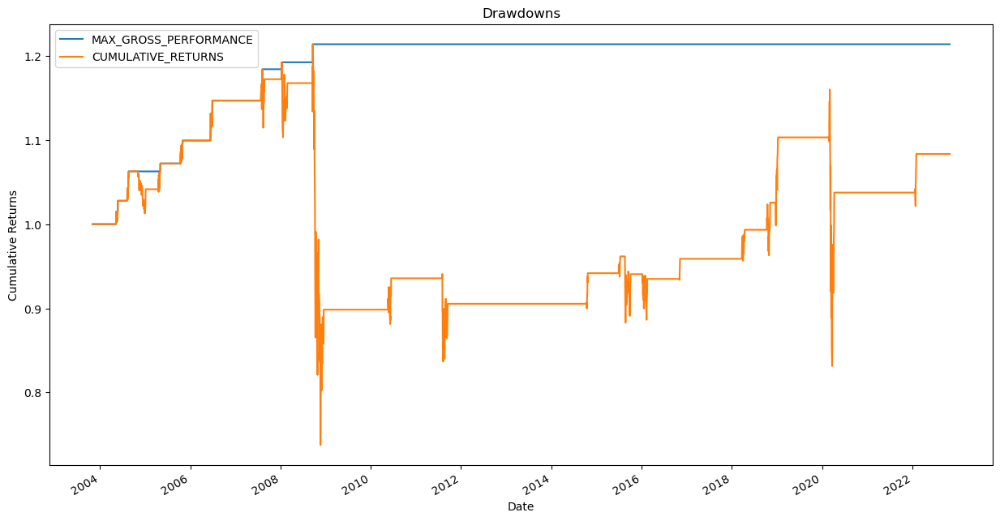

In [101]:
mean_ema_df[["MAX_GROSS_PERFORMANCE", "CUMULATIVE_RETURNS"]].dropna().plot(figsize=(15,8)) 
plt.ylabel("Cumulative Returns") 
plt.title("Drawdowns")
plt.show()

### Money Left in Account

In [102]:
# Market Benchmark
Market_Benchmark

2648791.6078919275

In [103]:
# money in account
capital=500000
total_asset_EMA2 = capital * mean_ema_df['CUMULATIVE_RETURNS'][-1]
total_asset_EMA2


541698.8027242535

In [104]:
mean_ema_plot = [go.Scatter(x=mean_ema_df.index,
                               y = mean_ema_df['STRATEGY'].cumsum().apply(np.exp),
                                                                     name='Strategy'),
                    go.Scatter(x=mean_ema_df.index,
                               y = mean_ema_df['RETURNS'].cumsum().apply(np.exp),
                                                                     name='Return')]
go.Figure(mean_ema_plot)

## Part 2 Backtesting: MACD & RSI

In [105]:
def RSIMACDBacktester(Ticker, Strategy = 'Combo', Start = '2003-11-01', End = '2022-10-31',Slow = 26, Fast = 12, Signal = 9, Overbought = 70, Oversold = 30, Closing = 50, Capital = 500000, Trading_Fee = 0):
    
    ## PARSE STOCK DATA FROM YAHOO FINANCE
    df = yf.download(Ticker ,start = Start, end = End)
    df = pd.DataFrame(df[["Close", "Open", "High","Low","Volume", "Adj Close"]])
    
    ## MACD CALCULATION
    def EMA(df, n):
        EMA = pd.Series(df['Adj Close'].ewm(span = n, min_periods = n, adjust = False,).mean())
        return EMA

    df['EMA_Fast'] = EMA(df, Fast)
    df['EMA_Slow'] = EMA(df, Slow)
    df['MACD'] = df['EMA_Slow'] - df['EMA_Fast']
    df['MACD_S'] = df['MACD'].ewm(span = Signal, min_periods = Signal, adjust = False,).mean()
    df['MACD_H'] = df['MACD'] - df['MACD_S']
    df['MACD_ZERO_CROSS'] = df['MACD_H'].apply(lambda x :1 if x>0 else 0).diff()
    
    
    ## RSI CALCULATION
    df['Daily Change'] = df['Adj Close'].diff()

    RSIperiod = 14 ## lookback window

    df['Up']= [x if x > 0 else 0 for x in df['Daily Change']]
    df['Down']= [abs(x) if x < 0 else 0 for x in df['Daily Change']]
    
    df['Up']= df['Up'].ewm(span = RSIperiod, min_periods = RSIperiod - 1).mean()
    df['Down']= df['Down'].ewm(span = RSIperiod, min_periods = RSIperiod - 1).mean()
    
    df['RS']= df['Up']/df['Down']
    df['RSI']=100-(100/( 1 + df['RS']))
    
    ## SETUP/RESET NECESSARY COLUMNS FOR STRATEGY EXECUTION
    df['Yesterday RSI'] = df['RSI'].shift(1)
    df["Signal"] = 0
    df["Position"] = 0
    df["Execution"] = 0
    df["Closing"] = 0
    df["Capital"] = Capital
    df["Cash"] = Capital
    df["Stock_Holding"] = 0
    df["Daily_Stock_Value"] = 0
    
    def Update(df):    
        df["Daily_Stock_Value"][i:] = df["Adj Close"][i] * df["Stock_Holding"][i]
        df["Capital"][i:] = df["Cash"][i] + df["Daily_Stock_Value"][i]
        
    def CloseTrade(df):
        df["Cash"][i:] = df["Cash"][i] + df["Daily_Stock_Value"][i] - Trading_Fee
        df["Daily_Stock_Value"][i:] = 0
        df["Stock_Holding"][i:] = 0
        df["Position"][i:] = 0
        df["Capital"][i:] = df["Cash"][i] 
        df["Closing"][i] = 1 

    for i in range(len(df)): 
        
    
        ##SIGNAL GENERATION for MACD & RSI
        if Strategy == 'Combo':
            if df['RSI'][i] < Closing and df['MACD_ZERO_CROSS'][i] > 0:#BULLISH CROSSOVER 
                df["Signal"][i] = 1  
            elif df['RSI'][i] > Closing and df['MACD_ZERO_CROSS'][i] < 0:#BEARISH CROSSOVER 
                df["Signal"][i] = -1  
            else: 
                df["Signal"][i] = 0
        elif Strategy == 'MACD':
            if df['MACD_ZERO_CROSS'][i] > 0:#BULLISH CROSSOVER 
                df["Signal"][i] = 1  
            elif df['MACD_ZERO_CROSS'][i] < 0:#BEARISH CROSSOVER 
                df["Signal"][i] = -1  
            else: 
                df["Signal"][i] = 0
            
        ##TRADE CLOSING CHECK
        if Strategy == 'Combo':
            if df["Position"][i] == 1 and df['RSI'][i] > 50 and df['MACD_ZERO_CROSS'][i] < 0: #Close Bullish Position
                CloseTrade(df)

            elif df["Position"][i] == -1 and df['RSI'][i] < 50 and df['MACD_ZERO_CROSS'][i] > 0: #Close Bearish Position
                CloseTrade(df)
            else: 
                Update(df)
        elif Strategy == 'MACD':
            if df["Position"][i] == 1 and df['MACD_ZERO_CROSS'][i] < 0: #Close Bullish Position
                CloseTrade(df)

            elif df["Position"][i] == -1 and df['MACD_ZERO_CROSS'][i] > 0: #Close Bearish Position
                CloseTrade(df)
            else: 
                Update(df)

        ##SIGNAL EXECUTION CHECK
        if df["Position"][i] == 0 and abs(df['Signal'])[i] == 1: #Execute Signals only when Position = 0 
            df["Position"][i:] = df['Signal'][i]

            if df["Position"][i] == 1: #Execute Long Trade
                df["Stock_Holding"][i:] = int(0.8 * ((df["Cash"][i]- Trading_Fee)/df["Adj Close"][i]))
                df["Daily_Stock_Value"][i:] = df["Adj Close"][i] * df["Stock_Holding"][i]
                df["Cash"][i:] = df["Cash"][i] - df["Daily_Stock_Value"][i] - Trading_Fee
                df["Capital"][i:] = df["Cash"][i] + df["Daily_Stock_Value"][i]
                df["Execution"][i] = 1

            elif df["Position"][i] == -1: #Execute Short Trade
                df["Stock_Holding"][i:] = -int(0.8 * ((df["Cash"][i]- Trading_Fee)/df["Adj Close"][i]))
                df["Daily_Stock_Value"][i:] = df["Adj Close"][i] * df["Stock_Holding"][i]
                df["Cash"][i:] = df["Cash"][i] + abs(df["Daily_Stock_Value"][i]) - Trading_Fee
                df["Capital"][i:] = df["Cash"][i] + df["Daily_Stock_Value"][i]
                df["Execution"][i] = 1
        else:
            Update(df)
    
    df['Return'] = np.log(df['Capital']/df['Capital'].shift(1))
    df['Strategy Cumulative Returns'] = np.exp(df['Return'].cumsum())-1
    df['Hodling Returns'] = np.exp(np.log(df['Adj Close']/df['Adj Close'].shift(1)).cumsum()) - 1
    df['Max Gross Performance'] = df['Strategy Cumulative Returns'].cummax()
    df['Drawdown'] = df['Max Gross Performance'] - df["Strategy Cumulative Returns"]
    
    return df

In [106]:
SPY = RSIMACDBacktester('SPY')
SPY

[*********************100%***********************]  1 of 1 completed


,Close,Open,High,Low,Volume,Adj Close,EMA_Fast,EMA_Slow,MACD,MACD_S,...,Closing,Capital,Cash,Stock_Holding,Daily_Stock_Value,Return,Strategy Cumulative Returns,Hodling Returns,Max Gross Performance,Drawdown
Date,,,,,,,,,,,,,,,,,,,,,
2003-11-03,105.989998,105.750000,106.610001,105.709999,37589300,73.380775,NaN,NaN,NaN,NaN,...,0,500000.000000,500000.000000,0,0.000000,NaN,NaN,NaN,NaN,NaN
2003-11-04,105.760002,105.989998,106.269997,105.580002,31421600,73.221535,NaN,NaN,NaN,NaN,...,0,500000.000000,500000.000000,0,0.000000,0.000000,0.000000,-0.002170,0.000000,0.000000
2003-11-05,105.839996,105.489998,105.970001,104.900002,33558800,73.276917,NaN,NaN,NaN,NaN,...,0,500000.000000,500000.000000,0,0.000000,0.000000,0.000000,-0.001415,0.000000,0.000000
2003-11-06,106.400002,105.599998,106.440002,105.099998,28392300,73.664665,NaN,NaN,NaN,NaN,...,0,500000.000000,500000.000000,0,0.000000,0.000000,0.000000,0.003869,0.000000,0.000000
2003-11-07,105.610001,106.639999,106.720001,105.570000,31723200,73.117676,NaN,NaN,NaN,NaN,...,0,500000.000000,500000.000000,0,0.000000,0.000000,0.000000,-0.003585,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-24,378.869995,375.890015,380.059998,373.109985,85436900,378.869995,369.280829,372.505403,3.224574,5.909024,...,0,25651.988991,5193.009254,54,20458.979736,0.009688,-0.948696,4.163069,0.012255,0.960951
2022-10-25,384.920013,378.790009,385.250000,378.670013,78846300,384.920013,371.686857,373.425004,1.738147,5.074849,...,0,25978.689980,5193.009254,54,20785.680725,0.012655,-0.948043,4.245516,0.012255,0.960298
2022-10-26,382.019989,381.619995,387.579987,381.350006,104087300,382.019989,373.276570,374.061670,0.785100,4.216899,...,0,25822.088661,5193.009254,54,20629.079407,-0.006046,-0.948356,4.205996,0.012255,0.960611


In [107]:
TAPlotter(SPY)

<Figure size 1600x1600 with 0 Axes>

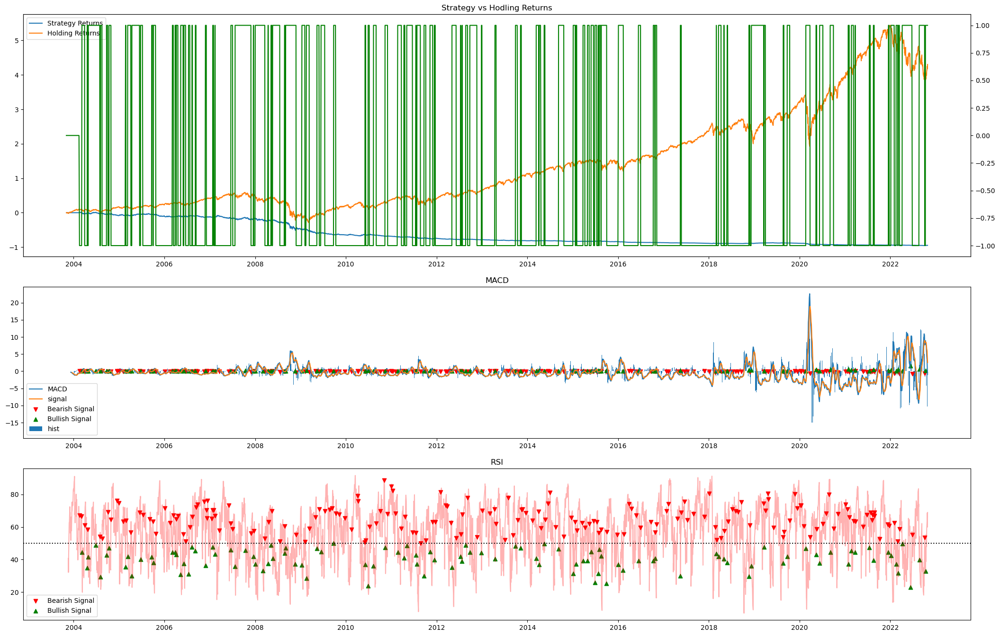

In [108]:
Plotter(SPY)

### Sharpe Ratio 

In [113]:
Combodf = RSIMACDBacktester('SPY', Strategy = 'Combo')
sharpe_rsimacd = sharpe_ratio(Combodf)[2]
sharpe_rsimacd

[*********************100%***********************]  1 of 1 completed


-1.0297046984756204

### Money Left in Account 

In [117]:
caption = float(500000.0)

total_asset_rsimacd = caption * SPY['Strategy Cumulative Returns'][-1]
total_asset_rsimacd

-473799.91133880615

In [118]:
# market benchmark
Market_Benchmark

2648791.6078919275

### Maximum Drawdown 

In [123]:
max_drawdown_rsimacd = Drawdowns(SPY)
max_drawdown_rsimacd

,Period,Max Drawdown,Beginning,End
0,1 days,0.0,2003-11-04,2003-11-05
56,1 days,0.0,2004-01-27,2004-01-28
54,3 days,0.0,2004-01-23,2004-01-26
53,1 days,0.0,2004-01-22,2004-01-23
52,1 days,0.0,2004-01-21,2004-01-22


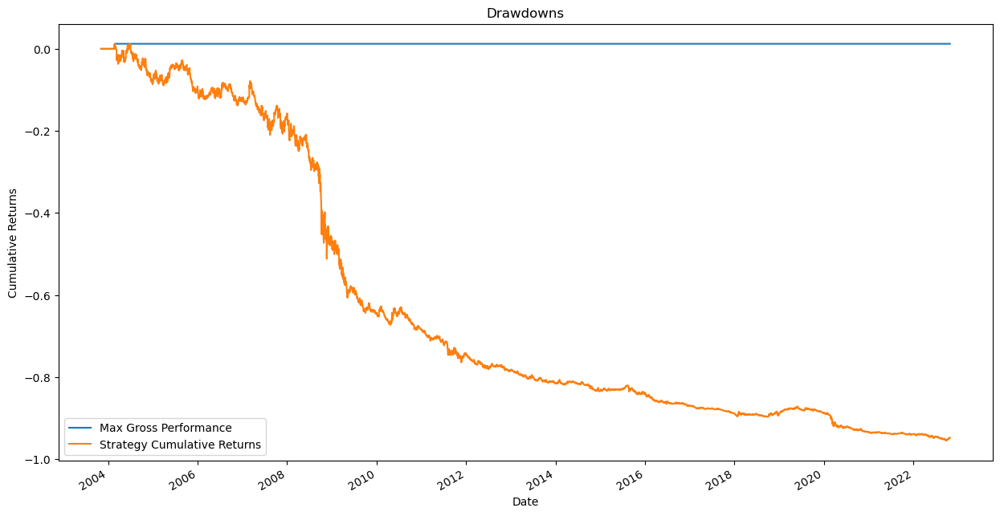

In [120]:
SPY[["Max Gross Performance", "Strategy Cumulative Returns"]].dropna().plot(figsize=(15,8)) 
plt.ylabel("Cumulative Returns") 
plt.title("Drawdowns")
plt.show()

### CAGR 

In [121]:
SPY_day = (spy_df.index[-1] - spy_df.index[0]).days
RSIMACD_CAGR = ((np.exp(SPY["Return"].sum()))** (1 / (SPY_day /365))) - 1
RSIMACD_CAGR

-0.14366238206252258

## Part 2 Backtesting: Machine Learning

In [193]:
def backtest(model,model_name):
    M= model
    M.fit(X_rescale,Y)
    Predicts=pd.Series(M.predict(X_rescale))
    Predicts.index = Y.index
    Predicts.name='predicts'

    data2=pd.concat([sp500['Adj Close'],Predicts],axis=1,join='inner')
    data2['return']=np.log(data2['Adj Close']/data2['Adj Close'].shift(1))
    data2['cum_returns']=data2['return'].cumsum().apply(np.exp)
    data2['strategy']=data2['return']*data2['predicts'].shift(1)
    data2['cum_strategy']=data2['strategy'].cumsum().apply(np.exp)
    data2['cum_max']= data2['cum_strategy'].cummax()

    data2['signal']=np.where(data2['return']>0,1,-1)
    data2['signal']=data2['signal'].shift(-1)

    sharpe_ratio=(data2['strategy'].mean()/data2['strategy'].std())*np.sqrt(252)
    D = (data2.index[-1]-data2.index[0]).days
    CAGR = (((data2['cum_strategy'][-1]) / (data2["cum_strategy"][1])) ** (365.0/D)) - 1
    drawdown_daily = data2['cum_strategy']/data2['cum_max']-1
    max_drawdown = -drawdown_daily.min()
    total_asset=500000.0 * data2['cum_strategy'][-1]
    
    table=pd.DataFrame({'Sharpe Ratio': sharpe_ratio, 
                        'CAGR': CAGR,
                        'Max Drawdown': max_drawdown,
                        'Total Asset': total_asset,
                        'Strategy Return': data2['cum_strategy'][-1]
    },columns=['Sharpe Ratio','CAGR','Max Drawdown','Total Asset','Strategy Return'],index=[model_name])
     
    data2[['cum_strategy','cum_returns']].plot(figsize=(10,6))
    
    return data2,table

## Logistic Regression 

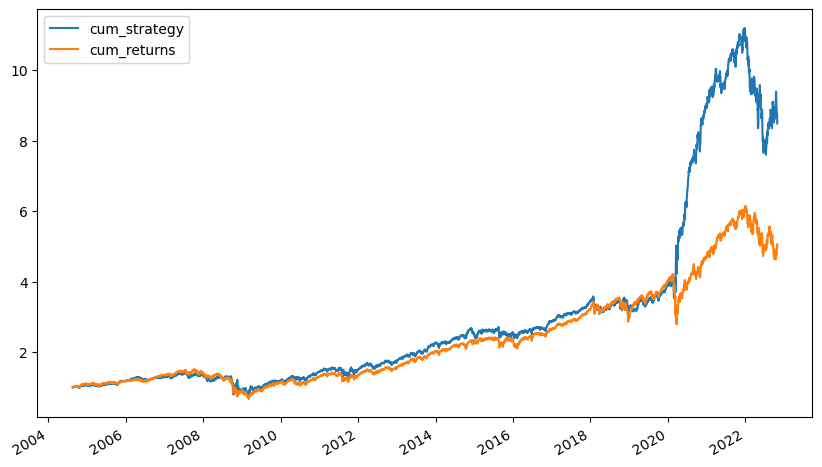

In [194]:
LR,LR_p=backtest(LogisticRegression(n_jobs = -1),'LR')

## Linear Discriminant Analysis 

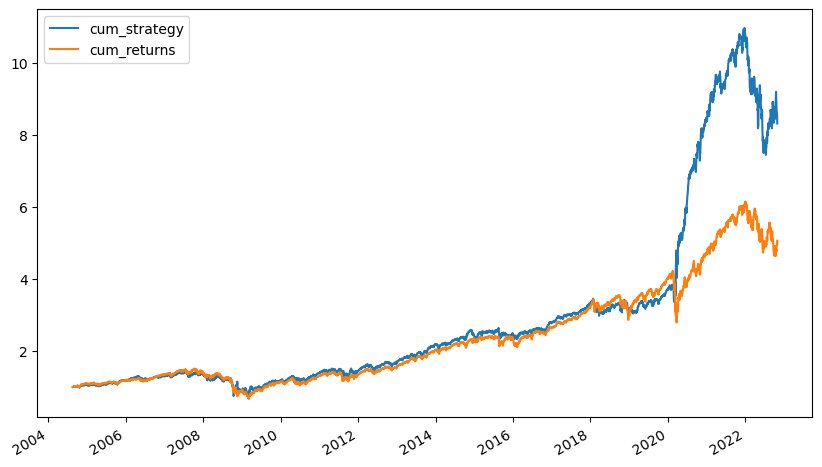

In [195]:
LDA,LDA_p=backtest(LinearDiscriminantAnalysis(),'LDA')

## KNeighborsClassifier

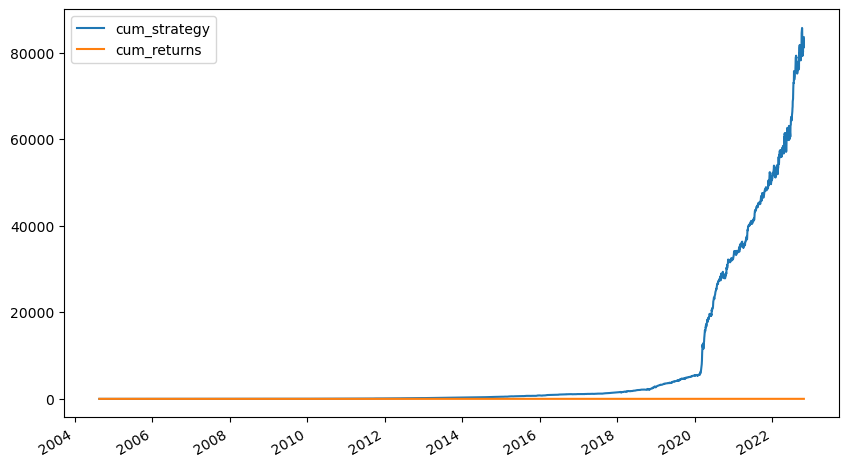

In [196]:
KNN,KNN_p=backtest(KNeighborsClassifier(),'KNN')

## Decision Tree Classifier 

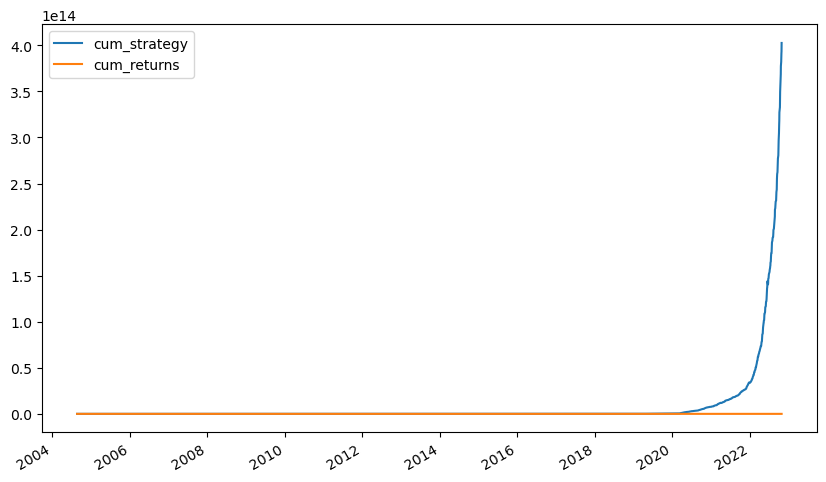

In [197]:
CART,CART_p=backtest(DecisionTreeClassifier(),'CART')

## GaussianNB

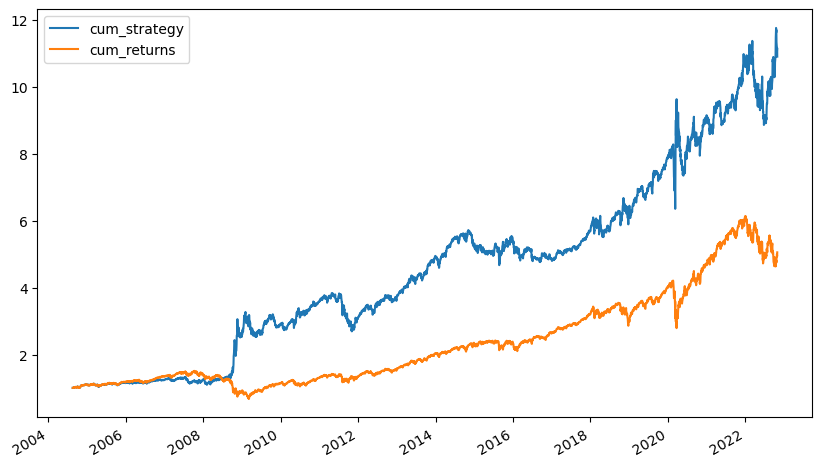

In [198]:
NB,NB_p=backtest(GaussianNB(),'NB')

<AxesSubplot:xlabel='Predicted', ylabel='Actual'>

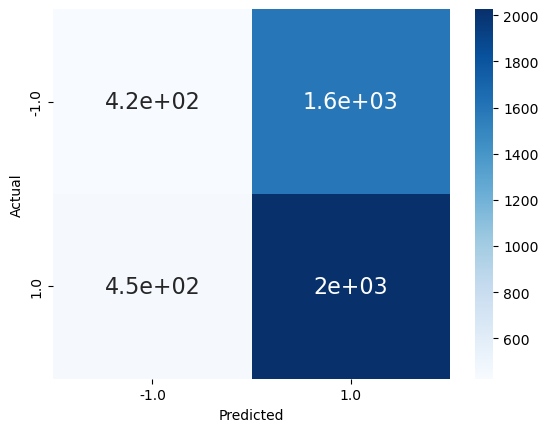

In [199]:
df_cm = pd.DataFrame(confusion_matrix(NB['signal'].iloc[:-1], NB['predicts'].iloc[:-1]), 
                     columns=np.unique(NB['signal'].iloc[:-1]), 
                     index = np.unique(NB['signal'].iloc[:-1])
                    )

df_cm.index.name = "Actual"
df_cm.columns.name = "Predicted"

sns.heatmap(df_cm, 
            cmap="Blues", 
            annot=True,
            annot_kws={"size": 16}
           )

In [200]:
print(accuracy_score(NB['signal'].iloc[:-1], NB['predicts'].iloc[:-1])
     )
print(confusion_matrix(NB['signal'].iloc[:-1], NB['predicts'].iloc[:-1])
     )
print(classification_report(NB['signal'].iloc[:-1], NB['predicts'].iloc[:-1])
     )

0.5468331846565566
[[ 425 1583]
 [ 449 2027]]
              precision    recall  f1-score   support

        -1.0       0.49      0.21      0.29      2008
         1.0       0.56      0.82      0.67      2476

    accuracy                           0.55      4484
   macro avg       0.52      0.52      0.48      4484
weighted avg       0.53      0.55      0.50      4484



In [201]:
NB_p

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
NB,0.686901,0.139879,0.298172,5.457523e+06,10.915045


## AdaBoostClassifier 

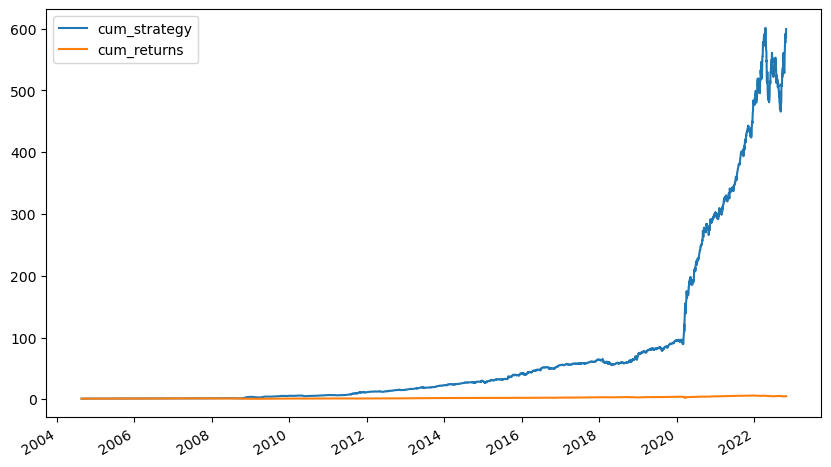

In [202]:
AB,AB_p=backtest(AdaBoostClassifier(),'AB')

## Gradient Boosting Classifier 

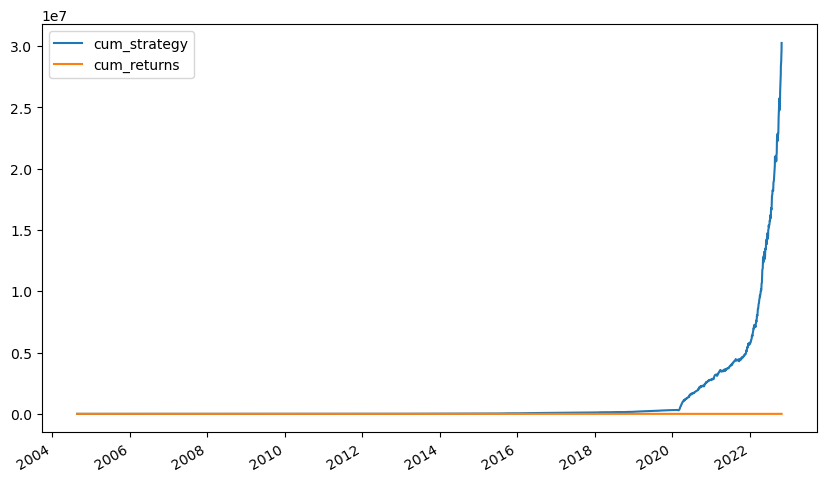

In [203]:
GBM,GBM_p=backtest(GradientBoostingClassifier(),'GBM')

## RandomForestClassifier

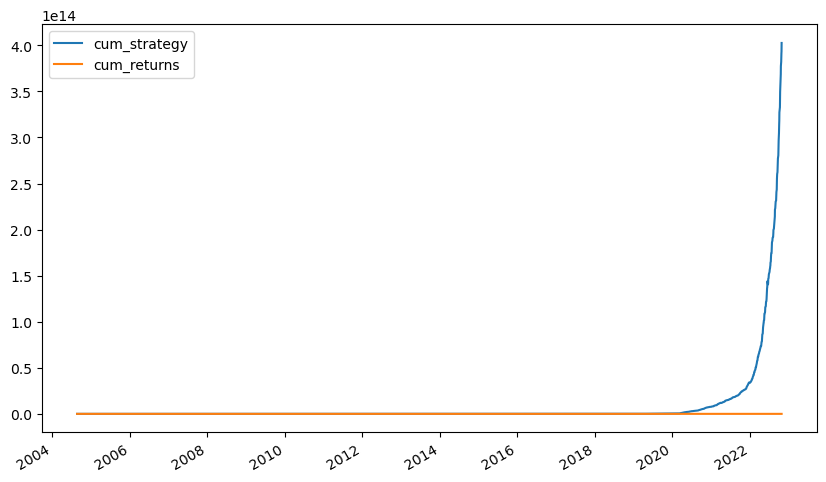

In [204]:
RF,RF_p=backtest(RandomForestClassifier(n_jobs = -1),'RF')

## Parameter Tuning

We can implement parameter tuning to KNN (Gaussian NB has no parameters to tune). the n_neighbors and weights can be changed. We can use grid_search() to determine the best parameters. The best n_neighbors is 4, and the best measure of weights is ‘distance’. Here we show the result of back-test result and confusion matrix of KNN_t. Although its accuracy is improved, but the problem of overfitting become more serious. The KNN_t result is the same as CART. Maybe the best choice is not to adjust the parameters because we do not have test set. 

In [205]:
scaler = StandardScaler().fit(X_rescale)
rescaledX = scaler.transform(X_rescale)

n_neighbors=[1,2,3,4,5]
weights=['uniform','distance']
#algorithm=['auto','ball_tree','kd_tree','brute']
#leaf_size=[5,10,30,50]

criterion = ["gini","entropy"]

param_grid = dict(n_neighbors = n_neighbors, 
                  weights = weights, 
                  #algorithm = algorithm,
                  #leaf_size=leaf_size
                 )

model = KNeighborsClassifier()

kfold = KFold(n_splits = num_folds, 
              random_state = seed,
              shuffle=True)

grid = GridSearchCV(estimator = model, 
                    param_grid = param_grid, 
                    scoring = scoring, 
                    cv = kfold)

grid_result = grid.fit(X_rescale, Y)

# Print .
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_["mean_test_score"]
stds = grid_result.cv_results_["std_test_score"]
params = grid_result.cv_results_["params"]
ranks = grid_result.cv_results_["rank_test_score"]

for mean, stdev, param, rank in zip(means, stds, params, ranks):
    print("#%d %f (%f) with: %r" % (rank, mean, stdev, param))

Best: 0.507694 using {'n_neighbors': 4, 'weights': 'distance'}
#6 0.499668 (0.016239) with: {'n_neighbors': 1, 'weights': 'uniform'}
#6 0.499668 (0.016239) with: {'n_neighbors': 1, 'weights': 'distance'}
#10 0.477820 (0.013595) with: {'n_neighbors': 2, 'weights': 'uniform'}
#6 0.499668 (0.016239) with: {'n_neighbors': 2, 'weights': 'distance'}
#2 0.504802 (0.017392) with: {'n_neighbors': 3, 'weights': 'uniform'}
#2 0.504802 (0.017392) with: {'n_neighbors': 3, 'weights': 'distance'}
#9 0.490082 (0.011626) with: {'n_neighbors': 4, 'weights': 'uniform'}
#1 0.507694 (0.019911) with: {'n_neighbors': 4, 'weights': 'distance'}
#4 0.500562 (0.021557) with: {'n_neighbors': 5, 'weights': 'uniform'}
#4 0.500562 (0.021557) with: {'n_neighbors': 5, 'weights': 'distance'}


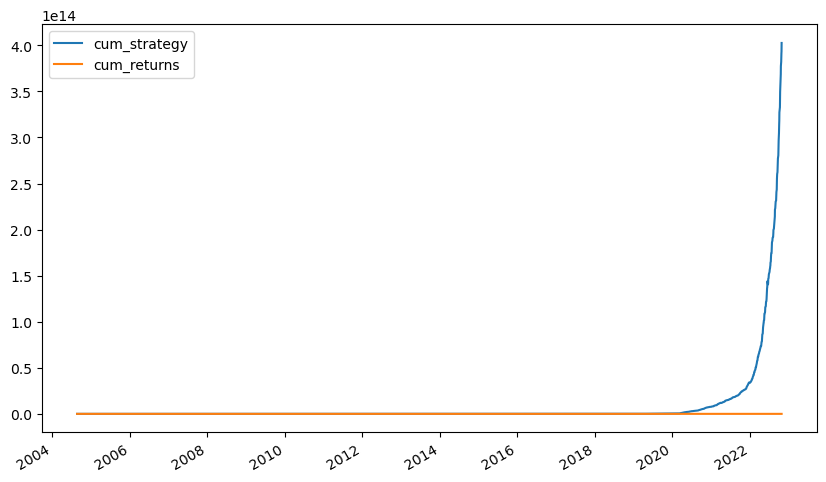

In [206]:
KNN_tuning,KNN_t_p=backtest(KNeighborsClassifier(n_neighbors=4,weights='distance'),'KNN_t')

In [207]:
KNN_t_p

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
KNN_t,12.165315,5.341322,0.055347,2.013160e+20,4.026320e+14


In [208]:
print(accuracy_score(KNN_tuning['signal'].iloc[:-1], KNN_tuning['predicts'].iloc[:-1])
     )
print(classification_report(KNN_tuning['signal'].iloc[:-1], KNN_tuning['predicts'].iloc[:-1])
     )

0.9772524531668153
              precision    recall  f1-score   support

        -1.0       0.96      0.99      0.98      2008
         1.0       0.99      0.96      0.98      2476

    accuracy                           0.98      4484
   macro avg       0.98      0.98      0.98      4484
weighted avg       0.98      0.98      0.98      4484



<AxesSubplot:xlabel='Predicted', ylabel='Actual'>

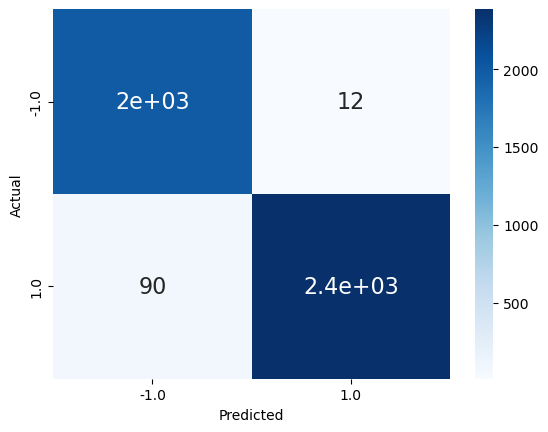

In [209]:
df_cm = pd.DataFrame(confusion_matrix(KNN_tuning['signal'].iloc[:-1], KNN_tuning['predicts'].iloc[:-1]), 
                     columns=np.unique(KNN_tuning['signal'].iloc[:-1]), 
                     index = np.unique(KNN_tuning['signal'].iloc[:-1])
                    )

df_cm.index.name = "Actual"
df_cm.columns.name = "Predicted"

sns.heatmap(df_cm, 
            cmap="Blues", 
            annot=True,
            annot_kws={"size": 16}
           )

<a id="3"></a >
# Part 3 Executive Summary

## SMA/EMA Mean-Reversion Strategy 

In [110]:
index_name = ['SMA Mean Reversion Strategy', 'EMA Mean Reversion Strategy']
pd.DataFrame({'Sharpe Ratio':[SMA_sharpe3, EMA_sharpe2], 
              'CAGR': [SMA_CAGR1, CAGR_EMA2], 
             'Maximum_Drawdown': [max_drawdown_SMA, max_drawdown_EMA], 
             'Total Asset': [total_asset_sma3, total_asset_EMA2]}, 
             index=index_name)

,Sharpe Ratio,CAGR,Maximum_Drawdown,Total Asset
SMA Mean Reversion Strategy,0.136429,0.021715,0.401612,752252.290494
EMA Mean Reversion Strategy,0.034473,0.004222,0.392120,541698.802724


<font size = 3>The table above shows the Sharpe ratio, compound annual growth rate,  maximum drawdown and total asset left in account for the SMA and EMA mean reversion strategy. We could see that the Sharpe ratio for SMA mean reversion strategy is 0.136430 and for EMA mean reversion strategy is 0.034474 respectively. The compound annual growth rate for SMA mean reversion strategy and EMA mean reversion strategy is 0.021715 and 0.004222 respectively. The maximun drawdown for SMA mean reversion strategy and EMA mean reversion strategy is 0.401612 and 0.392121 respecetively. The total asset as follow the SMA mean reversion strategy and EMA mean reversion strategy is 752254.79 and 541699.55 respectively. Compared with the total asset after following the market after 20 years, which is 2648790.77. We could conclude that the SMA and EMA mean reversion strategy do not beat the market. <font>

<font size = 3>Meanwhile, we use the moving window selection process which also shows there is no moving window for the mean reversion strategy that would have higher strategy return than the index return.<font>

<AxesSubplot:xlabel='Date'>

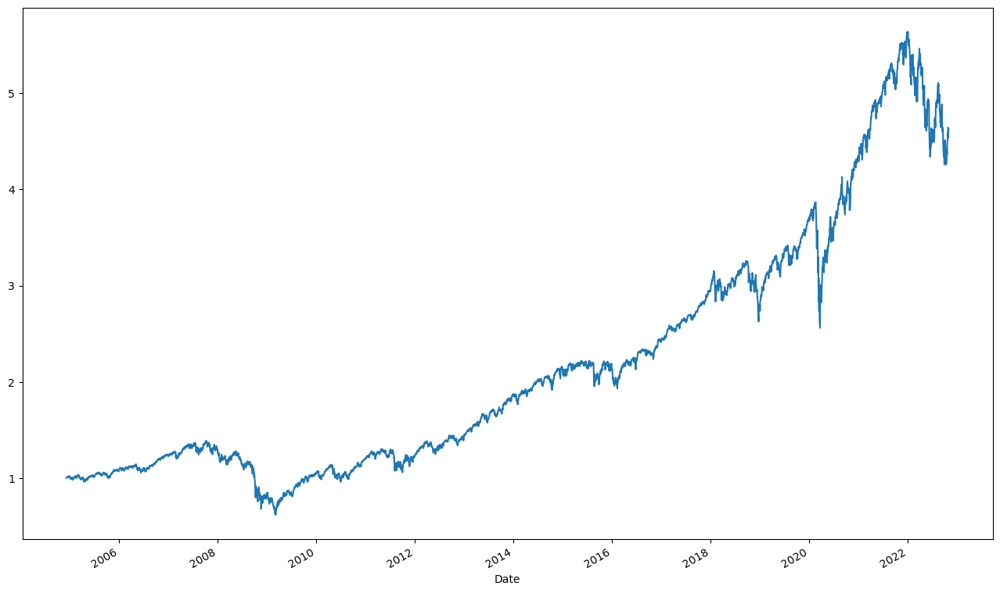

In [111]:
momentum_sma_df['RETURNS'].cumsum().apply(np.exp).plot(figsize = (16, 10))

<font size = 3> According to the figure above, which shows the index return of S&P500 over 20 years. It has obvious upward trend for the index return, and the mean reversion strategy is not sensitive to capture the trading opportunity for the upward trend. Therefore, we could conclude that the mean reversion does not have good performance on the historical price data for S&P500 index. Moreover, we would not recommend to follow the mean reversion strategy for investing the S&P500 index. <font>

## RSI and RSI&MACD Combined

In [135]:
index_name = ['RSI Strategy', 'RSI & MACD Combined Strategy']
pd.DataFrame({'Sharpe Ratio':[RSI_sharpe, sharpe_rsimacd], 
              'CAGR': [RSI_CAGR, RSIMACD_CAGR], 
             'Maximum_Drawdown': [Drawdowns(RSIdf)['Max Drawdown'].loc[513], max_drawdown_rsimacd['Max Drawdown'][0]], 
             'Total Asset': [total_asset_RSI, total_asset_rsimacd]}, 
             index=index_name)

,Sharpe Ratio,CAGR,Maximum_Drawdown,Total Asset
RSI Strategy,0.054707,0.010900,0.299356,114459.315231
RSI & MACD Combined Strategy,-1.029705,-0.143662,0.000000,-473799.911339


<font size = 3>The table above shows the Sharpe ratio, compound annual growth rate, maximum drawdown and total asset left in account for the RSI strategy and RSI and MACD combined strategy. We could see that the Sharpe ratio for RSI strategy is 0.054707 and for RSI and MACD combined strategy is -1.029705 respectively. The compound annual growth rate for RSI strategy and RSI and MACD combined strategy is 0.010900 and -0.143662 respectively. The maximun drawdown for RSI strategy and RSI and MACD combined strategy is 0.299356 and 0 respecetively. The total asset as follow the RSI strategy and RSI and MACD combined strategy is 114459.315231 and -473799.911339 respectively. Compared with the total asset after following the market after 20 years, which is 2648790.77. We could conclude that the RSI strategy and RSI and MACD combined strategy do not beat the market. <font>
    
<font size = 3> As the RSI strategy and RSI and MACD combined strategy also does not have good performance on investing the S&P 500 index. Therefore, we are not going to recommend the RSI strategy and RSI and MACD combined strategy to the investor for investing S&P500. <font>

## MACD Momentum Strategy

<font size = 3>Moving Average Convergence Divergence (MACD) is a trend-following momentum indicator that shows the relationship between two moving averages  a security’s price.

<font size = 3>When the MACD line crosses from below to above the signal line, the indicator is considered bullish. The further below the zero line the stronger the signal. When the MACD line crosses from above to below the signal line, the indicator is considered bearish. The further above the zero line the stronger the signal.

<font size = 3>We built our MACD strategy based on the short and long period of 12 and 26 days respectively. Below is our strategy position graph for MACD.

In [136]:
index_name = ['MACD Strategy']
pd.DataFrame({'Sharpe Ratio': MACD_sharpe, 
              'CAGR': CAGR_MACD, 
             'Maximum_Drawdown': max_drawdown_MACD, 
             'Total Asset': total_asset_MACD}, 
             index=index_name)

,Sharpe Ratio,CAGR,Maximum_Drawdown,Total Asset
MACD Strategy,0.45041,0.050553,0.229069,1.277038e+06


<font size = 3>The table above shows the Sharpe ratio, compound annual growth rate, maximum drawdown and total asset left in account for MACD momentum strategy. We could see that the Sharpe ratio for MACD momentum strategy is 0.45041. The compound annual growth rate for MACD momentum strategy is 0.050553. The maximun drawdown for MACD monmentum strategy is 0.229069. The total asset as follow the MACD momentum strategy is 1277037.76. Compared with the total asset after following the market after 20 years, which is 2648790.77. We could conclude that the MACD momentum strategy do not beat the market.
    
<font size = 3>There are some possible reasons we conclude for the MACD outcome we have:

* MACD can provide false reversals. Sometimes reversal signals shown by MACD divergence dose not means a significant reversal would happen. It could mean that a temporary pause or sideways move is underway before the trend continues. Thus, MACD cannot forecast all reversals. 
* MACD does not often give an accurate analysis of a trend many times. Trend following signals could also fail or provide insignificant move before a trend reversal.

<font size = 3>As the MACD momentum strategy also does not have good performance on investing the S&P 500 index. Therefore, we are not going to recommend the MACD momentum strategy to the investor for investing S&P500.

## Simple Moving Average Momentum Strategy

<font size = 3>For the simple moving average momentum strategy, we use the moving window selection process to select the moving window of the strategy to have the highest cumulative strategy return relative to index return. The moving windows which has the best performance is 277 and 278, however, we think the moving window is not reasonable and could rarely apply in empirical market. Therefore, we also build another SMA momentum strategy with moving window of 198 and 291 respectively which is more reasonable. 

In [143]:
index_name = ['SMA Momentum Strategy(best return)','SMA Momentum Strategy(reasonable)' ]
pd.DataFrame({'Sharpe Ratio': [SMA_sharpe1, SMA_sharpe2], 
              'CAGR': [CAGR_SMA1,CAGR_SMA2], 
             'Maximum_Drawdown': [max_drawdown_sma1,max_drawdown_sma2], 
             'Total Asset': [total_asset_sma1,total_asset_sma2]}, 
             index=index_name)

,Sharpe Ratio,CAGR,Maximum_Drawdown,Total Asset
SMA Momentum Strategy(best return),0.566844,0.109596,0.417121,3.611787e+06
SMA Momentum Strategy(reasonable),0.525670,0.101083,0.395481,3.119770e+06


<font size = 3> The table above shows the Sharpe ratio, compound annual growth rate, maximum drawdown and total asset left in account for SMA momentum strategy. We could see that the Sharpe ratio for SMA momentum strategy is 0.5668 and 0.5257 respectively. The compound annual growth rate for SMA momentum strategy is 0.1096 and 0.1011 respectively. The maximun drawdown for SMA monmentum strategy is 0.4171 and 0.3955 respectively. The total asset as follow the SMA momentum strategy is 3611787.10 and 3119769.51. Compared with the total asset after following the market after 20 years, which is 2648790.77. We could see the SMA momentum strategy with 277 and 278 moving window has better performance, but the another strategy also has great performance and beat the market. 

<AxesSubplot:xlabel='Date'>

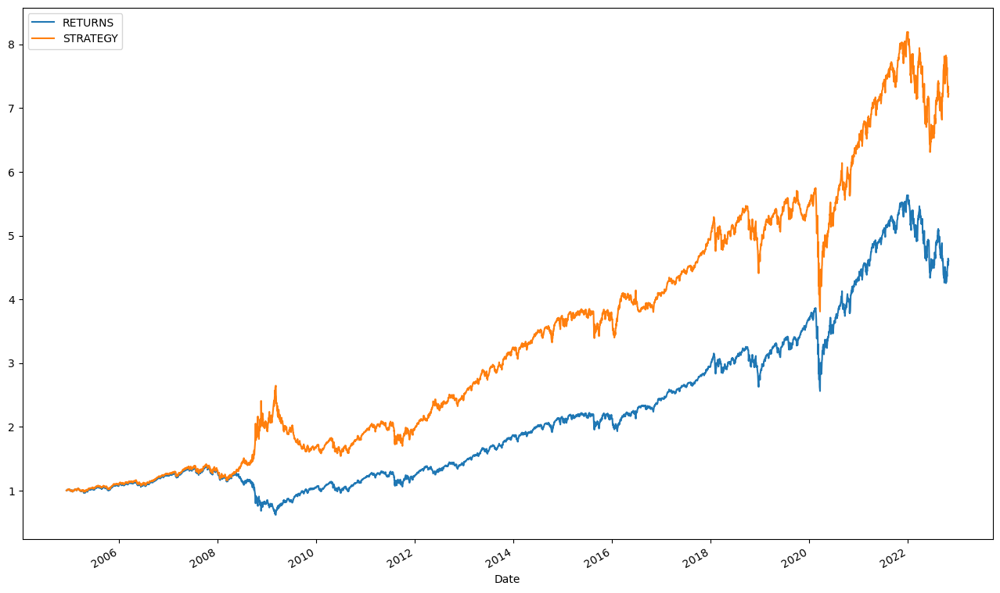

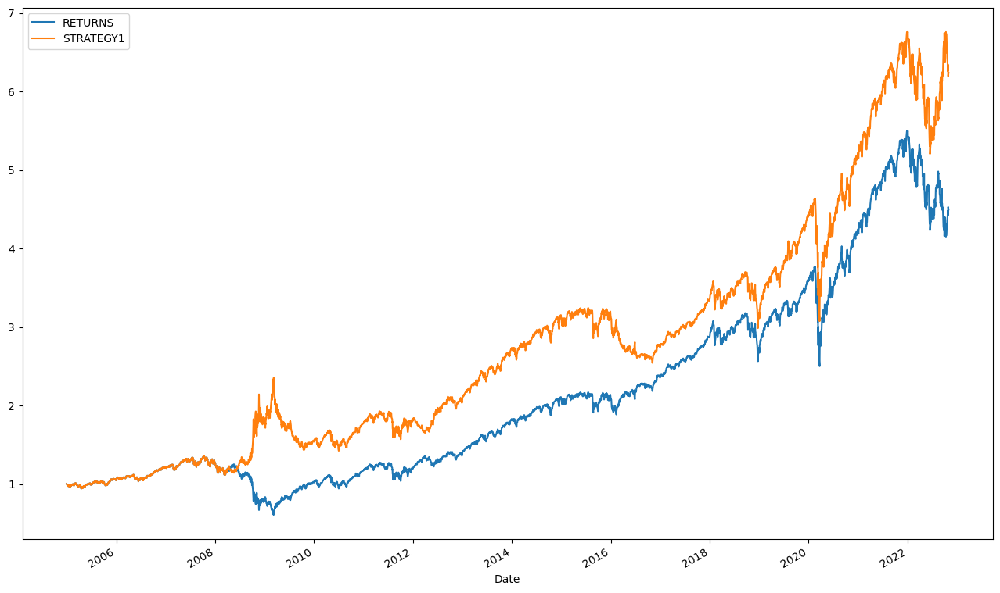

In [148]:
fig = make_subplots(rows = 2, cols = 1)

momentum_sma_df[['RETURNS', 'STRATEGY']].cumsum().apply(np.exp).plot(figsize = (16, 10))
momentum_sma_df1[['RETURNS', 'STRATEGY1']].cumsum().apply(np.exp).plot(figsize = (16, 10))

<font size = 3> The above figures show the cumulative index return and cumulative strategy return for two SMA momentum strategy respectively. We could see that the both strategies have higher cumulative return compare with the index cumulative return and the strategies beat the market. I think the SMA momentum strategy could capture the significant trading opportunity to beat the market as long as we have the appropriate moving window. 
    
<font size = 3> Therefore, we would recommend to the investor to follow the SMA momentum strategy to invest the S&P500 index. However, the results would be varied and depends on the moving window that we selected. 

## EMA Momentum Strategy

<font size = 3>For the exponential moving average momentum strategy, we use the moving window selection process to select the moving window of the strategy to have the highest cumulative strategy return relative to index return. The moving windows which has the best performance is 175 and 278. 

In [141]:
index_name = ['RSI Strategy']
pd.DataFrame({'Sharpe Ratio': EMA_sharpe, 
              'CAGR': CAGR_EMA, 
             'Maximum_Drawdown': max_drawdown_EMA, 
             'Total Asset': total_asset_EMA}, 
             index=index_name)

,Sharpe Ratio,CAGR,Maximum_Drawdown,Total Asset
RSI Strategy,0.562133,0.108639,0.39212,3.552990e+06


<font size = 3> The table above shows the Sharpe ratio, compound annual growth rate, maximum drawdown and total asset left in account for EMA momentum strategy. We could see that the Sharpe ratio for EMA momentum strategy is 0.562133. The compound annual growth rate for EMA momentum strategy is 0.108639. The maximun drawdown for EMA monmentum strategy is 0.39212. The total asset as follow the EMA momentum strategy is 3552989.77. Compared with the total asset after following the market after 20 years, which is 2648790.77. We could see the EMA momentum strategy has great performance and beat the market.

<AxesSubplot:xlabel='Date'>

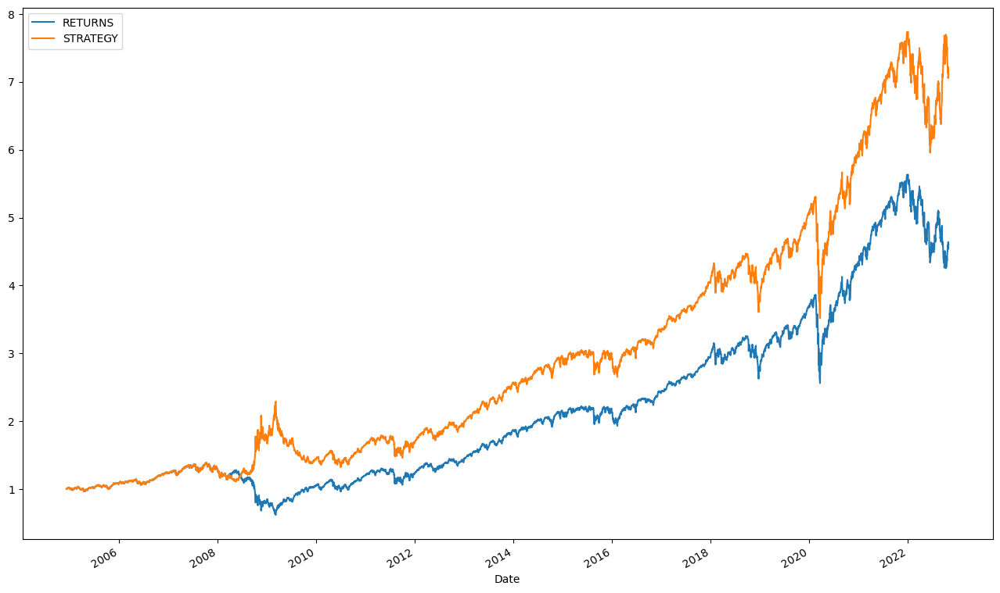

In [149]:
momentum_ema_df[['RETURNS', 'STRATEGY']].cumsum().apply(np.exp).plot(figsize = (16, 10))

<font size = 3> The above figure shows the cumulative index return and cumulative strategy return for EMA momentum strategy. We could see that the strategy have higher cumulative return compare with the index cumulative return and the strategies beat the market. I think the EMA momentum strategy could capture the significant trading opportunity to beat the market as long as we have the appropriate moving window. 
    
<font size = 3> Therefore, we would recommend to the investor to follow the EMA momentum strategy to invest the S&P500 index. However, the results would be varied and depends on the moving window that we selected. 

<font size = 3>Overall, we could conclude that SMA momentum strategy and EMA momentum strategy have the best performance on trading strategy and have the highest asset left in account after follow the strategy in 20 years. 

## Machine Learning 

In [210]:
pd.concat([LR_p, LDA_p,KNN_p, CART_p, NB_p, AB_p, GBM_p, RF_p, KNN_t_p]).sort_values(by='Strategy Return').round(3)


,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
LDA,0.608,0.123,0.482,4.154653e+06,8.309000e+00
LR,0.615,0.124,0.461,4.245969e+06,8.492000e+00
NB,0.687,0.140,0.298,5.457523e+06,1.091500e+01
AB,1.849,0.422,0.307,2.996728e+08,5.993460e+02
KNN,3.324,0.864,0.155,4.175066e+10,8.350132e+04
GBM,5.205,1.577,0.114,1.512352e+13,3.024704e+07
CART,12.165,5.341,0.055,2.013160e+20,4.026320e+14
RF,12.165,5.341,0.055,2.013160e+20,4.026320e+14
KNN_t,12.165,5.341,0.055,2.013160e+20,4.026320e+14


<font size = 3>Our Final choices for the investment strategy of investing S&P500 index are Gaussian Naive Bayes, K-Nearest Neighbors, Decision Tree Classification. 

### KNN

<font size = 3>KNN has the lowest out-of-sample error. Among all of our strategies, it seems that we are supposed to apply this method. From the table above, the Sharpe ratio of KNN is 3.289, CAGR is 0.852, max drawdown id 0.155. Its accuracy score is 0.67. We can say at least its performance is not bad.And we can see our total asset blows up. It is clear that this method face the problem of overfitting. So we need to be careful when applying for this strategy. 

In [212]:
print(classification_report(KNN['signal'].iloc[:-1], KNN['predicts'].iloc[:-1])
     )

              precision    recall  f1-score   support

        -1.0       0.64      0.62      0.63      2008
         1.0       0.70      0.72      0.71      2476

    accuracy                           0.67      4484
   macro avg       0.67      0.67      0.67      4484
weighted avg       0.67      0.67      0.67      4484



<AxesSubplot:xlabel='Predicted', ylabel='Actual'>

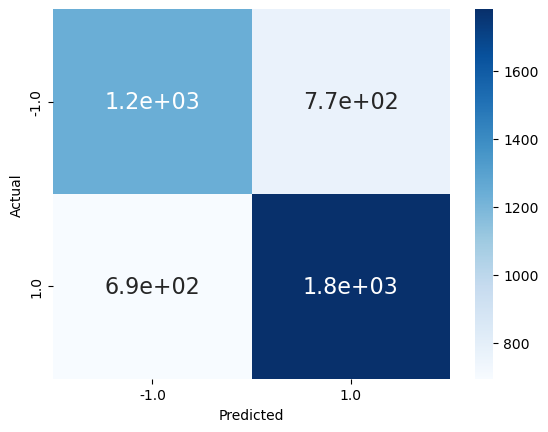

In [213]:
df_cm = pd.DataFrame(confusion_matrix(KNN['signal'].iloc[:-1], KNN['predicts'].iloc[:-1]), 
                     columns=np.unique(KNN['signal'].iloc[:-1]), 
                     index = np.unique(KNN['signal'].iloc[:-1])
                    )

df_cm.index.name = "Actual"
df_cm.columns.name = "Predicted"

sns.heatmap(df_cm, 
            cmap="Blues", 
            annot=True,
            annot_kws={"size": 16}
           )

### NB

NB also has the lowest out-of-sample error.And its in-sample errors is quite close to its out-of-sample errors. So we also choose to report this method.
From the table above, the Sharpe ratio of NB is 0.687, CAGR is 0.140, max drawdown is 0.298. Its accuracy score is 0.55. That makes the strategy less attractive. But this method is very stable and can beat the market (at least in in-sample period). Its accumulative return seems to be very reasonable. So we still recommend this strategy.

In [214]:
print(classification_report(NB['signal'].iloc[:-1], NB['predicts'].iloc[:-1])
     )

              precision    recall  f1-score   support

        -1.0       0.49      0.21      0.29      2008
         1.0       0.56      0.82      0.67      2476

    accuracy                           0.55      4484
   macro avg       0.52      0.52      0.48      4484
weighted avg       0.53      0.55      0.50      4484



<AxesSubplot:xlabel='Predicted', ylabel='Actual'>

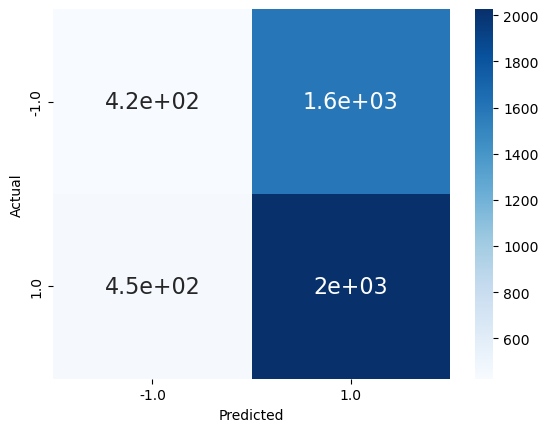

In [215]:
df_cm = pd.DataFrame(confusion_matrix(NB['signal'].iloc[:-1], NB['predicts'].iloc[:-1]), 
                     columns=np.unique(NB['signal'].iloc[:-1]), 
                     index = np.unique(NB['signal'].iloc[:-1])
                    )

df_cm.index.name = "Actual"
df_cm.columns.name = "Predicted"

sns.heatmap(df_cm, 
            cmap="Blues", 
            annot=True,
            annot_kws={"size": 16}
           )

### CART

<font size = 3>CART has the lowest in-sample errors, but did not have a good performance in out-of-sample periods. But our goal is to pursue the largest in-sample returns. We still choose to preserve the result. 
But it is very clear the problem of over-fitting is very serious. So it may not be a good choice in practice. But we can see that its in-sample performance is brilliant. it is always right about the predictions.Its sharpe ratio is 12.165, CAGR is 5.341, max drawdown is 0.055.
everything seems to be perfect. But it is clear that this result is extremely hard to achieve.

In [216]:
print(classification_report(CART['signal'].iloc[:-1], CART['predicts'].iloc[:-1])
     )

              precision    recall  f1-score   support

        -1.0       0.96      0.99      0.98      2008
         1.0       0.99      0.96      0.98      2476

    accuracy                           0.98      4484
   macro avg       0.98      0.98      0.98      4484
weighted avg       0.98      0.98      0.98      4484



<AxesSubplot:xlabel='Predicted', ylabel='Actual'>

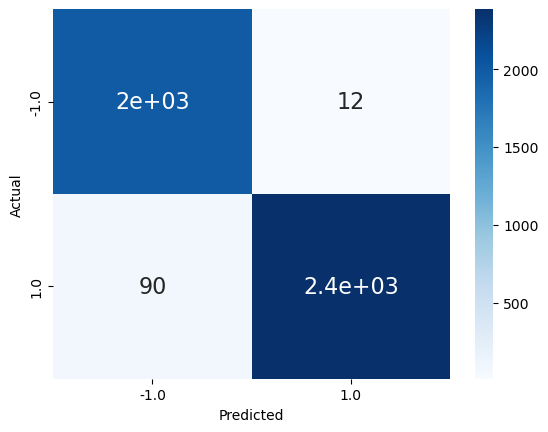

In [217]:
df_cm = pd.DataFrame(confusion_matrix(CART['signal'].iloc[:-1], CART['predicts'].iloc[:-1]), 
                     columns=np.unique(CART['signal'].iloc[:-1]), 
                     index = np.unique(CART['signal'].iloc[:-1])
                    )

df_cm.index.name = "Actual"
df_cm.columns.name = "Predicted"

sns.heatmap(df_cm, 
            cmap="Blues", 
            annot=True,
            annot_kws={"size": 16}
           )

### Our Recommendation 

<font size = 3>Compared to SMA, MACD, RSI and other strategies which only take use of one of two indicators, ML strategies can combine the information of multiple technical indicators. In addition, information from other sources such as the relative stocks and news (although we do not use them in our machine).

<font size = 3>Our machine learning contains the information offered by the technical indicators and the relative asset, so it can generate stronger predict power than any single indicators.

<font size = 3>For the algorithm choosing, though we cannot say that it 100% valid, we have tried our best to identify the stable one. And you can see that at least we get good accumulative return in in-sample period.
Another advantage of our ML (and all ML) is that we can update the features and improve the performance continuously. That’s why we recommend this strategy to you.

<a id="3.1"></a >
## Final Result

<font size = 3> **Overall, the top 3 strategis that would have the highest strategeis cumulative return are Gaussian Naive Bayes, K-Nearest Neighbors, Decision Tree Classification from Machine Learning.**
    
<font size = 3> The strategy cumulative return for Gaussian Naive Bayes is 11.04, the strategy cumulative return for K-Nearest Neighbours is $7.43 * 10 ^4$ and the strategy cumulative return for Decision tree classification is $4.03 * 10^{14}$

<a id="4"></a >
# Contribution Statement 

**Cao Yujie:** Firstly I tried to do machine learning model, and got the results. But my results were not as good as my teammates’.  So I also improved the momentum and mean reversion strategies and found the best return strategies. During the process, I kept discussing to my teammates and gave my opinion. Lastly, I wrote the report and helped to combine the files.

**Lyu Jiaming:** For our project, I have taken part in all three meetings with my groupmates. I have taken part in developing the simple momentum strategy, time-series momentum strategy and mean-reversion strategy for the group. Among all the strategies we have in our group, we chose the most reasonable and suitable ones for our project. Apart from helping to develop our strategies, I have also helped in developing our report for the Simple Momentum, EMA, MACD and EMA/Simple Mean-Reversion Strategies. I analyzed the codes from my group members and explained the performance metrics from each strategy. Also, I have helped in building a ‘BEST SEARCH’ model to find the parameters for the strategies I mentioned above to beat the market.  Also, I have helped improve our group trading strategy by correcting the market benchmark by adjusting the date from the first day of the trading period. Before that, our market benchmark is calculated based on the date after dropped NA because of the moving average function. Moreover, I have also helped develop the possible reasons for our several strategies not beating the market benchmark. After that, I also joined in discussions about the Machine Learning parts to have a better understanding on how the machine learning strategies generate highest returns among all the strategies in our project. 

**Wang Hairuo** For the project, I take responsibility for building the momentum and mean reversion strategies, such as SMA momentum strategies, EMA momentum strategies, MACD momentum strategies, SMA mean-reversion strategeis and EMA mean-reversion strategies. As well, I take responsibility for the backtesting of the momentum and mean reversion strategies as I mentioned above. For the report part, I assist my team members to summarize the code and explaination from machine learning part and I also work with team member together to finish the explaination of momentum strategies and mean-reversion strategies. As well, I also joined the four discussion meeting about the final project.

**Stanley Wong Hung Yee** Stanley made contribution in the group project by building Machine Learning with Regressors models and build trading strategies. He also provided his code for RSI and MACD indicators as a comparison for momentum trading strategies.
He made explained the implementation of macine learning regression models and ran trading strategies with backtesting for the result performance.

**Wu Qingyuan** I participate in all of the four group meetings and  communicate with other members about how to build our strategy. In coding part, I mainly contributed to the strategy building by using supervised learning, and help to solve the problems we met in momentum and mean-reverting strategies. I also finish the report of ML part.

**Chen Yibing** For the project, I help to research how to build strategies and backtesting and about the price trend of S&P500 index. 

<a id="5"></a >
# Appendix

In [219]:
# Our standardized printing options

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib as mpl

np.set_printoptions(precision = 3)

pd.set_option("display.float_format", lambda x: "%.3f" % x)

plt.style.use("ggplot")

mpl.rcParams["axes.grid"] = True
mpl.rcParams["grid.color"] = "grey"
mpl.rcParams["grid.alpha"] = 0.25

mpl.rcParams["axes.facecolor"] = "white"

mpl.rcParams["legend.fontsize"] = 14

In [218]:
from pandas_datareader import data as pdr
from sklearn.preprocessing import StandardScaler
import datetime as dt
import yfinance as yf

In [220]:
import numpy as np
import pandas as pd

import scipy as sp

import matplotlib.pyplot as plt
import matplotlib as mpl

from pandas_datareader import data as pdr
import datetime as dt
import yfinance as yf

# ML BENCHMARKING
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import RepeatedKFold
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet

from sklearn.tree import DecisionTreeRegressor

from sklearn.neighbors import KNeighborsRegressor

from sklearn.svm import SVR

# Bagging -> Bootstrap Aggregation
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import RandomForestRegressor

#Step 3 fitting of algorithm
# Boosting -> Gradient Descent is an element of Gradient Boosting Regression - XGB & Random Forest
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import AdaBoostRegressor

# Neural Network -> Multi-Level-Perceptron
from sklearn.neural_network import MLPRegressor

#Step 1 Fitting
from sklearn.model_selection import train_test_split
#Cross-validation
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
#Grid-search for Hyperparameter Tuning
from sklearn.model_selection import GridSearchCV

#Step 4&5
from sklearn.metrics import mean_squared_error

from sklearn.feature_selection import chi2, f_regression
from sklearn.feature_selection import SelectKBest

import statsmodels.tsa.arima.model as stats
import statsmodels.api as sm

#EDA Tool Kits
from pandas.plotting import scatter_matrix
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf

import plotly.graph_objects as go
from plotly.subplots import make_subplots
pd.options.mode.chained_assignment = None  # default='warn'

import warnings
warnings.filterwarnings("ignore")

# warnings.filterwarnings(action = "once")

# Machine Learning Benchmark Test

In [221]:
stock_list = ["MSFT", "IBM", "AAPL"] 
currency_ticker = ["DEXJPUS", "DEXUSUK","DEXUSEU"] #USD/JPY, USD/GBP, USD/EUR
index_ticker = ["SPY", "^DJI", "^VIX","^IXIC"] #S&P500, Dow Jones, VIX, Nasdaq
comm_ticker = ["GC=F"] #Gold COMEX

stock_data = pdr.get_data_yahoo(stock_list,
                                start = dt.datetime(2003, 11, 1),
                                end = dt.datetime(2022, 10, 31)
                               ).dropna()
 
currency_data = pdr.get_data_fred(currency_ticker,
                                start = dt.datetime(2003, 11, 1),
                                end = dt.datetime(2022, 10, 31)
                               )

index_data = pdr.get_data_yahoo(index_ticker,
                                start = dt.datetime(2003, 11, 1),
                                end = dt.datetime(2022, 10, 31)
                               ).dropna()

comm_data = pdr.get_data_yahoo(comm_ticker,
                                start = dt.datetime(2003, 11, 1),
                                end = dt.datetime(2022, 10, 31)
                               )["Adj Close"].dropna()

We selected a few asset class that has higher correlation to SPY as a good input feature to be used for machine learning prediction. The most important part about feature engineering is ensuring data in input feature has no NaN, infinite or negative infinite values.

### Check for inf or nan data

In [222]:
comm_data

Symbols,GC=F
Date,
2003-10-31,384.500
2003-11-03,377.000
2003-11-04,379.900
2003-11-05,382.600
2003-11-06,380.600
...,...
2022-10-25,1652.800
2022-10-26,1664.000
2022-10-27,1660.700


In [223]:
comm_data.isnull().sum()

Symbols
GC=F    0
dtype: int64

In [224]:
np.isinf(comm_data).any()

Symbols
GC=F    False
dtype: bool

In [225]:
stock_data

Attributes Adj Close                   Close                    High          \
Symbols         MSFT     IBM    AAPL    MSFT     IBM    AAPL    MSFT     IBM   
Date                                                                           
2003-10-31    16.494  50.545   0.348  26.140  85.545   0.409  26.440  86.721   
2003-11-03    16.835  50.658   0.352  26.680  85.736   0.413  26.750  86.845   
2003-11-04    16.450  50.352   0.349  26.070  85.220   0.409  26.620  85.851   
2003-11-05    16.469  49.985   0.351  26.100  84.598   0.411  26.320  84.971   
2003-11-06    16.551  50.557   0.352  26.230  85.411   0.413  26.300  85.650   
...              ...     ...     ...     ...     ...     ...     ...     ...   
2022-10-25   249.956 131.364 152.088 250.660 132.930 152.340 251.040 133.300   
2022-10-26   230.670 133.419 149.103 231.320 135.010 149.350 238.300 135.860   
2022-10-27   226.113 133.182 144.560 226.750 134.770 144.800 233.690 136.400   
2022-10-28   235.207 136.878 155.482 235.870 138.510 155.740 236.600 138.860   
2022-10-31   231.478 136.661 153.086 232.130 138.290 153.340 234.920 138.770   

Attributes             Low                    Open                  \
Symbols       AAPL    MSFT     IBM    AAPL    MSFT     IBM    AAPL   
Date                                                                 
2003-10-31   0.417  26.110  85.277   0.407  26.370  86.721   0.416   
2003-11-03   0.416  26.290  85.545   0.407  26.350  85.946   0.408   
2003-11-04   0.412  26.010  84.952   0.403  26.590  85.736   0.412   
2003-11-05   0.413  26.000  84.130   0.401  26.150  84.627   0.407   
2003-11-06   0.413  26.000  83.862   0.404  26.260  84.446   0.409   
...            ...     ...     ...     ...     ...     ...     ...   
2022-10-25 152.490 245.830 131.300 149.360 247.260 132.000 150.090   
2022-10-26 151.990 230.060 132.810 148.040 231.170 133.720 150.960   
2022-10-27 149.050 225.780 134.450 144.130 231.040 135.550 148.070   
2022-10-28 157.500 226.050 135.220 147.820 226.240 135.560 148.200   
2022-10-31 154.240 231.150 136.600 151.920 233.760 138.060 153.160   

Attributes       Volume                            
Symbols            MSFT         IBM          AAPL  
Date                                               
2003-10-31 69623700.000 5058665.000 218153600.000  
2003-11-03 57772300.000 6093159.000 302842400.000  
2003-11-04 84026100.000 5382821.000 249233600.000  
2003-11-05 61514400.000 6585930.000 322470400.000  
2003-11-06 68189800.000 5929356.000 397073600.000  
...                 ...         ...           ...  
2022-10-25 34775500.000 5957600.000  74732300.000  
2022-10-26 82543200.000 5139000.000  88194300.000  
2022-10-27 40424600.000 3993200.000 109180200.000  
2022-10-28 40647700.000 5965500.000 164762400.000  
2022-10-31 28357300.000 4915300.000  97943200.000  

[4783 rows x 18 columns]

In [226]:
stock_data.isnull().sum()

Attributes  Symbols
Adj Close   MSFT       0
            IBM        0
            AAPL       0
Close       MSFT       0
            IBM        0
            AAPL       0
High        MSFT       0
            IBM        0
            AAPL       0
Low         MSFT       0
            IBM        0
            AAPL       0
Open        MSFT       0
            IBM        0
            AAPL       0
Volume      MSFT       0
            IBM        0
            AAPL       0
dtype: int64

In [227]:
currency_data

,DEXJPUS,DEXUSUK,DEXUSEU
DATE,,,
2003-11-03,111.200,1.679,1.145
2003-11-04,109.600,1.680,1.150
2003-11-05,109.910,1.678,1.147
2003-11-06,110.150,1.669,1.142
2003-11-07,109.290,1.671,1.151
...,...,...,...
2022-10-25,147.850,1.147,0.996
2022-10-26,146.500,1.161,1.007
2022-10-27,146.020,1.157,0.999


In [228]:
currency_data.isnull().sum()

DEXJPUS    193
DEXUSUK    193
DEXUSEU    193
dtype: int64

In [229]:
currency_data.ffill(inplace=True)

In [230]:
currency_data.isnull().sum()

DEXJPUS    0
DEXUSUK    0
DEXUSEU    0
dtype: int64

In [231]:
np.isinf(currency_data).any()

DEXJPUS    False
DEXUSUK    False
DEXUSEU    False
dtype: bool

In [232]:
index_data

Attributes Adj Close                              Close                   \
Symbols          SPY      ^DJI   ^VIX     ^IXIC     SPY      ^DJI   ^VIX   
Date                                                                       
2003-10-31    72.903  9801.120 16.100  1932.210 105.300  9801.120 16.100   
2003-11-03    73.381  9858.460 16.550  1967.700 105.990  9858.460 16.550   
2003-11-04    73.222  9838.830 16.550  1957.970 105.760  9838.830 16.550   
2003-11-05    73.277  9820.830 16.860  1959.370 105.840  9820.830 16.860   
2003-11-06    73.665  9856.970 16.740  1976.370 106.400  9856.970 16.740   
...              ...       ...    ...       ...     ...       ...    ...   
2022-10-25   384.920 31836.740 28.460 11199.120 384.920 31836.740 28.460   
2022-10-26   382.020 31839.109 27.280 10970.990 382.020 31839.109 27.280   
2022-10-27   379.980 32033.279 27.390 10792.670 379.980 32033.279 27.390   
2022-10-28   389.020 32861.801 25.750 11102.450 389.020 32861.801 25.750   
2022-10-31   386.210 32732.949 25.880 10988.150 386.210 32732.949 25.880   

Attributes              High            ...    Low              Open  \
Symbols        ^IXIC     SPY      ^DJI  ...   ^VIX     ^IXIC     SPY   
Date                                    ...                            
2003-10-31  1932.210 105.740  9839.860  ... 15.790  1928.670 105.400   
2003-11-03  1967.700 106.610  9896.160  ... 16.220  1941.310 105.750   
2003-11-04  1957.970 106.270  9874.830  ... 16.450  1953.640 105.990   
2003-11-05  1959.370 105.970  9859.340  ... 16.550  1938.220 105.490   
2003-11-06  1976.370 106.440  9870.600  ... 16.620  1953.340 105.600   
...              ...     ...       ...  ...    ...       ...     ...   
2022-10-25 11199.120 385.250 31876.150  ... 28.220 10996.970 378.790   
2022-10-26 10970.990 387.580 32172.420  ... 27.270 10948.380 381.620   
2022-10-27 10792.670 385.000 32388.420  ... 26.940 10780.500 383.070   
2022-10-28 11102.450 389.520 32889.809  ... 25.750 10766.200 379.870   
2022-10-31 10988.150 388.400 32883.859  ... 25.840 10914.010 386.440   

Attributes                                   Volume                      \
Symbols         ^DJI   ^VIX     ^IXIC           SPY          ^DJI  ^VIX   
Date                                                                      
2003-10-31  9786.750 16.110  1938.220  25761600.000 199610000.000 0.000   
2003-11-03  9802.460 16.330  1941.310  37589300.000 190630000.000 0.000   
2003-11-04  9857.490 16.570  1961.450  31421600.000 197300000.000 0.000   
2003-11-05  9837.640 16.990  1957.000  33558800.000 178470000.000 0.000   
2003-11-06  9820.680 17.000  1971.270  28392300.000 183020000.000 0.000   
...              ...    ...       ...           ...           ...   ...   
2022-10-25 31463.650 29.800 10996.970  78846300.000 336930000.000 0.000   
2022-10-26 31738.439 28.440 10969.020 104087300.000 430400000.000 0.000   
2022-10-27 32062.141 27.510 10971.950  81971800.000 375720000.000 0.000   
2022-10-28 32204.311 27.430 10766.200 100302000.000 495830000.000 0.000   
2022-10-31 32754.270 26.910 11028.430  96631300.000 390890000.000 0.000   

Attributes                 
Symbols             ^IXIC  
Date                       
2003-10-31 1833200000.000  
2003-11-03 2089430000.000  
2003-11-04 2081990000.000  
2003-11-05 2018140000.000  
2003-11-06 2141830000.000  
...                   ...  
2022-10-25 5141760000.000  
2022-10-26 5224440000.000  
2022-10-27 4773520000.000  
2022-10-28 4731940000.000  
2022-10-31 4753740000.000  

[4783 rows x 24 columns]

In [233]:
index_data.isnull().sum()

Attributes  Symbols
Adj Close   SPY        0
            ^DJI       0
            ^VIX       0
            ^IXIC      0
Close       SPY        0
            ^DJI       0
            ^VIX       0
            ^IXIC      0
High        SPY        0
            ^DJI       0
            ^VIX       0
            ^IXIC      0
Low         SPY        0
            ^DJI       0
            ^VIX       0
            ^IXIC      0
Open        SPY        0
            ^DJI       0
            ^VIX       0
            ^IXIC      0
Volume      SPY        0
            ^DJI       0
            ^VIX       0
            ^IXIC      0
dtype: int64

In [234]:
np.isinf(index_data).any()

Attributes  Symbols
Adj Close   SPY        False
            ^DJI       False
            ^VIX       False
            ^IXIC      False
Close       SPY        False
            ^DJI       False
            ^VIX       False
            ^IXIC      False
High        SPY        False
            ^DJI       False
            ^VIX       False
            ^IXIC      False
Low         SPY        False
            ^DJI       False
            ^VIX       False
            ^IXIC      False
Open        SPY        False
            ^DJI       False
            ^VIX       False
            ^IXIC      False
Volume      SPY        False
            ^DJI       False
            ^VIX       False
            ^IXIC      False
dtype: bool

In [235]:
SPY = pd.DataFrame(index_data.loc[:, [("Close", "SPY"),("Low", "SPY"),("High","SPY")]])
SPY.columns = SPY.columns.droplevel()
SPY.columns = ['Close','Low','High']
SPY

,Close,Low,High
Date,,,
2003-10-31,105.300,105.220,105.740
2003-11-03,105.990,105.710,106.610
2003-11-04,105.760,105.580,106.270
2003-11-05,105.840,104.900,105.970
2003-11-06,106.400,105.100,106.440
...,...,...,...
2022-10-25,384.920,378.670,385.250
2022-10-26,382.020,381.350,387.580
2022-10-27,379.980,379.330,385.000


In [236]:
SPY["Return"] = np.log(SPY.iloc[:,0] / SPY.iloc[:,0].shift(1)
                           )

In [237]:
SPY.dropna()

,Close,Low,High,Return
Date,,,,
2003-11-03,105.990,105.710,106.610,0.007
2003-11-04,105.760,105.580,106.270,-0.002
2003-11-05,105.840,104.900,105.970,0.001
2003-11-06,106.400,105.100,106.440,0.005
2003-11-07,105.610,105.570,106.720,-0.007
...,...,...,...,...
2022-10-25,384.920,378.670,385.250,0.016
2022-10-26,382.020,381.350,387.580,-0.008
2022-10-27,379.980,379.330,385.000,-0.005


In [238]:
SPY["Direction"] = np.where(SPY.loc[:,"Return"] > 0, 1, 0)

In [239]:
SPY

,Close,Low,High,Return,Direction
Date,,,,,
2003-10-31,105.300,105.220,105.740,NaN,0
2003-11-03,105.990,105.710,106.610,0.007,1
2003-11-04,105.760,105.580,106.270,-0.002,0
2003-11-05,105.840,104.900,105.970,0.001,1
2003-11-06,106.400,105.100,106.440,0.005,1
...,...,...,...,...,...
2022-10-25,384.920,378.670,385.250,0.016,1
2022-10-26,382.020,381.350,387.580,-0.008,0
2022-10-27,379.980,379.330,385.000,-0.005,0


### Technical Indicators

In [240]:
def MA(df, n):
    MA = pd.Series(df["Close"].rolling(n,
                                       min_periods = n).mean(),
                   name = "MA_" + str(n)
                  )
    return MA

def EMA(df, n):
    EMA = pd.Series(df["Close"].ewm(span = n,
                                    min_periods = n).mean(),
                    name = "EMA_" + str(n)
                    )
    return EMA

def ROC(df, n):
    M = df.diff(n - 1)
    N = df.shift(n - 1)
    ROC = pd.Series((M / N) * 100, 
                    name = "ROC_" + str(n)    
                    )
    return ROC

def RSI(series, period):
    
    delta = series.diff().dropna()
    
    u = delta * 0
    d = u.copy()
    
    u[delta > 0] = delta[delta > 0]
    d[delta < 0] = -delta[delta < 0]
    
    u.loc[period - 1] = np.mean( u[:period] ) # 
    
    u = u.drop(u.index[:(period - 1)
                      ]
              )
    
    d.loc[period - 1] = np.mean( d[:period] )
    
    d = d.drop(d.index[:(period - 1)
                      ]
              )
    
    rs = u.ewm(com = period - 1, adjust = False).mean() / \
         d.ewm(com = period - 1, adjust = False).mean()
    
    return 100 - 100 / (1 + rs)

def STOK(close, low, high, n):
    STOK = ((close - low.rolling(n).min()) / \
            (high.rolling(n).max() - low.rolling(n).min()
            )
           ) * 100
    return STOK

def STOD(close, low, high, n):
    STOK = ((close - low.rolling(n).min()) / \
            (high.rolling(n).max() - low.rolling(n).min()
            )
           ) * 100
    
    STOD = STOK.rolling(3).mean()
    return STOD

In [241]:
SPY["SMA_21"] = MA(SPY,21)
SPY["SMA_63"] = MA(SPY,63)
SPY["SMA_252"] = MA(SPY,252)
SPY["EMA_10"] = EMA(SPY,10)
SPY["EMA_30"] = EMA(SPY,30)
SPY["EMA_200"] = EMA(SPY,200)
SPY["ROC10"] = ROC(SPY["Close"], 10)
SPY["ROC30"] = ROC(SPY["Close"], 30)
SPY["RSI10"] = RSI(SPY["Close"], 10)
SPY["RSI30"] = RSI(SPY["Close"], 30)
SPY["RSI200"] = RSI(SPY["Close"], 200)
SPY["%K10"] = STOK(SPY["Close"], SPY["Low"], SPY["High"], 10)
SPY["%D10"] = STOD(SPY["Close"], SPY["Low"], SPY["High"], 10)
SPY["%K30"] = STOK(SPY["Close"], SPY["Low"], SPY["High"], 30)
SPY["%D30"] = STOD(SPY["Close"], SPY["Low"], SPY["High"], 30)
SPY["%K200"] = STOK(SPY["Close"], SPY["Low"], SPY["High"], 200)
SPY["%D200"] = STOD(SPY["Close"], SPY["Low"], SPY["High"], 200)

SPY

,Close,Low,High,Return,Direction,SMA_21,SMA_63,SMA_252,EMA_10,EMA_30,...,ROC30,RSI10,RSI30,RSI200,%K10,%D10,%K30,%D30,%K200,%D200
Date,,,,,,,,,,,,,,,,,,,,,
2003-10-31,105.300,105.220,105.740,NaN,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2003-11-03,105.990,105.710,106.610,0.007,1,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2003-11-04,105.760,105.580,106.270,-0.002,0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2003-11-05,105.840,104.900,105.970,0.001,1,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2003-11-06,106.400,105.100,106.440,0.005,1,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-25,384.920,378.670,385.250,0.016,1,367.590,392.068,422.829,372.344,374.871,...,-2.453,63.101,50.659,48.828,99.112,97.048,76.544,57.877,29.427,24.982
2022-10-26,382.020,381.350,387.580,-0.008,0,368.478,391.686,422.536,374.103,375.332,...,-2.076,59.644,49.696,48.661,85.913,93.767,70.867,67.783,27.108,27.042
2022-10-27,379.980,379.330,385.000,-0.005,0,368.928,391.178,422.242,375.172,375.632,...,-1.447,57.195,49.017,48.543,75.180,86.735,77.354,74.922,25.478,27.338


### Outcome (Y)

In [242]:
return_period = 5

In [243]:
Y = np.log(index_data.loc[:, ("Adj Close","SPY")]).diff(return_period).shift(-return_period)
Y.name = Y.name[-1]+"_pred"

We select 5 days accumulated returns to train the models for better explaination of the prediction

### Input Feature (X)

In [244]:
X1 = np.log(index_data.loc[:, ("Adj Close", ("^DJI","^VIX","^IXIC")
                              )
                          ]
            ).diff(return_period)
X1.columns = X1.columns.droplevel()

X2 = np.log(currency_data).diff(return_period)
X3 = np.log(stock_data).diff(return_period)
X4 = np.log(comm_data).diff(return_period)

X5 = pd.concat([np.log(index_data.loc[:, ("Adj Close", "SPY")
                                     ]
                      ).diff(i) for i in [return_period, return_period * 3, return_period * 6, return_period * 12
                                         ]
               ], axis = 1
              ).dropna()

X5.columns = ["SPY_DT", "SPY_3DT", "SPY_6DT", "SPY_12DT"]

# #X5 is the list of technical indicator columns as per the question. Change accordingly when required!
X6 = np.log(SPY.loc[:,'SMA_21':]).dropna()

X = pd.concat([X1, X2, X3, X4, X5, X6], axis = 1)

In [245]:
data = pd.concat([Y, X], axis = 1).dropna().iloc[ : :return_period, :]
Y = data.loc[:, Y.name]
X = data.loc[:, X.columns]
data

,SPY_pred,^DJI,^VIX,^IXIC,DEXJPUS,DEXUSUK,DEXUSEU,"(Adj Close, MSFT)","(Adj Close, IBM)","(Adj Close, AAPL)",...,ROC30,RSI10,RSI30,RSI200,%K10,%D10,%K30,%D30,%K200,%D200
2004-11-01,0.031,0.031,-0.019,0.034,-0.002,-0.004,-0.003,0.016,0.019,0.098,...,-0.720,4.130,3.998,2.993,4.529,4.516,4.357,4.308,4.200,4.170
2004-11-08,0.017,0.033,-0.165,0.030,-0.008,0.013,0.015,0.042,0.037,0.036,...,1.656,4.342,4.127,3.165,4.534,4.562,4.539,4.563,4.556,4.564
2004-11-15,-0.006,0.015,-0.031,0.027,-0.000,-0.005,0.001,0.042,0.027,0.016,...,1.445,4.387,4.171,3.236,4.557,4.560,4.577,4.578,4.583,4.585
2004-11-22,-0.001,-0.006,-0.031,-0.004,-0.022,0.006,0.008,-0.027,-0.008,0.105,...,1.578,4.133,4.102,3.260,3.937,4.008,4.479,4.487,4.508,4.514
2004-12-02,-0.001,0.006,0.020,0.019,0.002,0.022,0.008,0.017,0.003,0.018,...,1.984,4.231,4.138,3.319,4.394,4.252,4.552,4.534,4.564,4.550
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-04-01,-0.012,-0.001,-0.058,0.006,0.005,-0.006,0.005,0.019,-0.009,-0.002,...,1.460,4.066,3.967,3.968,4.047,4.217,4.409,4.444,4.110,4.145
2022-07-27,0.033,0.010,-0.027,0.011,-0.006,0.003,-0.011,0.024,-0.000,0.024,...,1.983,4.152,3.941,3.901,4.546,4.409,4.559,4.458,3.496,3.353
2022-08-03,0.013,0.019,-0.057,0.051,-0.023,0.009,0.004,0.050,0.025,0.058,...,2.370,4.251,4.017,3.917,4.556,4.474,4.578,4.535,3.793,3.726
2022-08-10,0.016,0.015,-0.106,0.015,-0.012,0.009,0.019,0.023,0.006,0.020,...,2.344,4.280,4.047,3.924,4.598,4.446,4.602,4.523,3.893,3.799


In [246]:
data.describe()

,SPY_pred,^DJI,^VIX,^IXIC,DEXJPUS,DEXUSUK,DEXUSEU,"(Adj Close, MSFT)","(Adj Close, IBM)","(Adj Close, AAPL)",...,ROC30,RSI10,RSI30,RSI200,%K10,%D10,%K30,%D30,%K200,%D200
count,451.000,451.000,451.000,451.000,451.000,451.000,451.000,451.000,451.000,451.000,...,451.000,451.000,451.000,451.000,451.000,451.000,451.000,451.000,451.000,451.000
mean,0.001,0.010,-0.038,0.012,0.001,0.002,0.001,0.011,0.009,0.019,...,1.160,4.173,4.080,3.957,4.370,4.354,4.481,4.462,4.450,4.441
std,0.017,0.014,0.102,0.017,0.012,0.013,0.011,0.028,0.026,0.037,...,0.858,0.116,0.078,0.120,0.273,0.252,0.135,0.163,0.263,0.272
min,-0.118,-0.049,-0.461,-0.038,-0.040,-0.111,-0.034,-0.128,-0.123,-0.125,...,-2.545,3.765,3.850,2.993,2.897,2.785,3.748,3.098,3.048,3.125
25%,-0.006,0.002,-0.095,0.002,-0.006,-0.006,-0.006,-0.004,-0.005,-0.004,...,0.740,4.108,4.031,3.935,4.296,4.269,4.435,4.426,4.460,4.415
50%,0.002,0.008,-0.035,0.011,0.002,0.002,0.001,0.011,0.009,0.017,...,1.321,4.180,4.084,3.981,4.466,4.448,4.527,4.517,4.561,4.558
75%,0.011,0.016,0.028,0.021,0.008,0.009,0.008,0.026,0.022,0.037,...,1.689,4.249,4.129,4.017,4.551,4.523,4.576,4.560,4.591,4.587
max,0.056,0.080,0.211,0.078,0.049,0.048,0.033,0.142,0.136,0.162,...,3.303,4.456,4.368,4.128,4.605,4.595,4.605,4.600,4.605,4.604


In [247]:
data["ROC10"].min()

-inf

In [248]:
np.isinf(data).sum()

SPY_pred             0
^DJI                 0
^VIX                 0
^IXIC                0
DEXJPUS              0
DEXUSUK              0
DEXUSEU              0
(Adj Close, MSFT)    0
(Adj Close, IBM)     0
(Adj Close, AAPL)    0
(Close, MSFT)        0
(Close, IBM)         0
(Close, AAPL)        0
(High, MSFT)         0
(High, IBM)          0
(High, AAPL)         0
(Low, MSFT)          0
(Low, IBM)           0
(Low, AAPL)          0
(Open, MSFT)         0
(Open, IBM)          0
(Open, AAPL)         0
(Volume, MSFT)       0
(Volume, IBM)        0
(Volume, AAPL)       0
GC=F                 0
SPY_DT               0
SPY_3DT              0
SPY_6DT              0
SPY_12DT             0
SMA_21               0
SMA_63               0
SMA_252              0
EMA_10               0
EMA_30               0
EMA_200              0
ROC10                1
ROC30                0
RSI10                0
RSI30                0
RSI200               0
%K10                 0
%D10                 0
%K30       

In [249]:
np.nan_to_num(data["ROC10"], neginf = 0, copy = False)

array([ 9.168e-01,  1.608e+00,  1.518e+00, -6.066e-02, -6.994e-01,
        2.548e-01, -1.645e+00, -2.083e+00, -6.188e-01,  0.000e+00,
       -2.494e+00, -4.990e-01,  9.838e-02,  1.083e+00, -1.528e+00,
       -1.208e+00,  2.631e-01,  5.631e-01,  1.086e+00, -2.967e-01,
       -2.619e-01,  8.234e-01,  1.243e+00,  1.083e+00,  7.285e-01,
        7.196e-01, -4.277e-01, -1.232e-01, -2.389e-01,  1.006e+00,
       -8.953e-01,  2.413e-02,  8.808e-01,  7.904e-02,  8.566e-01,
       -3.686e-01,  2.174e-01, -1.114e+00,  1.485e-01,  1.038e+00,
        1.141e+00, -2.123e-02,  3.559e-01,  7.317e-01, -8.727e-03,
       -1.625e-01, -3.913e-03,  2.819e-02, -4.440e-01,  1.345e-01,
        9.927e-02,  7.179e-01, -1.295e-01, -1.631e+00,  1.034e+00,
        4.229e-01, -4.938e-01, -4.758e-02, -3.649e-01, -5.530e-02,
        2.040e-01,  5.346e-01,  2.856e-01, -4.984e-01,  1.815e-01,
        1.161e+00,  8.695e-01, -2.036e-01,  6.474e-01,  2.240e-01,
        1.718e-01,  1.036e-01, -3.538e-01,  9.808e-01,  3.120e

In [250]:
data.max()

SPY_pred            0.056
^DJI                0.080
^VIX                0.211
^IXIC               0.078
DEXJPUS             0.049
DEXUSUK             0.048
DEXUSEU             0.033
(Adj Close, MSFT)   0.142
(Adj Close, IBM)    0.136
(Adj Close, AAPL)   0.162
(Close, MSFT)       0.142
(Close, IBM)        0.136
(Close, AAPL)       0.162
(High, MSFT)        0.139
(High, IBM)         0.148
(High, AAPL)        0.159
(Low, MSFT)         0.134
(Low, IBM)          0.141
(Low, AAPL)         0.150
(Open, MSFT)        0.146
(Open, IBM)         0.137
(Open, AAPL)        0.145
(Volume, MSFT)      1.946
(Volume, IBM)       1.545
(Volume, AAPL)      1.921
GC=F                0.061
SPY_DT              0.071
SPY_3DT             0.145
SPY_6DT             0.215
SPY_12DT            0.327
SMA_21              6.147
SMA_63              6.130
SMA_252             6.089
EMA_10              6.157
EMA_30              6.146
EMA_200             6.086
ROC10               2.152
ROC30               3.303
RSI10       

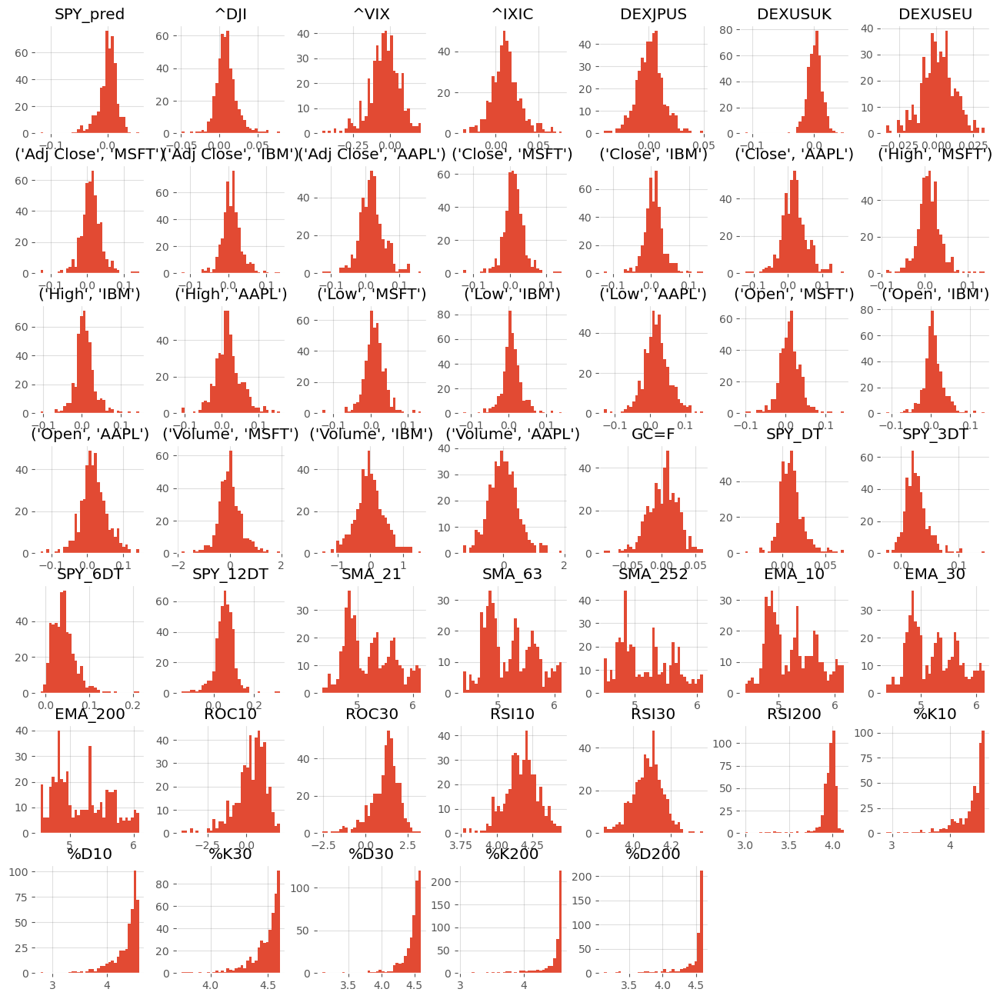

In [251]:
data.hist(bins = 35,
          sharex = False,
          sharey = False,
          figsize = (16, 16)
         )
plt.show()

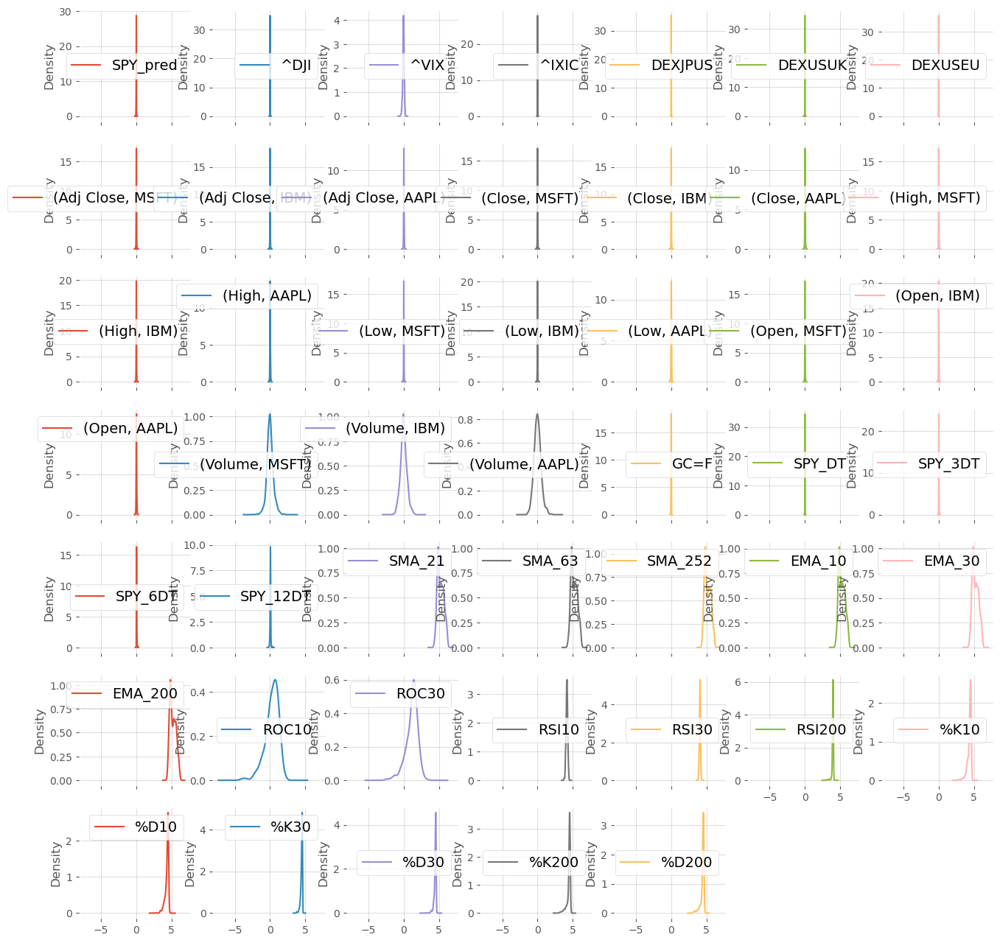

In [252]:
data.plot(kind = "density",
          subplots = True,
          layout = (7,7),
          sharex = True,
          legend = True,
          figsize = (16, 16)
         )
plt.show()

<AxesSubplot:title={'center':'Correlation Matrix'}>

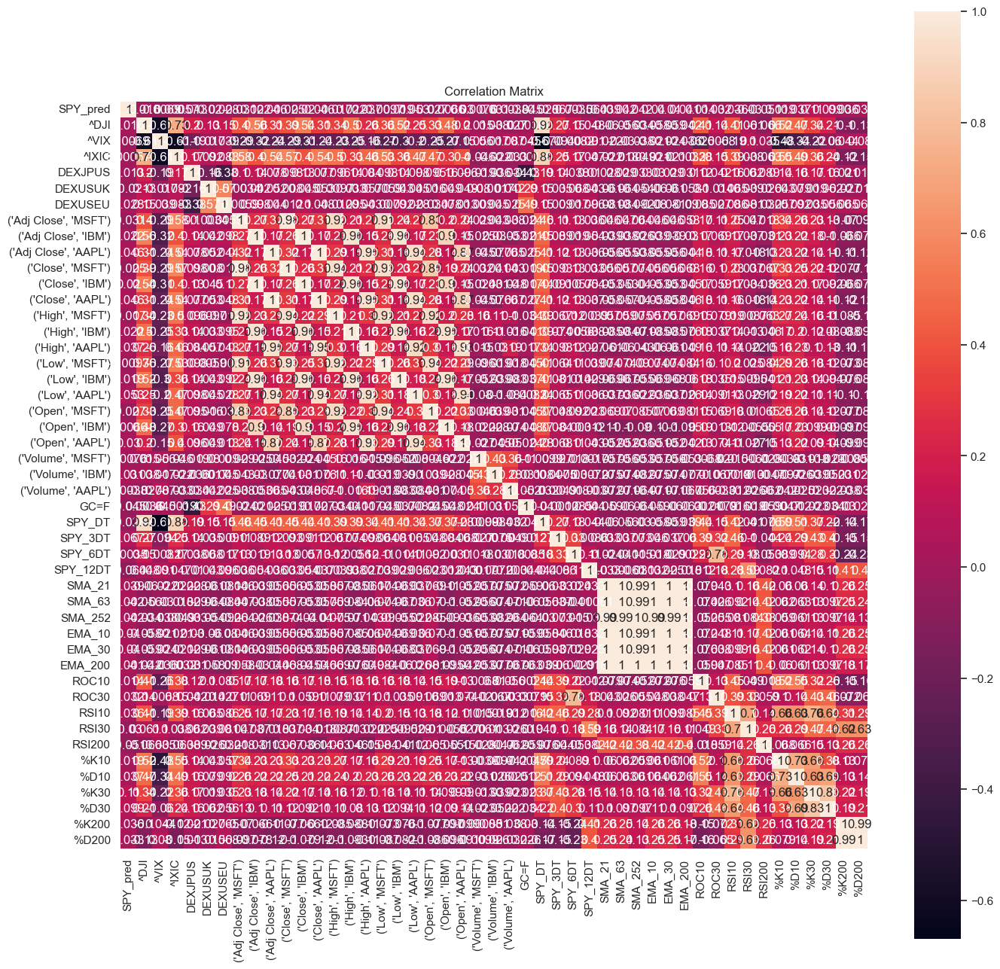

In [253]:
sns.set_theme(style = "white")

correlation = data.corr()

plt.figure(figsize = (16, 16)
          )

plt.title("Correlation Matrix")

sns.heatmap(correlation,
            vmax = 1,
            square = True,
            annot = True,
            cmap = "rocket")

# Training - Testing Split

In [254]:
validation_size = 0.20

train_size = int(len(X) * (1 - validation_size)
                 )

X_train, X_test = X[0:train_size], X[train_size:len(X)]

Y_train, Y_test = Y[0:train_size], Y[train_size:len(X)]


In [255]:
num_folds = 10 ## how many times to split the data
seed = 100 ## how many times to shuffle the data randomly before splitting into k folds. 
scoring = "neg_mean_squared_error" ## for the cv score to evaluate each fold on this metric

In [256]:
X_train = X_train.replace((np.inf, -np.inf, np.nan), 0)

In [257]:
X_train

,^DJI,^VIX,^IXIC,DEXJPUS,DEXUSUK,DEXUSEU,"(Adj Close, MSFT)","(Adj Close, IBM)","(Adj Close, AAPL)","(Close, MSFT)",...,ROC30,RSI10,RSI30,RSI200,%K10,%D10,%K30,%D30,%K200,%D200
2004-11-01,0.031,-0.019,0.034,-0.002,-0.004,-0.003,0.016,0.019,0.098,0.016,...,-0.720,4.130,3.998,2.993,4.529,4.516,4.357,4.308,4.200,4.170
2004-11-08,0.033,-0.165,0.030,-0.008,0.013,0.015,0.042,0.037,0.036,0.042,...,1.656,4.342,4.127,3.165,4.534,4.562,4.539,4.563,4.556,4.564
2004-11-15,0.015,-0.031,0.027,-0.000,-0.005,0.001,0.042,0.027,0.016,-0.067,...,1.445,4.387,4.171,3.236,4.557,4.560,4.577,4.578,4.583,4.585
2004-11-22,-0.006,-0.031,-0.004,-0.022,0.006,0.008,-0.027,-0.008,0.105,-0.027,...,1.578,4.133,4.102,3.260,3.937,4.008,4.479,4.487,4.508,4.514
2004-12-02,0.006,0.020,0.019,0.002,0.022,0.008,0.017,0.003,0.018,0.017,...,1.984,4.231,4.138,3.319,4.394,4.252,4.552,4.534,4.564,4.550
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-02-20,0.021,-0.096,0.010,-0.002,0.013,0.004,0.007,0.014,0.007,0.002,...,2.132,4.337,4.082,3.952,4.558,4.565,4.584,4.589,4.307,4.295
2019-02-27,0.001,0.047,0.009,0.002,0.021,0.004,0.046,0.008,0.016,0.046,...,1.980,4.294,4.084,3.954,4.317,4.369,4.511,4.521,4.324,4.327
2019-03-12,-0.010,-0.068,0.002,-0.005,-0.003,-0.002,0.017,0.003,0.030,0.017,...,1.809,4.120,4.059,3.954,4.315,3.977,4.474,4.356,4.331,4.285
2019-03-19,0.013,-0.015,0.017,0.000,0.012,0.006,0.035,0.016,0.031,0.035,...,1.225,4.236,4.097,3.961,4.426,4.498,4.479,4.531,4.392,4.384


In [258]:
models = []

In [259]:
models.append(("LR", LinearRegression()
              )
             )

models.append(("LASSO", Lasso()
              )
             )
    
models.append(("EN", ElasticNet()
              )
             )

models.append(("CART", DecisionTreeRegressor()
              )
             )

models.append(("KNN", KNeighborsRegressor()
              )
             )

models.append(("SVR", SVR()
              )
             )

# Bagging

models.append(("ETR", ExtraTreesRegressor()
              )
             )

models.append(("RFR", RandomForestRegressor()
              )
             )

# Boosting

models.append(("GBR", GradientBoostingRegressor()
              )
             )

models.append(("ABR", AdaBoostRegressor()
              )
             )

In [260]:
names = []

kfold_results = []

train_results = []
test_results = []
    
    
for name, model in models:
    names.append(name)
    
    # Let's run K-Fold analysis
    
    kfold = KFold(n_splits = num_folds,
                  random_state = seed,
                  shuffle = True)
    
    # Let's convert MSE to positive (HERE, the lower the better)
    
    cv_results = -1 * cross_val_score(model, X_train, Y_train,
                                      cv = kfold,
                                      scoring = scoring)
    
    kfold_results.append(cv_results) # REMEMBER TO ADD THIS
    
    # Entire training period
    
    res = model.fit(X_train, Y_train)
    train_result = mean_squared_error(res.predict(X_train), Y_train)
    train_results.append(train_result)
    
    # Results for test
    
    test_result = mean_squared_error(res.predict(X_test), Y_test)
    test_results.append(test_result)
    
    message = "%s: %f (%f) %f %f" % (name, cv_results.mean(), cv_results.std(), train_result, test_result)
    print(message)

LR: 0.000317 (0.000127) 0.000220 0.000487
LASSO: 0.000257 (0.000104) 0.000256 0.000433
EN: 0.000257 (0.000104) 0.000256 0.000433
CART: 0.000543 (0.000165) 0.000000 0.000604
KNN: 0.000296 (0.000125) 0.000195 0.000463
SVR: 0.000267 (0.000127) 0.000256 0.000433
ETR: 0.000305 (0.000148) 0.000000 0.000421
RFR: 0.000278 (0.000128) 0.000038 0.000430
GBR: 0.000314 (0.000130) 0.000040 0.000473
ABR: 0.000292 (0.000123) 0.000145 0.000477


# Test Performance

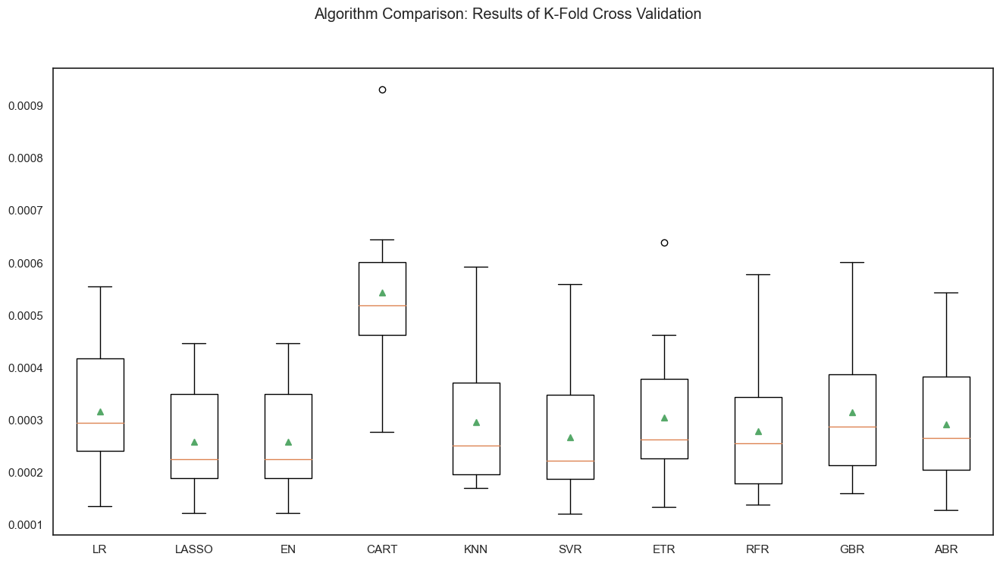

In [261]:
## giving the distribution for each algorithm after performing kcross validation for each algo in each fold. 
fig = plt.figure(figsize = (16, 8)
                 )

fig.suptitle("Algorithm Comparison: Results of K-Fold Cross Validation")

ax = fig.add_subplot(111)

plt.boxplot(kfold_results,showmeans=True)

ax.set_xticklabels(names)

plt.show()
## orange line is median
## green arrow is the mean of the distribution. 

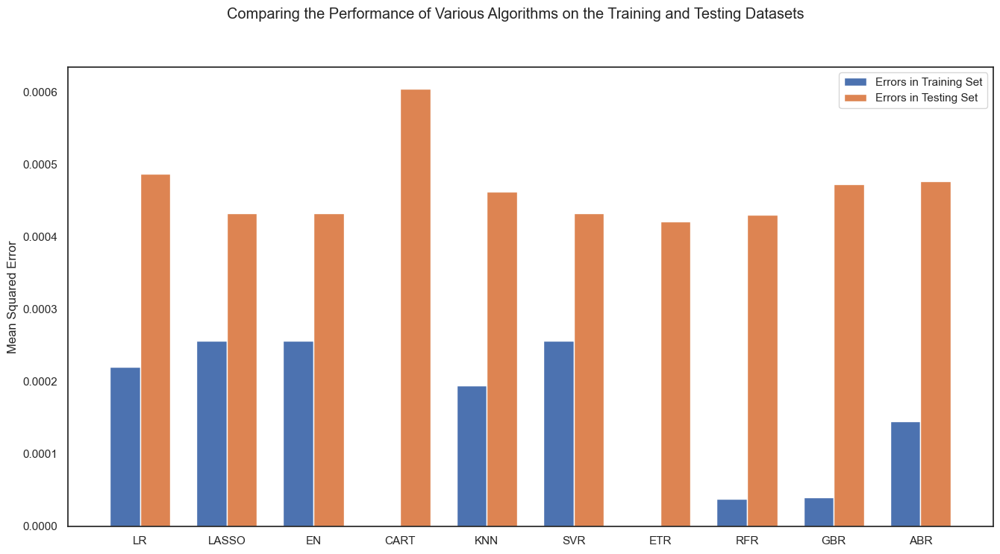

In [262]:
fig = plt.figure(figsize = (16, 8)
                 )

ind = np.arange(len(names)
               ) 
width = 0.35

fig.suptitle("Comparing the Performance of Various Algorithms on the Training and Testing Datasets")
ax = fig.add_subplot(111)

plt.bar(ind - width/2, 
        train_results, 
        width = width,
        label = "Errors in Training Set")

plt.bar(ind + width/2, 
        test_results, 
        width = width,
        label = "Errors in Testing Set")

plt.legend()

ax.set_xticks(ind)
ax.set_xticklabels(names)

plt.ylabel("Mean Squared Error")

plt.show()

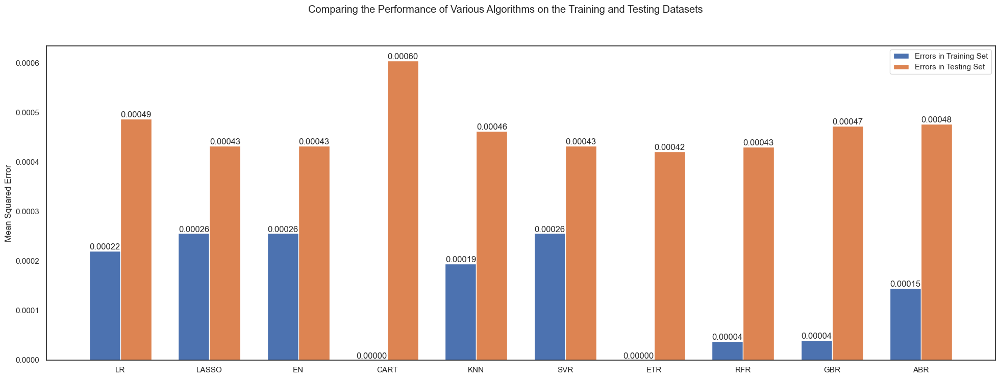

In [263]:
fig = plt.figure(figsize = (24, 8)
                 )

ind = np.arange(len(names)
               ) 
width = 0.35

fig.suptitle("Comparing the Performance of Various Algorithms on the Training and Testing Datasets")
ax = fig.add_subplot(111)

bar1 = plt.bar(ind - width/2, 
        train_results, 
        width = width,
        label = "Errors in Training Set")

bar2 = plt.bar(ind + width/2, 
        test_results, 
        width = width,
        label = "Errors in Testing Set")

ax.bar_label(bar1, fmt='%.5f')
ax.bar_label(bar2, fmt='%.5f')

plt.legend()

ax.set_xticks(ind)
ax.set_xticklabels(names)

plt.ylabel("Mean Squared Error")

plt.show()

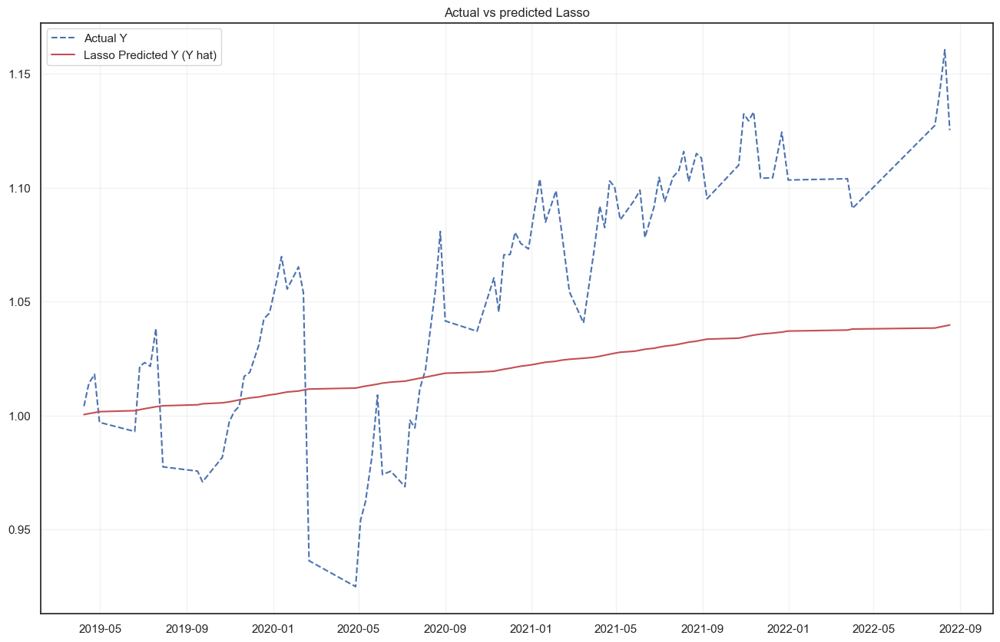

In [264]:
lasso=Lasso()
lasso.fit(X_train,Y_train)
lasso.predict(X_test)
y_lasso_growth=np.exp(lasso.predict(X_test)).cumprod()
y_lasso_growth=pd.DataFrame(y_lasso_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_lasso_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_lasso_growth, "r", label = "Lasso Predicted Y (Y hat)")
plt.title("Actual vs predicted Lasso")
plt.legend()

plt.show()

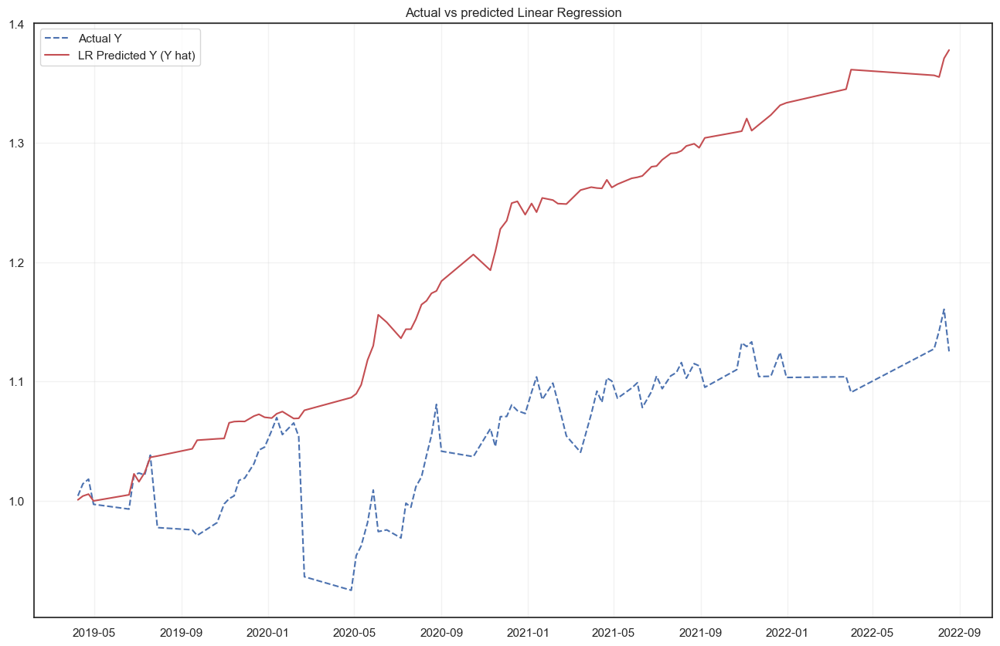

In [265]:
lr=LinearRegression()
lr.fit(X_train,Y_train)
lr.predict(X_test)
y_lr_growth=np.exp(lr.predict(X_test)).cumprod()
y_lr_growth=pd.DataFrame(y_lr_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_lr_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_lr_growth, "r", label = "LR Predicted Y (Y hat)")
plt.title("Actual vs predicted Linear Regression")
plt.legend()

plt.show()

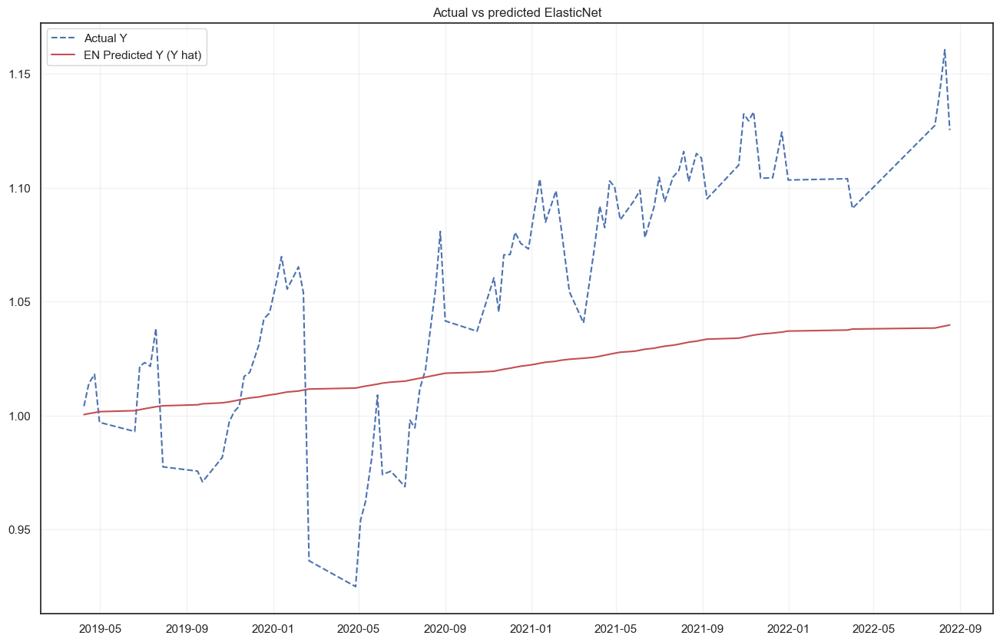

In [266]:
en=ElasticNet()
en.fit(X_train,Y_train)
en.predict(X_test)
y_en_growth=np.exp(en.predict(X_test)).cumprod()
y_en_growth=pd.DataFrame(y_en_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_en_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_en_growth, "r", label = "EN Predicted Y (Y hat)")
plt.title("Actual vs predicted ElasticNet")
plt.legend()

plt.show()

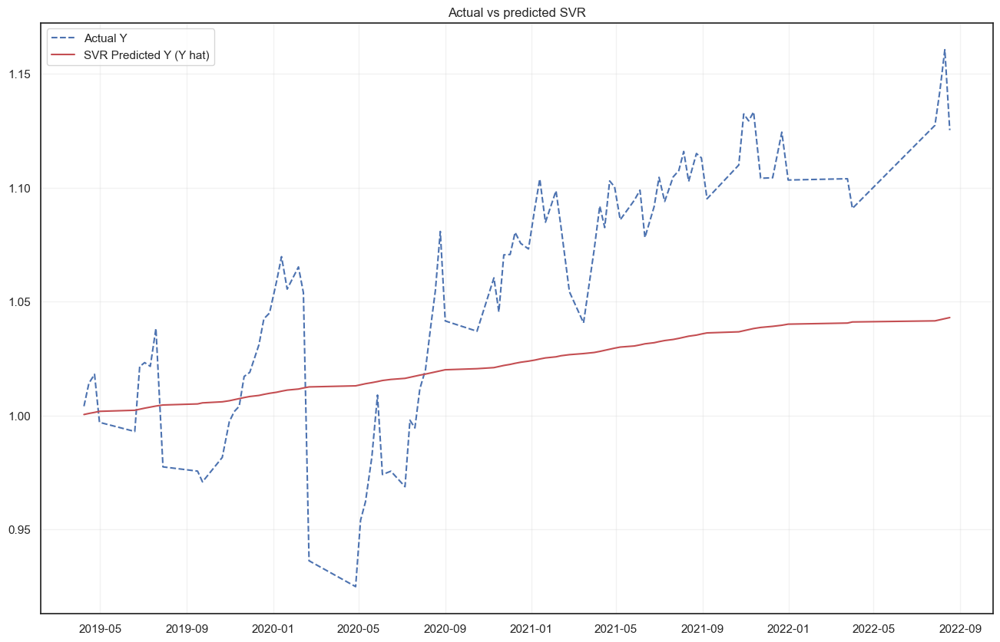

In [267]:
svr=SVR()
svr.fit(X_train,Y_train)
svr.predict(X_test)
y_svr_growth=np.exp(svr.predict(X_test)).cumprod()
y_svr_growth=pd.DataFrame(y_svr_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_svr_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_svr_growth, "r", label = "SVR Predicted Y (Y hat)")
plt.title("Actual vs predicted SVR")
plt.legend()

plt.show()

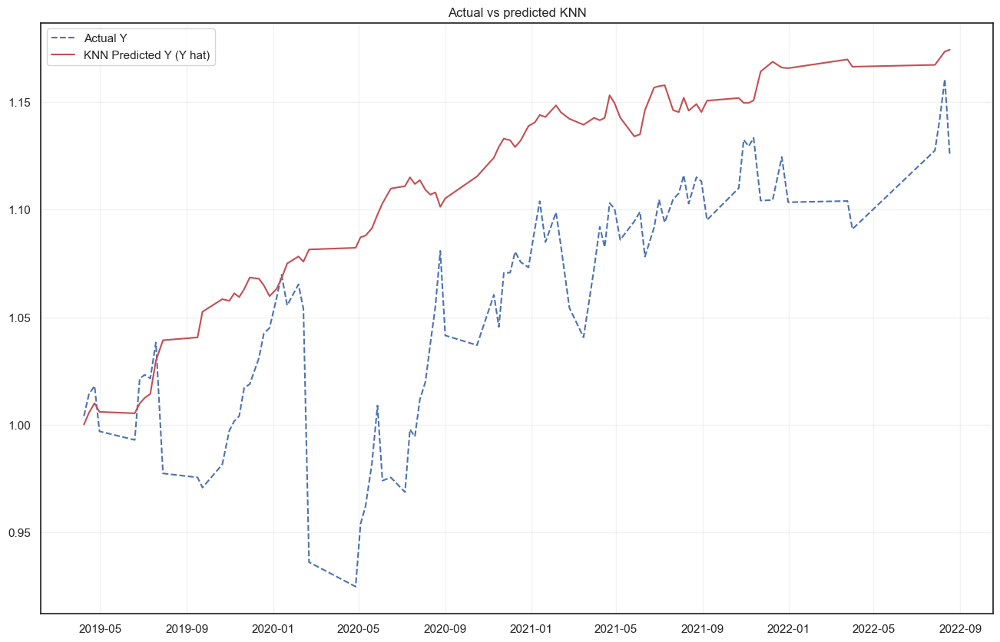

In [268]:
knn=KNeighborsRegressor()
knn.fit(X_train,Y_train)
knn.predict(X_test)
y_knn_growth=np.exp(knn.predict(X_test)).cumprod()
y_knn_growth=pd.DataFrame(y_knn_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_knn_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_knn_growth, "r", label = "KNN Predicted Y (Y hat)")
plt.title("Actual vs predicted KNN")
plt.legend()

plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

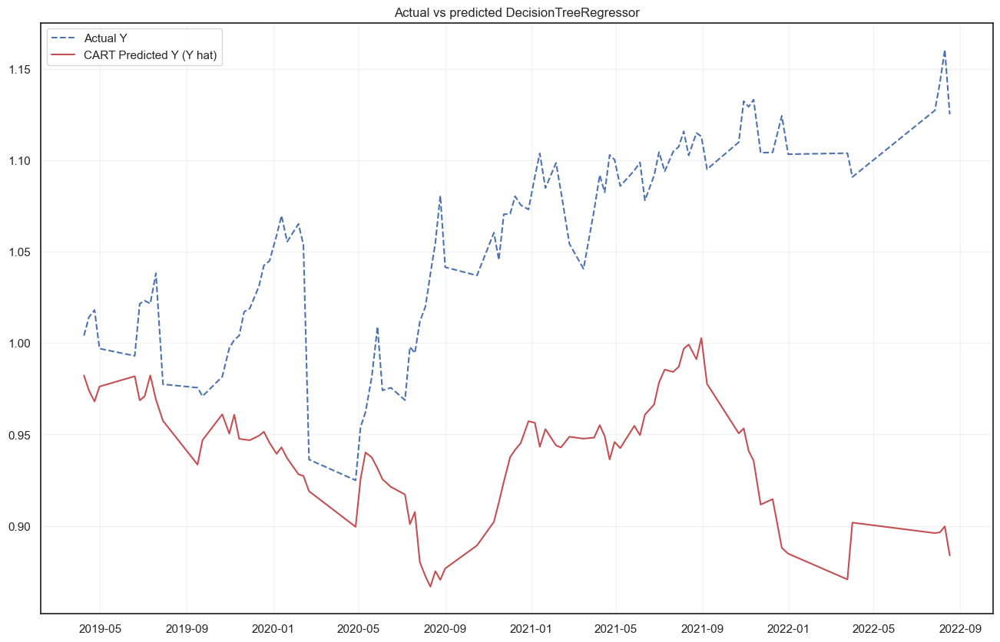

In [269]:
cart=DecisionTreeRegressor()
cart.fit(X_train,Y_train)
cart.predict(X_test)
y_cart_growth=np.exp(cart.predict(X_test)).cumprod()
y_cart_growth=pd.DataFrame(y_cart_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_cart_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_cart_growth, "r", label = "CART Predicted Y (Y hat)")
plt.title("Actual vs predicted DecisionTreeRegressor")
plt.legend()

plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

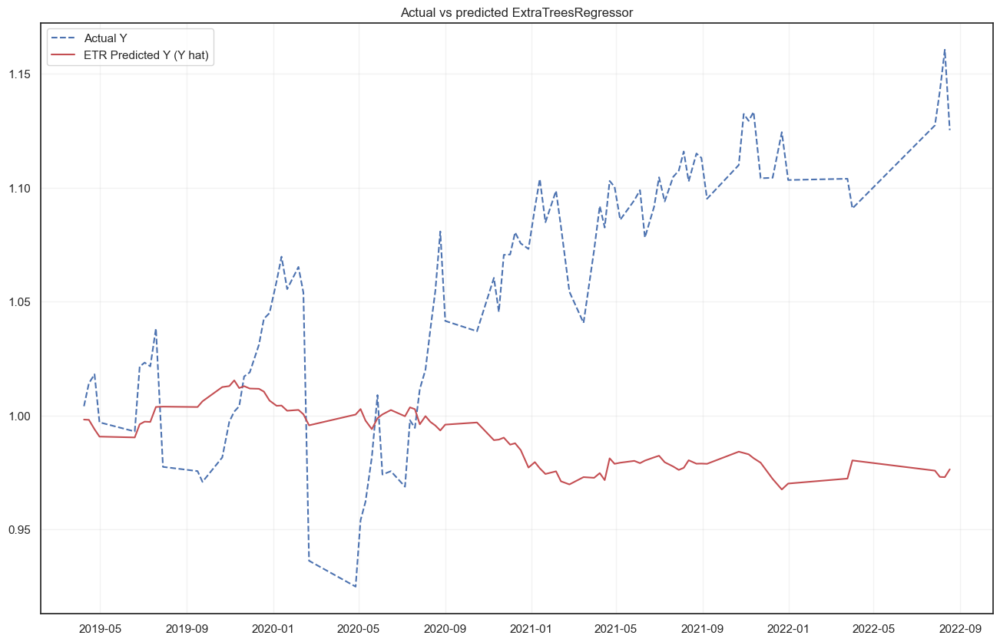

In [270]:
etr=ExtraTreesRegressor()
etr.fit(X_train,Y_train)
etr.predict(X_test)
y_etr_growth=np.exp(etr.predict(X_test)).cumprod()
y_etr_growth=pd.DataFrame(y_etr_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_etr_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_etr_growth, "r", label = "ETR Predicted Y (Y hat)")
plt.title("Actual vs predicted ExtraTreesRegressor")
plt.legend()

plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

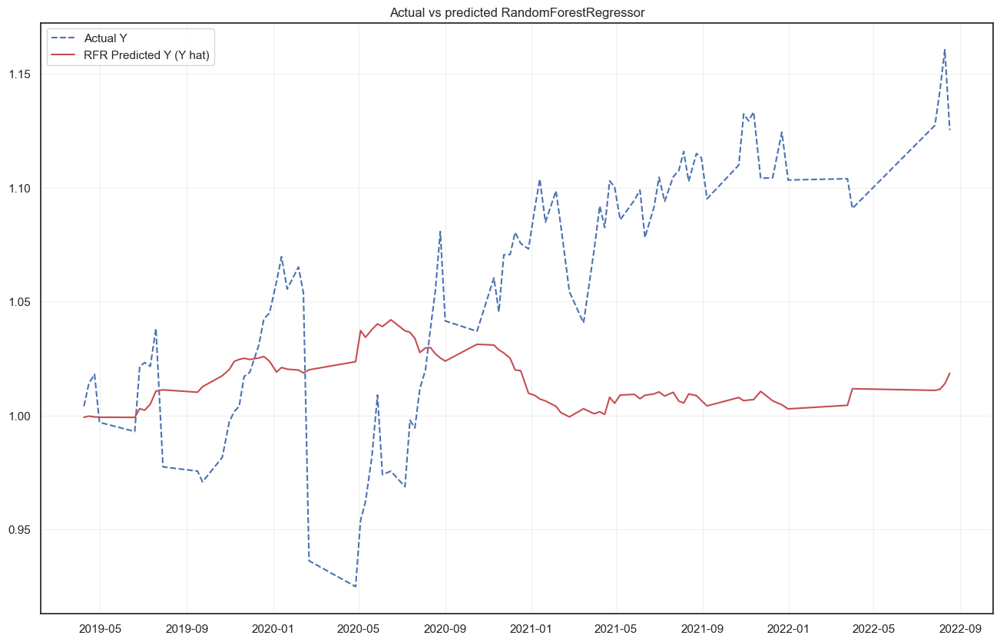

In [271]:
rfr=RandomForestRegressor()
rfr.fit(X_train,Y_train)
rfr.predict(X_test)
y_rfr_growth=np.exp(rfr.predict(X_test)).cumprod()
y_rfr_growth=pd.DataFrame(y_rfr_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_rfr_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_rfr_growth, "r", label = "RFR Predicted Y (Y hat)")
plt.title("Actual vs predicted RandomForestRegressor")
plt.legend()

plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

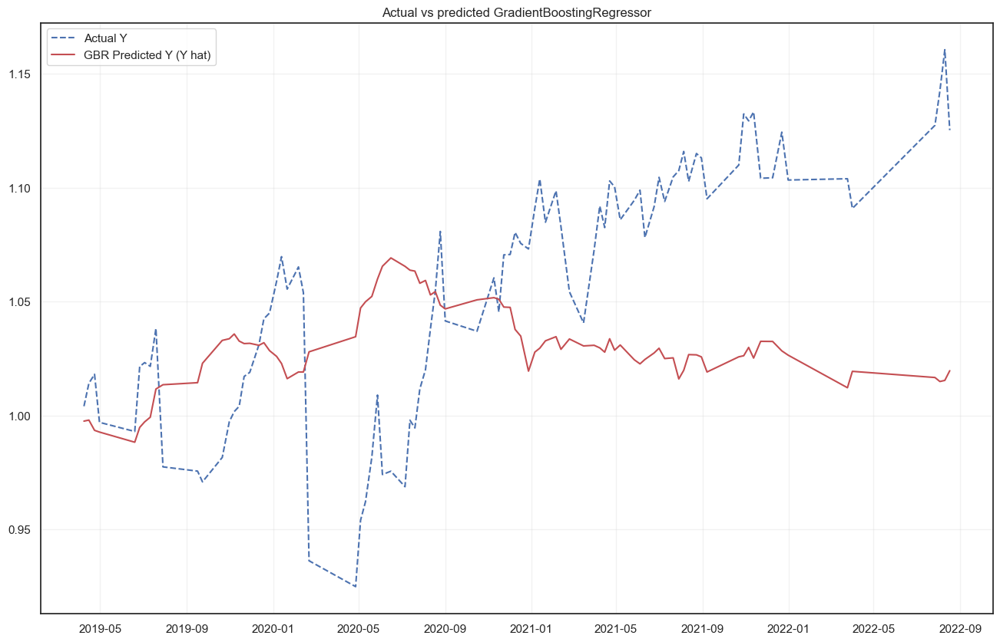

In [272]:
gbr=GradientBoostingRegressor()
gbr.fit(X_train,Y_train)
gbr.predict(X_test)
y_gbr_growth=np.exp(gbr.predict(X_test)).cumprod()
y_gbr_growth=pd.DataFrame(y_gbr_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_gbr_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_gbr_growth, "r", label = "GBR Predicted Y (Y hat)")
plt.title("Actual vs predicted GradientBoostingRegressor")
plt.legend()

plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

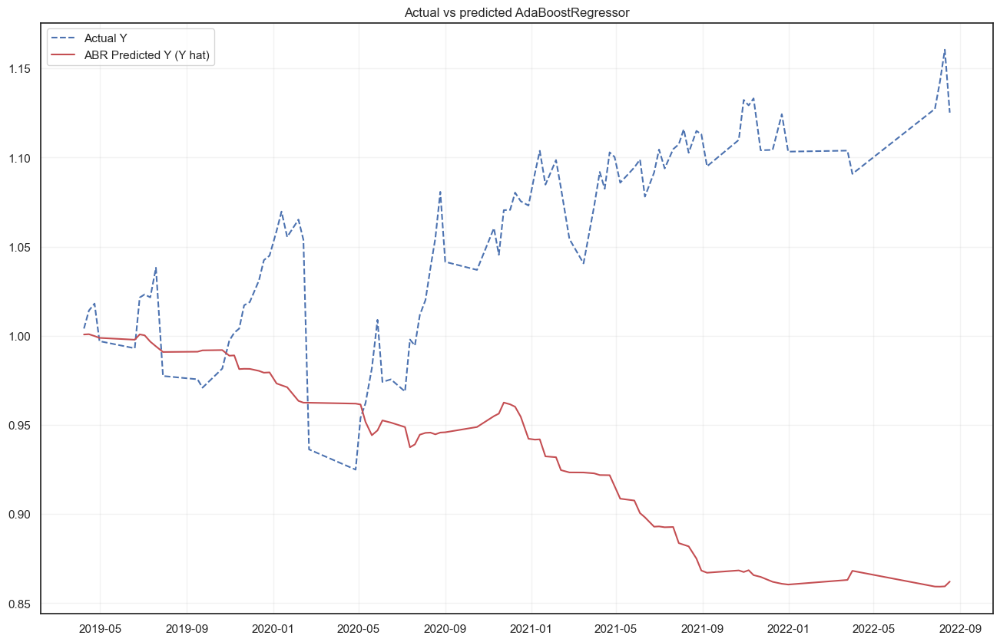

In [273]:
abr=AdaBoostRegressor()
abr.fit(X_train,Y_train)
abr.predict(X_test)
y_abr_growth=np.exp(abr.predict(X_test)).cumprod()
y_abr_growth=pd.DataFrame(y_abr_growth)

plt.figure(figsize = (16, 10)
           )
plt.grid()
y_abr_growth.index = Y_test.index

plt.plot(np.exp(Y_test).cumprod(), "b--", label = "Actual Y")

plt.plot(y_abr_growth, "r", label = "ABR Predicted Y (Y hat)")
plt.title("Actual vs predicted AdaBoostRegressor")
plt.legend()

plt.show

From the test set model that shows larger divergence against the actual Y results is a poorer model as it does not explain the Y dependent well. Hence CART and ABR are poorer model.

# Building ML Trading Strategies & Performance Metrics

In [274]:
def backtest(model,model_name,model_y):
    
    model=model_name()
    model.fit(X_train,Y_train)
    model.predict(X_train)
    model_y=np.exp(model.predict(X_train)).cumprod()
    model_y=pd.DataFrame(model_y, index = X_train.index)
    
    model_y = model_y.pct_change()
    model_y.columns=["predict_returns"]
    model_y = pd.concat([SPY['Close'],model_y],axis=1,join='inner')

    ### Building Trading Signals
    model_y['signal_pred'] = np.where(model_y.iloc[:,1]\
                                      > 0.01, 1, 0)

    model_y['signal_pred']=np.where(model_y.iloc[:,1]\
                                    < -0.01, -1, \
                                    model_y['signal_pred']
                                   )
    ### Building Trading Strategy
    model_y['stock_return'] = np.log(SPY["Close"]/SPY["Close"].shift(1))

    model_y['cum_stock_returns'] = model_y['stock_return'].cumsum().apply(np.exp)

    model_y['strategy'] = model_y['stock_return'] * model_y['signal_pred'].shift(1)

    model_y['cum_strategy'] = model_y['strategy'].cumsum().apply(np.exp)

    model_y['signal']=np.where(model_y['stock_return'] > 0, 1, -1)
    
    model_y[['cum_stock_returns','cum_strategy']].plot(figsize=(16,10))
    
    ### Trading Staistics
    cap = 500000.0
    
    model_y['total asset']=model_y["cum_strategy"] * cap 
    
    ### Sharpe Ratio
    if model_y['strategy'].std()*np.sqrt(252)==0:
        print("error")
    else: 
        sharpe_ratio = (model_y['strategy'].mean()/model_y['strategy'].std())*np.sqrt(252)
    
    ### CAGR
    D = (model_y.index[-1] - SPY.index[0]).days

    CAGR = (((model_y["cum_strategy"][-1]) / (model_y["cum_strategy"][1])) ** (365.0/D)) - 1
    
    ### Max Drawdown
    model_y['cum_max'] = model_y['cum_strategy'].cummax()
    drawdown_daily = model_y['cum_strategy'] / model_y['cum_max']-1
    max_drawdown = -drawdown_daily.min()
    
    ### Return Statistics Table
    total_asset = 500000.0 * model_y['cum_strategy'][-1]
    
    table = pd.DataFrame({'Sharpe Ratio': sharpe_ratio, 
                        'CAGR': CAGR,
                        'Max Drawdown': max_drawdown,
                        'Total Asset': total_asset,
                        'Strategy Return': model_y['cum_strategy'][-1]
    },columns=['Sharpe Ratio','CAGR','Max Drawdown','Total Asset','Strategy Return'],index=[0])
    
    table_model_y = pd.DataFrame(model_y)
    
    return table, table_model_y

### `Lasso Regression` Backtesting on In Sample

In [275]:
lasso=Lasso()
lasso.fit(X_train,Y_train)
lasso.predict(X_train)
y_lasso_growth=np.exp(lasso.predict(X_train)).cumprod()
y_lasso_growth=pd.DataFrame(y_lasso_growth, index = X_train.index)

In [276]:
y_lasso_growth = y_lasso_growth.pct_change()
y_lasso_growth.columns=["predict_returns"]
y_lasso_growth = pd.concat([SPY['Close'],y_lasso_growth],axis=1,join='inner')

In [277]:
y_lasso_growth

,Close,predict_returns
2004-11-01,113.510,NaN
2004-11-08,117.110,0.000
2004-11-15,118.730,0.000
2004-11-22,117.980,0.000
2004-12-02,119.330,0.000
...,...,...
2019-02-20,278.410,0.000
2019-02-27,279.200,0.000
2019-03-12,279.490,0.000
2019-03-19,282.400,0.000


> ### Building Trading Signals

In [278]:
y_lasso_growth['signal_pred'] = np.where(y_lasso_growth.iloc[:,1]\
                                      > 0.01, 1, 0)

y_lasso_growth['signal_pred']=np.where(y_lasso_growth.iloc[:,1]\
                                    < -0.01, -1, \
                                    y_lasso_growth['signal_pred']
                                   )

> ### Building Strategy Returns

In [279]:
y_lasso_growth['stock_return'] = np.log(SPY["Close"]/SPY["Close"].shift(1))

y_lasso_growth['cum_stock_returns'] = y_lasso_growth['stock_return'].cumsum().apply(np.exp)

y_lasso_growth['strategy'] = y_lasso_growth['stock_return'] * y_lasso_growth['signal_pred'].shift(1)

y_lasso_growth['cum_strategy'] = y_lasso_growth['strategy'].cumsum().apply(np.exp)

y_lasso_growth['signal']=np.where(y_lasso_growth['stock_return'] > 0, 1, -1)

<AxesSubplot:>

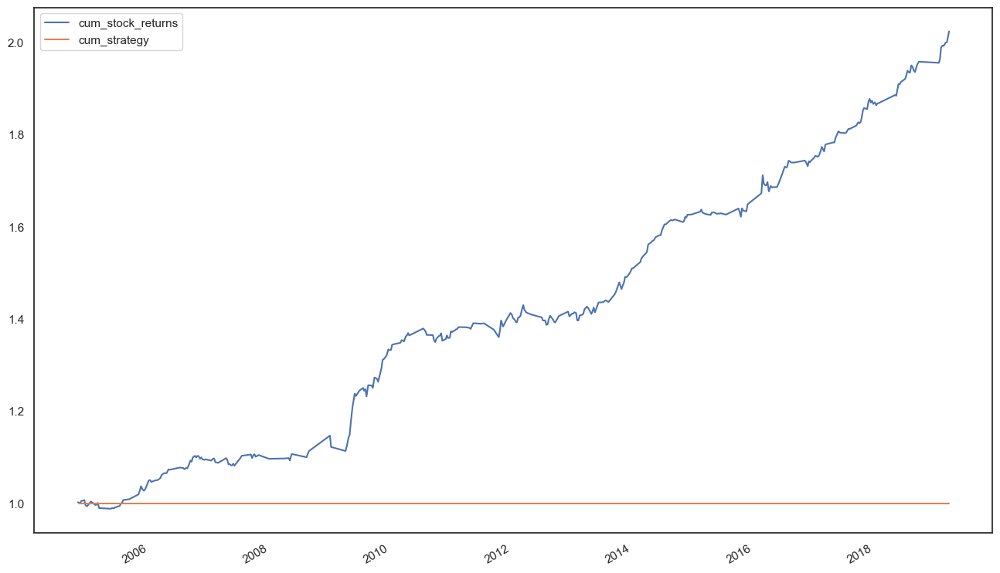

In [280]:
y_lasso_growth[['cum_stock_returns','cum_strategy']].plot(figsize=(16,10))

In [281]:
cap = 500000

y_lasso_growth['total asset']=y_lasso_growth["cum_strategy"] * cap

### Sharpe Ratio

In [282]:
if y_lasso_growth['strategy'].std()*np.sqrt(252)==0:
    print("error")
    
else:
    sharpe_ratio = (y_lasso_growth['strategy'].mean()/y_lasso_growth['strategy'].std())*np.sqrt(252)
    print(sharpe_ratio)

error


### CAGR

In [283]:
D = (y_lasso_growth.index[-1] - SPY.index[0]).days

CAGR = (((y_lasso_growth["cum_strategy"][-1]) / (y_lasso_growth["cum_strategy"][1])) ** (365.0/D)) - 1

CAGR

0.0

### Max Drawdown

In [284]:
y_lasso_growth['cum_max'] = y_lasso_growth['cum_strategy'].cummax()
drawdown_daily = y_lasso_growth['cum_strategy'] / y_lasso_growth['cum_max']-1
max_drawdown = -drawdown_daily.min()

max_drawdown

-0.0

### Return Statistics


In [285]:
total_asset = 500000.0 * y_lasso_growth['cum_strategy'][-1]
    
lasso_table = pd.DataFrame({'Sharpe Ratio': "NA", 
                        'CAGR': CAGR,
                        'Max Drawdown': max_drawdown,
                        'Total Asset': total_asset,
                        'Strategy Return': y_lasso_growth['cum_strategy'][-1]
    },columns=['Sharpe Ratio','CAGR','Max Drawdown','Total Asset','Strategy Return'],index=[0])

lasso_table

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,NA,0.000,-0.000,500000.000,1.000


### `"LR", Linear Regression` Backtesting on In Sample

In [286]:
lr=LinearRegression()
lr.fit(X_train,Y_train)
lr.predict(X_train)
y_lr_growth=np.exp(lr.predict(X_train)).cumprod()
y_lr_growth=pd.DataFrame(y_lr_growth,index=X_train.index)

In [287]:
y_lr_growth=y_lr_growth.pct_change()

In [288]:
y_lr_growth.columns=["predict_return"]

In [289]:
y_lr_growth = pd.concat([SPY['Close'],y_lr_growth],axis=1,join='inner')

> ### Building Trading Signals

In [290]:
y_lr_growth['signal_pred'] = np.where(y_lr_growth.iloc[:,1]\
                                      > 0.01, 1, 0)

In [291]:
y_lr_growth['signal_pred']=np.where(y_lr_growth.iloc[:,1]\
                                    < -0.01, -1, \
                                    y_lr_growth['signal_pred']
                                   )

> ### Building Strategy Returns

In [292]:
y_lr_growth['stock_return'] = np.log(SPY["Close"]/SPY["Close"].shift(1))

In [293]:
y_lr_growth['cum_returns'] = y_lr_growth['stock_return'].cumsum().apply(np.exp)

y_lr_growth['strategy'] = y_lr_growth['stock_return'] * y_lr_growth['signal_pred'].shift(1)

y_lr_growth['cum_strategy'] = y_lr_growth['strategy'].cumsum().apply(np.exp)

In [294]:
y_lr_growth['signal']=np.where(y_lr_growth['stock_return'] > 0, 1, -1)

<AxesSubplot:>

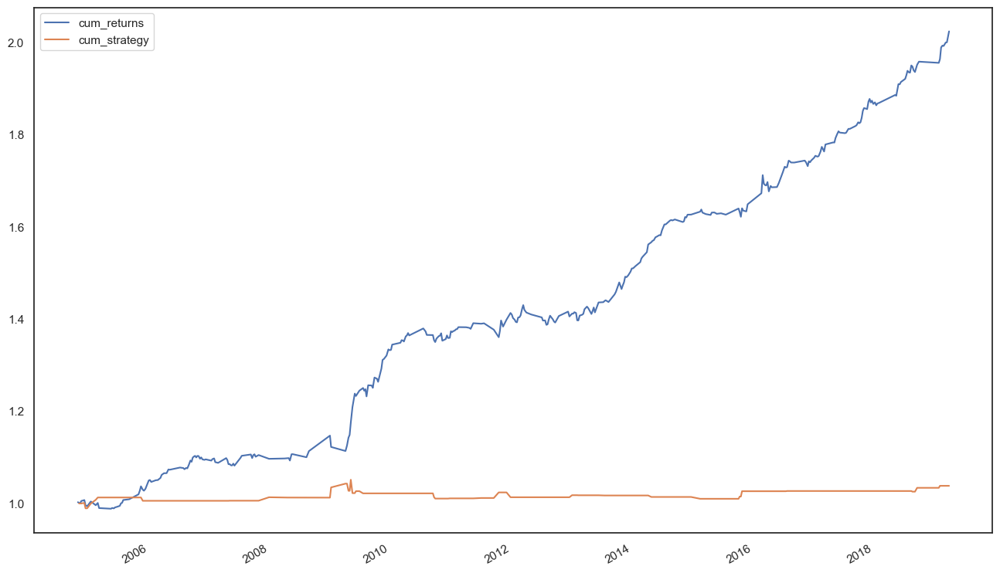

In [295]:
y_lr_growth[['cum_returns','cum_strategy']].plot(figsize=(16,10))

### Total Asset

In [296]:
cap = 500000

In [297]:
y_lr_growth['total asset']=y_lr_growth["cum_strategy"] * cap 

In [298]:
y_lr_growth

,Close,predict_return,signal_pred,stock_return,cum_returns,strategy,cum_strategy,signal,total asset
2004-11-01,113.510,NaN,0,0.003,1.003,NaN,NaN,1,NaN
2004-11-08,117.110,0.009,0,-0.001,1.001,-0.000,1.000,-1,500000.000
2004-11-15,118.730,-0.007,0,-0.001,1.001,-0.000,1.000,-1,500000.000
2004-11-22,117.980,0.011,1,0.005,1.006,0.000,1.000,1,500000.000
2004-12-02,119.330,0.009,0,0.001,1.006,0.001,1.001,1,500419.351
...,...,...,...,...,...,...,...,...,...
2019-02-20,278.410,0.001,0,0.002,1.993,0.000,1.038,1,519130.306
2019-02-27,279.200,0.003,0,-0.000,1.993,-0.000,1.038,-1,519130.306
2019-03-12,279.490,-0.006,0,0.004,2.000,0.000,1.038,1,519130.306
2019-03-19,282.400,-0.002,0,0.000,2.001,0.000,1.038,1,519130.306


### Sharpe Ratio

In [299]:
sharpe_ratio=(y_lr_growth['strategy'].mean()/y_lr_growth['strategy'].std())*np.sqrt(252)

In [300]:
sharpe_ratio

0.5608296008132605

### CAGR

In [302]:
D = (y_lr_growth.index[-1] - SPY.index[0]).days

CAGR = (((y_lr_growth["cum_strategy"][-1]) / (y_lr_growth["cum_strategy"][1])) ** (365.0/D)) - 1

CAGR

0.002436739719022807

### Max Drawdown

In [303]:
y_lr_growth['cum_max'] = y_lr_growth['cum_strategy'].cummax()
drawdown_daily = y_lr_growth['cum_strategy'] / y_lr_growth['cum_max']-1
max_drawdown = -drawdown_daily.min()

In [304]:
max_drawdown

0.039287356677194074

### Return Statistics


In [306]:
total_asset = 500000.0 * y_lr_growth['cum_strategy'][-1]
    
lr_table = pd.DataFrame({'Sharpe Ratio': sharpe_ratio, 
                        'CAGR': CAGR,
                        'Max Drawdown': max_drawdown,
                        'Total Asset': total_asset,
                        'Strategy Return': y_lr_growth['cum_strategy'][-1]
    },columns=['Sharpe Ratio','CAGR','Max Drawdown','Total Asset','Strategy Return'],index=[0])
    

In [307]:
lr_table

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,0.561,0.002,0.039,519130.306,1.038


### `"KNN", K Nearest Neighbors` Backtesting In Sample

In [308]:
knn=KNeighborsRegressor()
knn.fit(X_train,Y_train)
knn.predict(X_train)
y_knn_growth=np.exp(knn.predict(X_train)).cumprod()
y_knn_growth=pd.DataFrame(y_knn_growth, index=X_train.index)

In [309]:
y_knn_growth=y_knn_growth.pct_change()
y_knn_growth.columns=["predict_return"]
y_knn_growth = pd.concat([SPY['Close'],y_knn_growth],axis=1,join='inner')
y_knn_growth

,Close,predict_return
2004-11-01,113.510,NaN
2004-11-08,117.110,0.005
2004-11-15,118.730,0.005
2004-11-22,117.980,-0.005
2004-12-02,119.330,0.003
...,...,...
2019-02-20,278.410,-0.003
2019-02-27,279.200,-0.002
2019-03-12,279.490,0.006
2019-03-19,282.400,-0.002


> ### Building Trading Signals

In [310]:
y_knn_growth['signal_pred'] = np.where(y_knn_growth.iloc[:,1]\
                                      > 0.01, 1, 0)

y_knn_growth['signal_pred']=np.where(y_knn_growth.iloc[:,1]\
                                    < -0.01, -1, \
                                    y_knn_growth['signal_pred']
                                   )

> ### Building Strategy Returns

<AxesSubplot:>

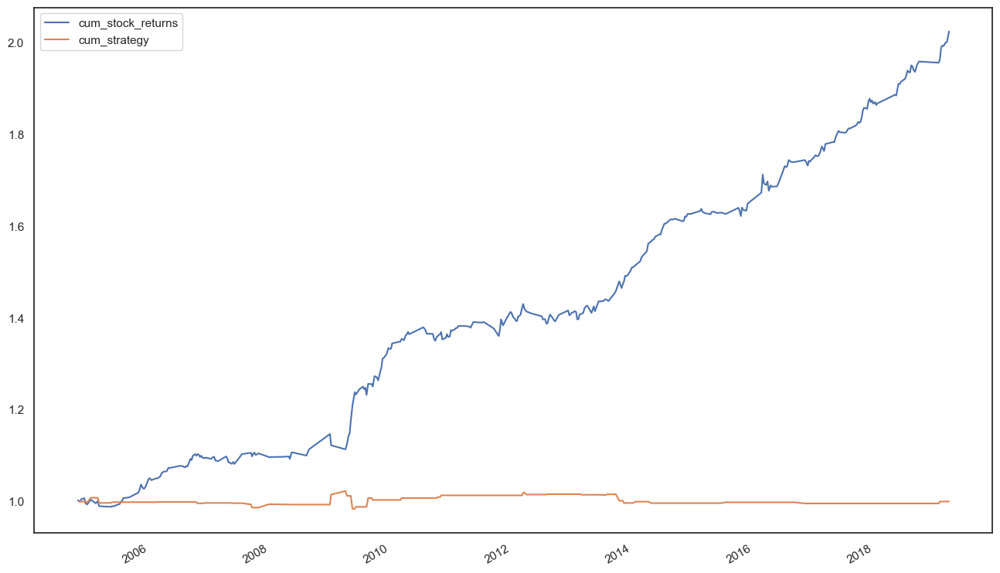

In [311]:
y_knn_growth['stock_return'] = np.log(SPY["Close"]/SPY["Close"].shift(1))

y_knn_growth['cum_stock_returns'] = y_knn_growth['stock_return'].cumsum().apply(np.exp)

y_knn_growth['strategy'] = y_knn_growth['stock_return'] * y_knn_growth['signal_pred'].shift(1)

y_knn_growth['cum_strategy'] = y_knn_growth['strategy'].cumsum().apply(np.exp)

y_knn_growth['signal']=np.where(y_knn_growth['stock_return'] > 0, 1, -1)

y_knn_growth[['cum_stock_returns','cum_strategy']].plot(figsize=(16,10))

### Total Assets

In [312]:
cap = 500000

y_knn_growth['total asset']=y_knn_growth["cum_strategy"] * cap 

y_knn_growth

,Close,predict_return,signal_pred,stock_return,cum_stock_returns,strategy,cum_strategy,signal,total asset
2004-11-01,113.510,NaN,0,0.003,1.003,NaN,NaN,1,NaN
2004-11-08,117.110,0.005,0,-0.001,1.001,-0.000,1.000,-1,500000.000
2004-11-15,118.730,0.005,0,-0.001,1.001,-0.000,1.000,-1,500000.000
2004-11-22,117.980,-0.005,0,0.005,1.006,0.000,1.000,1,500000.000
2004-12-02,119.330,0.003,0,0.001,1.006,0.000,1.000,1,500000.000
...,...,...,...,...,...,...,...,...,...
2019-02-20,278.410,-0.003,0,0.002,1.993,0.000,1.000,1,500064.824
2019-02-27,279.200,-0.002,0,-0.000,1.993,-0.000,1.000,-1,500064.824
2019-03-12,279.490,0.006,0,0.004,2.000,0.000,1.000,1,500064.824
2019-03-19,282.400,-0.002,0,0.000,2.001,0.000,1.000,1,500064.824


### Sharpe Ratio

In [313]:
sharpe_ratio=(y_knn_growth['strategy'].mean()/y_knn_growth['strategy'].std())*np.sqrt(252)
sharpe_ratio

0.0021463839078000864

### CAGR

In [314]:
D = (y_knn_growth.index[-1] - SPY.index[0]).days

CAGR = (((y_knn_growth["cum_strategy"][-1]) / (y_knn_growth["cum_strategy"][1])) ** (365.0/D)) - 1

CAGR

8.403294837533437e-06

### Max Drawdown

In [315]:
y_knn_growth['cum_max'] = y_knn_growth['cum_strategy'].cummax()
drawdown_daily = y_knn_growth['cum_strategy'] / y_knn_growth['cum_max']-1
max_drawdown = -drawdown_daily.min()

max_drawdown

0.03788812433030975

### Return Statistics

In [316]:
total_asset = 500000.0 * y_lr_growth['cum_strategy'][-1]
    
knn_table = pd.DataFrame({'Sharpe Ratio': sharpe_ratio, 
                        'CAGR': CAGR,
                        'Max Drawdown': max_drawdown,
                        'Total Asset': total_asset,
                        'Strategy Return': y_lr_growth['cum_strategy'][-1]
    },columns=['Sharpe Ratio','CAGR','Max Drawdown','Total Asset','Strategy Return'],index=[0])
    
knn_table

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,0.002,0.000,0.038,519130.306,1.038


### `Elastic Net` Backtesting In Sample

In [317]:
en=ElasticNet()
en.fit(X_train,Y_train)
en.predict(X_train)
y_en_growth=np.exp(en.predict(X_train)).cumprod()
y_en_growth=pd.DataFrame(y_en_growth, index = X_train.index)

In [318]:
y_en_growth=y_en_growth.pct_change()
y_en_growth.columns=["predict_return"]
y_en_growth = pd.concat([SPY['Close'],y_en_growth],axis=1,join='inner')
y_en_growth

,Close,predict_return
2004-11-01,113.510,NaN
2004-11-08,117.110,0.000
2004-11-15,118.730,0.000
2004-11-22,117.980,0.000
2004-12-02,119.330,0.000
...,...,...
2019-02-20,278.410,0.000
2019-02-27,279.200,0.000
2019-03-12,279.490,0.000
2019-03-19,282.400,0.000


> ### Building Trading Signals

In [319]:
y_en_growth['signal_pred'] = np.where(y_en_growth.iloc[:,1]\
                                      > 0.01, 1, 0)

y_en_growth['signal_pred']=np.where(y_en_growth.iloc[:,1]\
                                    < -0.01, -1, \
                                    y_en_growth['signal_pred']
                                   )

> ### Building Strategy Returns

<AxesSubplot:>

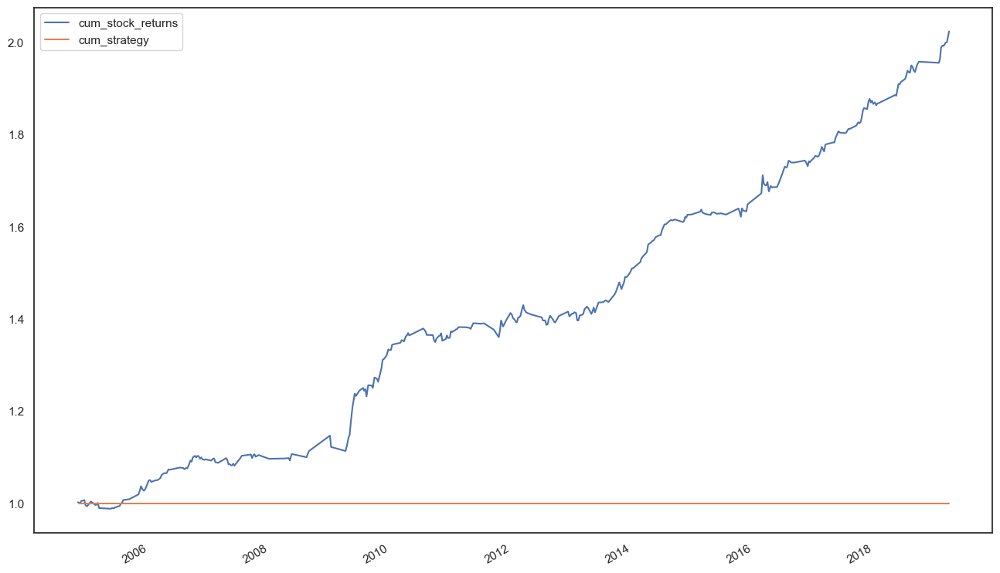

In [320]:
y_en_growth['stock_return'] = np.log(SPY["Close"]/SPY["Close"].shift(1))

y_en_growth['cum_stock_returns'] = y_en_growth['stock_return'].cumsum().apply(np.exp)

y_en_growth['strategy'] = y_en_growth['stock_return'] * y_en_growth['signal_pred'].shift(1)

y_en_growth['cum_strategy'] = y_en_growth['strategy'].cumsum().apply(np.exp)

y_en_growth['signal']=np.where(y_en_growth['stock_return'] > 0, 1, -1)

y_en_growth[['cum_stock_returns','cum_strategy']].plot(figsize=(16,10))

### Total Asset

In [321]:
cap = 500000

y_en_growth['total asset']=y_en_growth["cum_strategy"] * cap 

y_en_growth

,Close,predict_return,signal_pred,stock_return,cum_stock_returns,strategy,cum_strategy,signal,total asset
2004-11-01,113.510,NaN,0,0.003,1.003,NaN,NaN,1,NaN
2004-11-08,117.110,0.000,0,-0.001,1.001,-0.000,1.000,-1,500000.000
2004-11-15,118.730,0.000,0,-0.001,1.001,-0.000,1.000,-1,500000.000
2004-11-22,117.980,0.000,0,0.005,1.006,0.000,1.000,1,500000.000
2004-12-02,119.330,0.000,0,0.001,1.006,0.000,1.000,1,500000.000
...,...,...,...,...,...,...,...,...,...
2019-02-20,278.410,0.000,0,0.002,1.993,0.000,1.000,1,500000.000
2019-02-27,279.200,0.000,0,-0.000,1.993,-0.000,1.000,-1,500000.000
2019-03-12,279.490,0.000,0,0.004,2.000,0.000,1.000,1,500000.000
2019-03-19,282.400,0.000,0,0.000,2.001,0.000,1.000,1,500000.000


### Sharpe Ratio

In [322]:
if y_en_growth['strategy'].std()*np.sqrt(252)==0:
    print("error")
    
else:
    sharpe_ratio = (y_en_growth['strategy'].mean()/y_en_growth['strategy'].std())*np.sqrt(252)
    print(sharpe_ratio)

error


### CAGR

In [324]:
D = (y_en_growth.index[-1] - SPY.index[0]).days

CAGR = (((y_en_growth["cum_strategy"][-1]) / (y_en_growth["cum_strategy"][1])) ** (365.0/D)) - 1

CAGR

0.0

### Max Drawdown

In [325]:
y_en_growth['cum_max'] = y_en_growth['cum_strategy'].cummax()
drawdown_daily = y_en_growth['cum_strategy'] / y_en_growth['cum_max']-1
max_drawdown = -drawdown_daily.min()

max_drawdown

-0.0

### Return Statistics

In [326]:
total_asset = 500000.0 * y_en_growth['cum_strategy'][-1]
    
en_table = pd.DataFrame({'Sharpe Ratio': "0", 
                        'CAGR': CAGR,
                        'Max Drawdown': max_drawdown,
                        'Total Asset': total_asset,
                        'Strategy Return': y_en_growth['cum_strategy'][-1]
    },columns=['Sharpe Ratio','CAGR','Max Drawdown','Total Asset','Strategy Return'],index=[0])
    
en_table

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,0,0.000,-0.000,500000.000,1.000


### `SVR` Backtesting In Sample

In [327]:
svr=SVR()
svr.fit(X_train,Y_train)
svr.predict(X_train)
y_svr_growth=np.exp(svr.predict(X_train)).cumprod()
y_svr_growth=pd.DataFrame(y_svr_growth, index=X_train.index)

In [328]:
y_svr_growth=y_svr_growth.pct_change()
y_svr_growth.columns=["predict_return"]
y_svr_growth = pd.concat([SPY['Close'],y_svr_growth],axis=1,join='inner')
y_svr_growth

,Close,predict_return
2004-11-01,113.510,NaN
2004-11-08,117.110,0.000
2004-11-15,118.730,0.000
2004-11-22,117.980,0.000
2004-12-02,119.330,0.000
...,...,...
2019-02-20,278.410,0.000
2019-02-27,279.200,0.000
2019-03-12,279.490,0.000
2019-03-19,282.400,0.000


> ### Building Trading Strategies

In [329]:
y_svr_growth['signal_pred'] = np.where(y_svr_growth.iloc[:,1]\
                                      > 0.01, 1, 0)

y_svr_growth['signal_pred']=np.where(y_svr_growth.iloc[:,1]\
                                    < -0.01, -1, \
                                    y_svr_growth['signal_pred']
                                   )

> ### Building Strategy Returns

<AxesSubplot:>

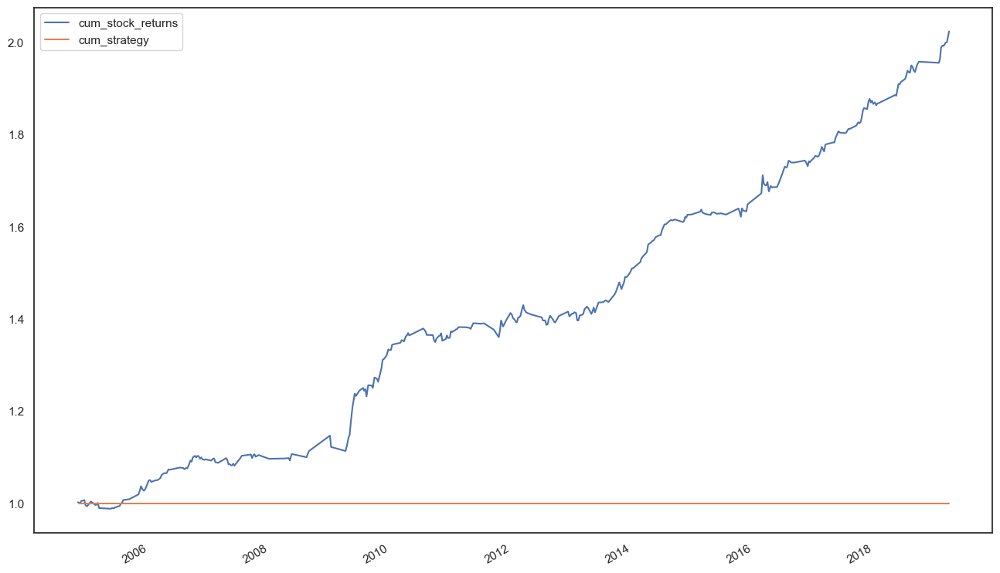

In [330]:
y_svr_growth['stock_return'] = np.log(SPY["Close"]/SPY["Close"].shift(1))

y_svr_growth['cum_stock_returns'] = y_svr_growth['stock_return'].cumsum().apply(np.exp)

y_svr_growth['strategy'] = y_svr_growth['stock_return'] * y_svr_growth['signal_pred'].shift(1)

y_svr_growth['cum_strategy'] = y_svr_growth['strategy'].cumsum().apply(np.exp)

y_svr_growth['signal']=np.where(y_svr_growth['stock_return'] > 0, 1, -1)

y_svr_growth[['cum_stock_returns','cum_strategy']].plot(figsize=(16,10))

### Total Asset

In [333]:
cap = 500000

y_svr_growth['total asset']=y_svr_growth["cum_strategy"] * cap 

y_svr_growth

,Close,predict_return,signal_pred,stock_return,cum_stock_returns,strategy,cum_strategy,signal,total asset
2004-11-01,113.510,NaN,0,0.003,1.003,NaN,NaN,1,NaN
2004-11-08,117.110,0.000,0,-0.001,1.001,-0.000,1.000,-1,500000.000
2004-11-15,118.730,0.000,0,-0.001,1.001,-0.000,1.000,-1,500000.000
2004-11-22,117.980,0.000,0,0.005,1.006,0.000,1.000,1,500000.000
2004-12-02,119.330,0.000,0,0.001,1.006,0.000,1.000,1,500000.000
...,...,...,...,...,...,...,...,...,...
2019-02-20,278.410,0.000,0,0.002,1.993,0.000,1.000,1,500000.000
2019-02-27,279.200,0.000,0,-0.000,1.993,-0.000,1.000,-1,500000.000
2019-03-12,279.490,0.000,0,0.004,2.000,0.000,1.000,1,500000.000
2019-03-19,282.400,0.000,0,0.000,2.001,0.000,1.000,1,500000.000


### Sharpe Ratio

In [334]:
if y_svr_growth['strategy'].std()*np.sqrt(252)==0:
    print("error")
    
else:
    sharpe_ratio = (y_svr_growth['strategy'].mean()/y_svr_growth['strategy'].std())*np.sqrt(252)
    print(sharpe_ratio)

error


### CAGR

In [335]:
D = (y_svr_growth.index[-1] - SPY.index[0]).days

CAGR = (((y_svr_growth["cum_strategy"][-1]) / (y_svr_growth["cum_strategy"][1])) ** (365.0/D)) - 1

CAGR

0.0

### Returns Statistics

In [336]:
total_asset = 500000.0 * y_svr_growth['cum_strategy'][-1]
    
svr_table = pd.DataFrame({'Sharpe Ratio': "0", 
                        'CAGR': CAGR,
                        'Max Drawdown': max_drawdown,
                        'Total Asset': total_asset,
                        'Strategy Return': y_svr_growth['cum_strategy'][-1]
    },columns=['Sharpe Ratio','CAGR','Max Drawdown','Total Asset','Strategy Return'],index=[0])
    
svr_table

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,0,0.000,-0.000,500000.000,1.000


### `CART - Decision Tree Regressor` Backtesting In Sample

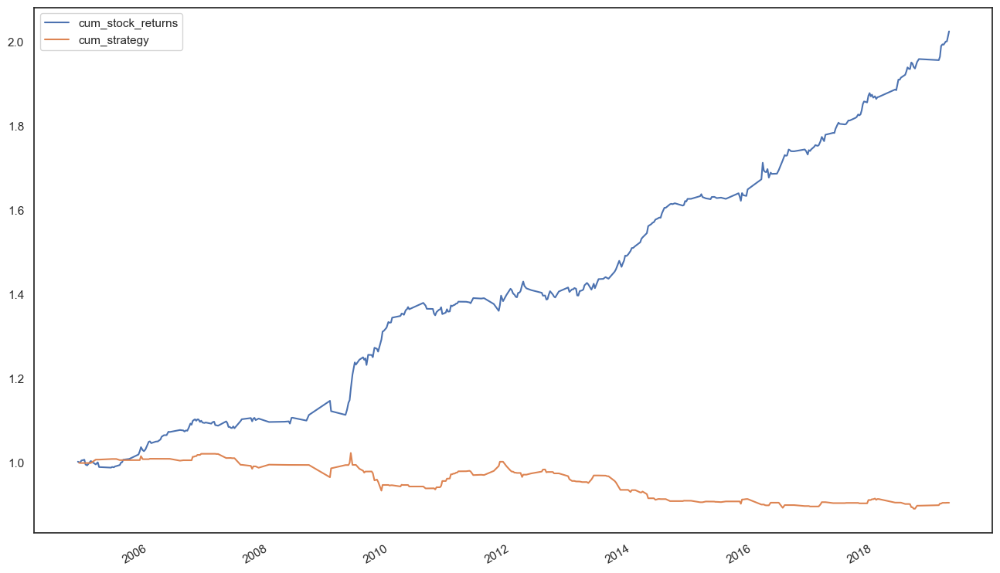

In [337]:
CART_statistics,CART_table = backtest(cart,DecisionTreeRegressor,y_cart_growth)

In [338]:
CART_statistics

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,-0.924,-0.006,0.129,452615.787,0.905


In [339]:
CART_table

,Close,predict_returns,signal_pred,stock_return,cum_stock_returns,strategy,cum_strategy,signal,total asset,cum_max
2004-11-01,113.510,NaN,0,0.003,1.003,NaN,NaN,1,NaN,NaN
2004-11-08,117.110,0.017,1,-0.001,1.001,-0.000,1.000,-1,500000.000,1.000
2004-11-15,118.730,-0.006,0,-0.001,1.001,-0.001,0.999,-1,499747.464,1.000
2004-11-22,117.980,-0.001,0,0.005,1.006,0.000,0.999,1,499747.464,1.000
2004-12-02,119.330,-0.001,0,0.001,1.006,0.000,0.999,1,499747.464,1.000
...,...,...,...,...,...,...,...,...,...,...
2019-02-20,278.410,0.003,0,0.002,1.993,0.002,0.905,1,452503.583,1.023
2019-02-27,279.200,-0.007,0,-0.000,1.993,-0.000,0.905,-1,452503.583,1.023
2019-03-12,279.490,0.015,1,0.004,2.000,0.000,0.905,1,452503.583,1.023
2019-03-19,282.400,-0.005,0,0.000,2.001,0.000,0.905,1,452615.787,1.023


### `"ETR", ExtraTreesRegressor` Backtesting In Sample

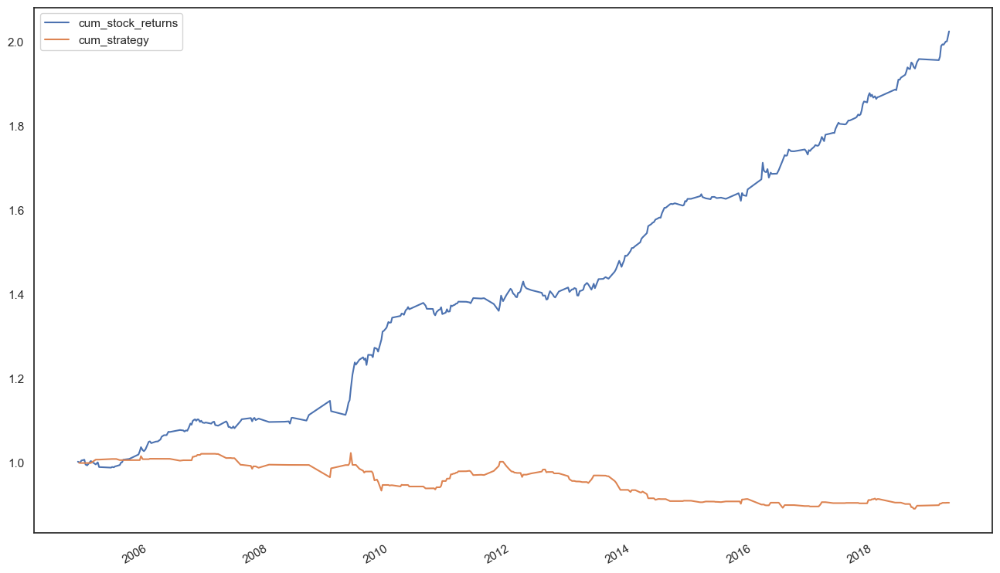

In [340]:
ETR_statistics,ETR_table = backtest(etr,ExtraTreesRegressor,y_etr_growth)

In [341]:
ETR_statistics

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,-0.924,-0.006,0.129,452615.787,0.905


In [342]:
ETR_table

,Close,predict_returns,signal_pred,stock_return,cum_stock_returns,strategy,cum_strategy,signal,total asset,cum_max
2004-11-01,113.510,NaN,0,0.003,1.003,NaN,NaN,1,NaN,NaN
2004-11-08,117.110,0.017,1,-0.001,1.001,-0.000,1.000,-1,500000.000,1.000
2004-11-15,118.730,-0.006,0,-0.001,1.001,-0.001,0.999,-1,499747.464,1.000
2004-11-22,117.980,-0.001,0,0.005,1.006,0.000,0.999,1,499747.464,1.000
2004-12-02,119.330,-0.001,0,0.001,1.006,0.000,0.999,1,499747.464,1.000
...,...,...,...,...,...,...,...,...,...,...
2019-02-20,278.410,0.003,0,0.002,1.993,0.002,0.905,1,452503.583,1.023
2019-02-27,279.200,-0.007,0,-0.000,1.993,-0.000,0.905,-1,452503.583,1.023
2019-03-12,279.490,0.015,1,0.004,2.000,0.000,0.905,1,452503.583,1.023
2019-03-19,282.400,-0.005,0,0.000,2.001,0.000,0.905,1,452615.787,1.023


### `"RFR", RandomForestRegressor` Backtesting In Sample

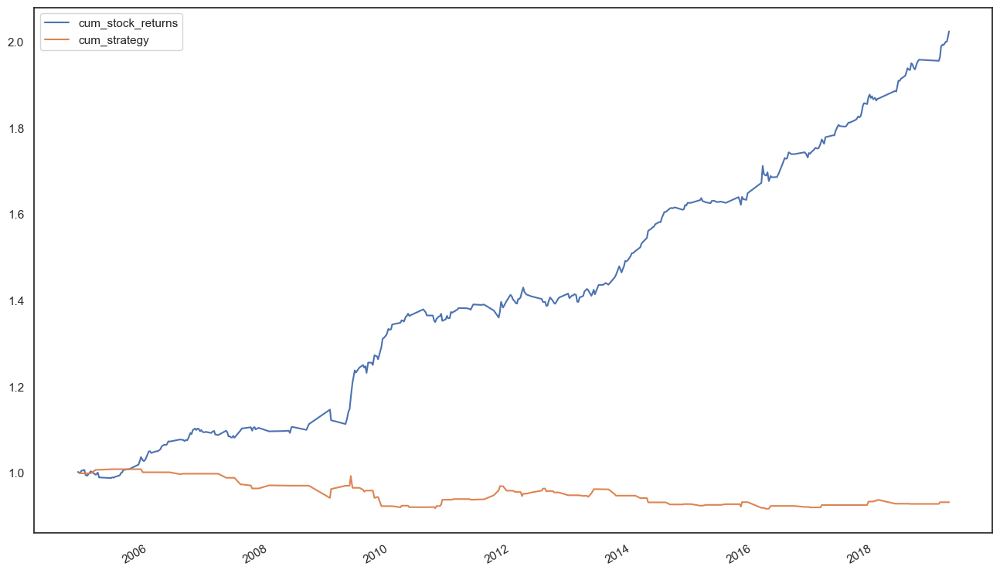

In [343]:
RFR_statistics,RFR_table = backtest(rfr,RandomForestRegressor,y_rfr_growth)

In [344]:
RFR_statistics

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,-0.736,-0.005,0.091,466246.431,0.932


In [345]:
RFR_table

,Close,predict_returns,signal_pred,stock_return,cum_stock_returns,strategy,cum_strategy,signal,total asset,cum_max
2004-11-01,113.510,NaN,0,0.003,1.003,NaN,NaN,1,NaN,NaN
2004-11-08,117.110,0.011,1,-0.001,1.001,-0.000,1.000,-1,500000.000,1.000
2004-11-15,118.730,-0.002,0,-0.001,1.001,-0.001,0.999,-1,499747.464,1.000
2004-11-22,117.980,0.000,0,0.005,1.006,0.000,0.999,1,499747.464,1.000
2004-12-02,119.330,-0.000,0,0.001,1.006,0.000,0.999,1,499747.464,1.000
...,...,...,...,...,...,...,...,...,...,...
2019-02-20,278.410,0.003,0,0.002,1.993,0.000,0.932,1,466246.431,1.009
2019-02-27,279.200,0.001,0,-0.000,1.993,-0.000,0.932,-1,466246.431,1.009
2019-03-12,279.490,0.010,0,0.004,2.000,0.000,0.932,1,466246.431,1.009
2019-03-19,282.400,-0.002,0,0.000,2.001,0.000,0.932,1,466246.431,1.009


### `"GBR", GradientBoostingRegressor` Backtesting In Sample

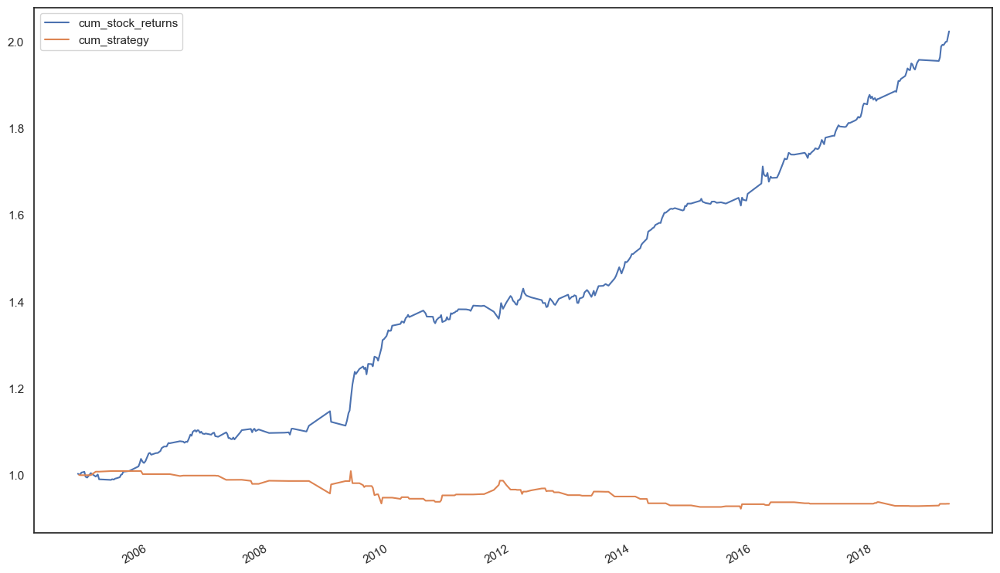

In [346]:
GBR_statistics,GBR_table = backtest(gbr,GradientBoostingRegressor,y_gbr_growth)

In [347]:
GBR_statistics

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,-0.747,-0.004,0.086,466744.886,0.933


In [348]:
GBR_table

,Close,predict_returns,signal_pred,stock_return,cum_stock_returns,strategy,cum_strategy,signal,total asset,cum_max
2004-11-01,113.510,NaN,0,0.003,1.003,NaN,NaN,1,NaN,NaN
2004-11-08,117.110,0.013,1,-0.001,1.001,-0.000,1.000,-1,500000.000,1.000
2004-11-15,118.730,0.000,0,-0.001,1.001,-0.001,0.999,-1,499747.464,1.000
2004-11-22,117.980,0.000,0,0.005,1.006,0.000,0.999,1,499747.464,1.000
2004-12-02,119.330,-0.000,0,0.001,1.006,0.000,0.999,1,499747.464,1.000
...,...,...,...,...,...,...,...,...,...,...
2019-02-20,278.410,0.001,0,0.002,1.993,0.000,0.933,1,466629.179,1.009
2019-02-27,279.200,0.002,0,-0.000,1.993,-0.000,0.933,-1,466629.179,1.009
2019-03-12,279.490,0.011,1,0.004,2.000,0.000,0.933,1,466629.179,1.009
2019-03-19,282.400,-0.004,0,0.000,2.001,0.000,0.933,1,466744.886,1.009


### `"ABR", AdaBoostRegressor` Backtesting In Sample

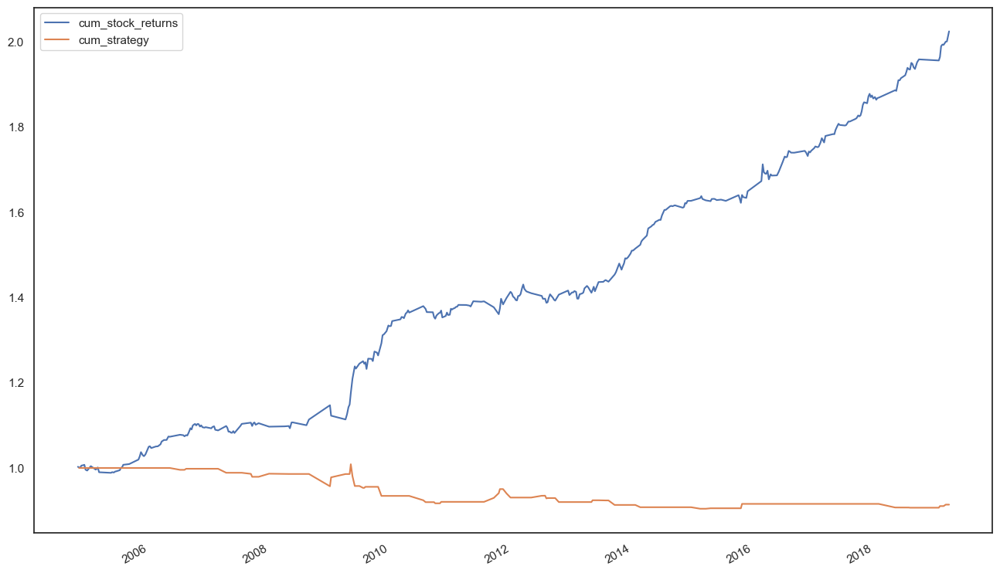

In [349]:
ABR_statistics,ABR_table = backtest(abr,AdaBoostRegressor,y_abr_growth)

In [350]:
ABR_statistics

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
0,-1.025,-0.006,0.103,457006.288,0.914


In [351]:
ABR_table

,Close,predict_returns,signal_pred,stock_return,cum_stock_returns,strategy,cum_strategy,signal,total asset,cum_max
2004-11-01,113.510,NaN,0,0.003,1.003,NaN,NaN,1,NaN,NaN
2004-11-08,117.110,0.000,0,-0.001,1.001,-0.000,1.000,-1,500000.000,1.000
2004-11-15,118.730,0.007,0,-0.001,1.001,-0.000,1.000,-1,500000.000,1.000
2004-11-22,117.980,0.000,0,0.005,1.006,0.000,1.000,1,500000.000,1.000
2004-12-02,119.330,-0.002,0,0.001,1.006,0.000,1.000,1,500000.000,1.000
...,...,...,...,...,...,...,...,...,...,...
2019-02-20,278.410,-0.001,0,0.002,1.993,0.000,0.911,1,455289.408,1.009
2019-02-27,279.200,0.011,1,-0.000,1.993,-0.000,0.911,-1,455289.408,1.009
2019-03-12,279.490,0.005,0,0.004,2.000,0.004,0.914,1,457006.288,1.009
2019-03-19,282.400,-0.001,0,0.000,2.001,0.000,0.914,1,457006.288,1.009


In [352]:
reg_table = pd.concat([lasso_table, en_table, lr_table, knn_table, svr_table, CART_statistics, ETR_statistics, RFR_statistics, GBR_statistics, ABR_statistics], join='inner')

In [353]:
reg_table.index=['Lasso','EN','LR','KNN','SVR','CART','ETR','RFR','GBR','ABR']


In [354]:
reg_table

,Sharpe Ratio,CAGR,Max Drawdown,Total Asset,Strategy Return
Lasso,NA,0.000,-0.000,500000.000,1.000
EN,0,0.000,-0.000,500000.000,1.000
LR,0.561,0.002,0.039,519130.306,1.038
KNN,0.002,0.000,0.038,519130.306,1.038
SVR,0,0.000,-0.000,500000.000,1.000
CART,-0.924,-0.006,0.129,452615.787,0.905
ETR,-0.924,-0.006,0.129,452615.787,0.905
RFR,-0.736,-0.005,0.091,466246.431,0.932
GBR,-0.747,-0.004,0.086,466744.886,0.933
ABR,-1.025,-0.006,0.103,457006.288,0.914


Based on the data all regressor models are not ale to beat the market. Linear Regression shown the highest Sharpe of 0.561, a CAGR of 0.002, max drawdown of 3.9% and total outstanding amount of $519,130.306 total accumulative returns of 38%.

In conclusion, based on the regressor models being trained and backtested, our models does not perform optimistic performance result. This could be due to insufficient input features, lack of highly correlated assets or small dataset used. Future research with news data, larger dataset and more technical indicators can be used to experiment to optimise the predicted model. Hyperparameter tuning may be used to improve the prediction. 

It is important for Quants in the field to constanly update machine learning algorithm regularly so that there will not be a widening convergence gap.

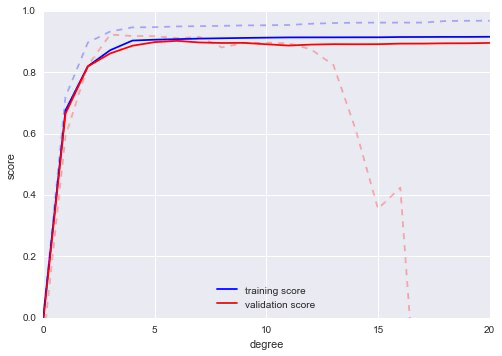

Fig 1 : Validation Curve

(Jake VanderPlas(2017).Python Data Science Handbook. Retrieved from https://jakevdp.github.io/PythonDataScienceHandbook/05.03-hyperparameters-and-model-validation.html)